In [1]:
# Import libraries
import os
from PIL import Image
import cv2 as cv
import cv2
import math
import numpy as np  
import matplotlib.pyplot as plt

In [2]:
# Set the paths to the positive images and groundtruth folders
positive_images_path = '../dataset/positive_images'
groundtruth_path = '../dataset/groundtruth'

# Get a list of all the tif images in the positive images folder
tif_images = [f for f in os.listdir(positive_images_path) if f.endswith('.tif')]
tif_images

['20586908_6c613a14b80a8591_MG_R_CC_ANON.tif',
 '20586934_6c613a14b80a8591_MG_L_CC_ANON.tif',
 '20586960_6c613a14b80a8591_MG_R_ML_ANON.tif',
 '20586986_6c613a14b80a8591_MG_L_ML_ANON.tif',
 '20587612_f4b2d377f43ba0bd_MG_R_CC_ANON.tif',
 '20587664_f4b2d377f43ba0bd_MG_R_ML_ANON.tif',
 '20587758_81cd83d2f4d78528_MG_L_CC_ANON.tif',
 '20587810_81cd83d2f4d78528_MG_L_ML_ANON.tif',
 '20587902_8dbbd4e51f549ff0_MG_R_CC_ANON.tif',
 '20587928_8dbbd4e51f549ff0_MG_R_ML_ANON.tif',
 '20587994_024ee3569b2605dc_MG_R_CC_ANON.tif',
 '20588046_024ee3569b2605dc_MG_R_ML_ANON.tif',
 '20588190_8d0b9620c53c0268_MG_L_CC_ANON.tif',
 '20588216_8d0b9620c53c0268_MG_L_ML_ANON.tif',
 '20588308_493155e17143edef_MG_L_ML_ANON.tif',
 '20588334_493155e17143edef_MG_L_CC_ANON.tif',
 '20588536_bf1a6aaadb05e3df_MG_L_ML_ANON.tif',
 '20588562_bf1a6aaadb05e3df_MG_L_CC_ANON.tif',
 '20588680_036aff49b8ac84f0_MG_L_ML_ANON.tif',
 '22427705_d713ef5849f98b6c_MG_L_CC_ANON.tif',
 '22427751_d713ef5849f98b6c_MG_L_ML_ANON.tif',
 '22427840_bb

In [3]:
# Otsu thresholding function
def Otsu_thresholding(img):
    # Gaussian Filtering
    blur = cv.GaussianBlur(img, (5,5), 0)
    _, breast_mask = cv.threshold(blur, 0, 255, cv.THRESH_BINARY + cv.THRESH_OTSU)
    cnts, _ = cv.findContours(breast_mask.astype(np.uint8), cv.RETR_EXTERNAL, cv.CHAIN_APPROX_SIMPLE)
    cnt = max(cnts, key = cv.contourArea)
    x, y, w, h = cv.boundingRect(cnt)
    return x, y, w, h

In [4]:
# Contrast-Limited Adaptive Histogram Equalization (CLAHE) Function
def clahe(image,clip=0.9,tile=1):
    clahe = cv.createCLAHE(clipLimit=clip, tileGridSize=(tile,tile))                                             
    return clahe.apply(image)

In [5]:
# Generate Morphological Kernels for Sifting
def generate_rotated_kernel(D, delta_theta):
    kernel = np.zeros((D,D),dtype=int)
    for j in range(0,(D)):                                                               # Generate Kernel
        kernel[int(D/2)][j] = 1
    rows,cols      = kernel.shape
    rotmat         = cv2.getRotationMatrix2D((int(D/2),int(D/2)), delta_theta, 1.0);     # Generate Rotation Matrix
    rotated_kernel = cv2.warpAffine(np.uint8(kernel), rotmat, (cols,rows));              # Rotate Kernel Around its Center
    rotated_kernel = np.delete(rotated_kernel,np.argwhere(np.all(rotated_kernel[..., :] == 0, axis=0)), axis=1)
    rotated_kernel = np.delete(rotated_kernel,np.where(~rotated_kernel.any(axis=1))[0], axis=0)
    return rotated_kernel

# Multi-Scale Morphological Sifting
def multi_scale_morphological_sifters(input_img ,M, N, Areamin, Areamax, PixelSize):
    SI = np.zeros((M+1), dtype=float) # Scale Interval
    D1 = np.zeros((M), dtype=int)     # Outer Diameter
    D2 = np.zeros((M), dtype=int)     # Inner Diameter

    # Calculate Minimum/Maximum Diameter
    DImin = 2 * math.sqrt(Areamin/math.pi)/(PixelSize*4)  
    DImax = 2 * math.sqrt(Areamax/math.pi)/(PixelSize*4)
    
    SI[0] = 1.   # Minimum Dimention in First Iteration
    
    # Calculate Diameters D1,D2
    for i in range(1,M+1):
        SI[i] = ((DImax/DImin)**(1/M))**(i)
    for i in range(0,M):
        D1[i] = np.round(DImin * SI[i])
        if ((D1[i]%2) == 0):  # Ensure Odd-Numbered Diameter to use as Kernel Filter
            D1[i]+=1;
        D2[i] = np.round(DImin * SI[i+1])
        if ((D2[i]%2) == 0):  # Ensure Odd-Numbered Diameter to use as Kernel Filter
            D2[i]+=1;
    
    # Placeholder for Summing Image    
    sum_all_images = np.zeros((M,input_img.shape[0],input_img.shape[1]), dtype=int)
    for i in range(0,M):
        for delta_theta in range(0,180,int(180/N)):
            
            # Apply Top-Hat Transform using Outer Diameter Line
            rotated_kernel = generate_rotated_kernel(D2[i], delta_theta)
            dst1           = cv2.morphologyEx(input_img, cv2.MORPH_TOPHAT, rotated_kernel)
    
            # Apply Morphological Opening using Inner Diameter Line
            rotated_kernel = generate_rotated_kernel(D1[i], delta_theta)
            dst2           = cv2.morphologyEx(dst1, cv2.MORPH_OPEN, rotated_kernel)
            
            sum_all_images[i,:,:] = sum_all_images[i,:,:] + dst2;
        sum_all_images[i,:,:] = (sum_all_images[i,:,:]/np.max(sum_all_images[i,:,:]))*(2**16-1) # Normalize Output Image
    return sum_all_images

In [6]:
def mean_shift_filter(image, spatial_radius=45, color_radius=60):
    # Normalize the image to the range [0, 255]
    normalized_image = cv2.normalize(image, None, 0, 255, cv2.NORM_MINMAX, dtype=cv2.CV_8U)
    
    # Convert the image to BGR color space
    bgr_image = cv2.cvtColor(normalized_image, cv2.COLOR_GRAY2BGR)
    
    # Apply mean shift filtering
    filtered_image = cv2.pyrMeanShiftFiltering(bgr_image, spatial_radius, color_radius)
    
    # Convert the filtered image to grayscale
    grayscale_image = cv2.cvtColor(filtered_image, cv2.COLOR_BGR2GRAY)
    
    return grayscale_image

In [7]:
def eliminate(image):
    
    # Normalize the filtered image to improve contrast
    normalized_image = cv2.normalize(image, None, alpha=0, beta=255, norm_type=cv2.NORM_MINMAX, dtype=cv2.CV_8U)
    
    # Perform adaptive thresholding on the normalized image
    thresh = cv2.adaptiveThreshold(normalized_image, 255, cv2.ADAPTIVE_THRESH_MEAN_C, cv2.THRESH_BINARY_INV, 9, 2)

    # Perform morphological operations
    kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (3, 3))
    closed = cv2.morphologyEx(thresh, cv2.MORPH_CLOSE, kernel)
    
    # Perform morphological opening to eliminate remaining small objects
    kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (3, 3))
    opened = cv2.morphologyEx(closed, cv2.MORPH_OPEN, kernel)
    
    # Find contours of thresholded image
    contours, _ = cv2.findContours(opened, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    
    # Create a blank image to draw contours on
    result = np.zeros_like(opened)
    
    min_area = 800
    max_area = 751132

    # Loop through contours and eliminate those outside the desired area range
    for cnt in contours:
        area = cv2.contourArea(cnt)
        if area > min_area and area < max_area:
            cv2.drawContours(result, [cnt], 0, (255, 255, 255), -1)

    return result

In [8]:
def calculate_dice_score(ground_truth_path, segmented_image):

    # Threshold the images to create binary masks
    gt_mask = np.where(ground_truth_path > 0, 1, 0)
    seg_mask = np.where(segmented_image > 0, 1, 0)

    # Calculate the intersection and union of the masks
    intersection = np.logical_and(gt_mask, seg_mask).sum()
    union = gt_mask.sum() + seg_mask.sum()

    # Calculate the Dice score
    dice_score = 2 * intersection / union

    return dice_score

In [9]:
def calculate_sensitivity(ground_truth_path, segmented_image):

    # Threshold the images to create binary masks
    gt_mask = np.where(ground_truth_path > 0, 1, 0)
    seg_mask = np.where(segmented_image > 0, 1, 0)

    # Calculate true positive (TP), false negative (FN)
    tp = np.logical_and(gt_mask, seg_mask).sum()
    fn = np.logical_and(gt_mask, np.logical_not(seg_mask)).sum()

    # Calculate sensitivity (recall)
    sensitivity = tp / (tp + fn)

    return sensitivity

h: (864, 488) uint16
h: (864, 488) uint8
20586908_6c613a14b80a8591_MG_R_CC_ANON.tif
(4, 864, 488) int32
ms: (864, 488) uint8
(864, 488) uint8


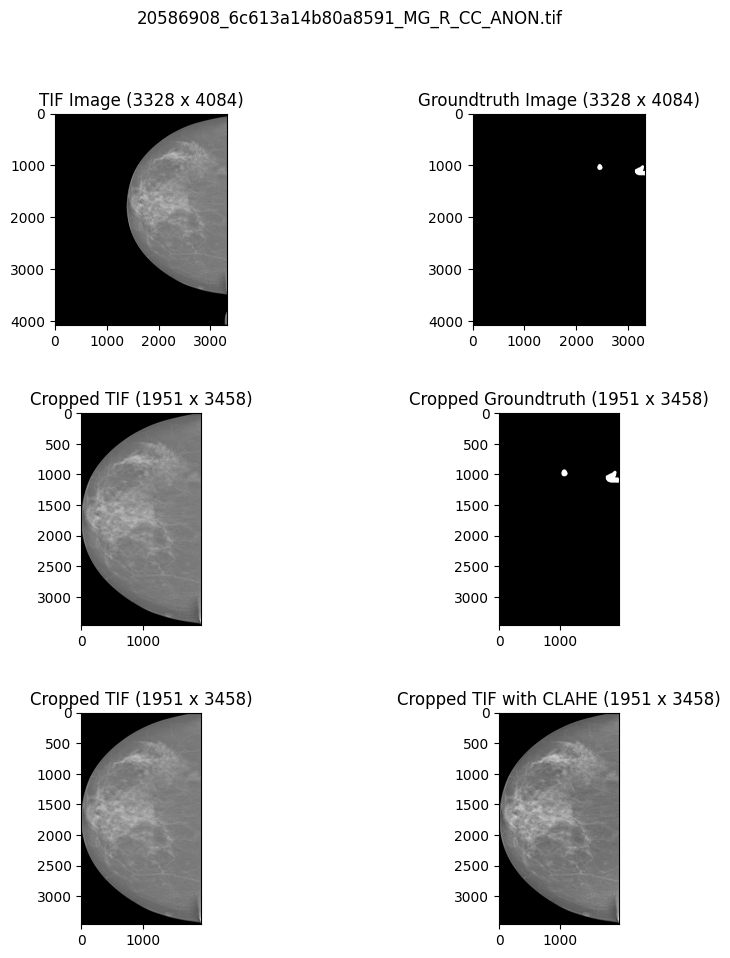

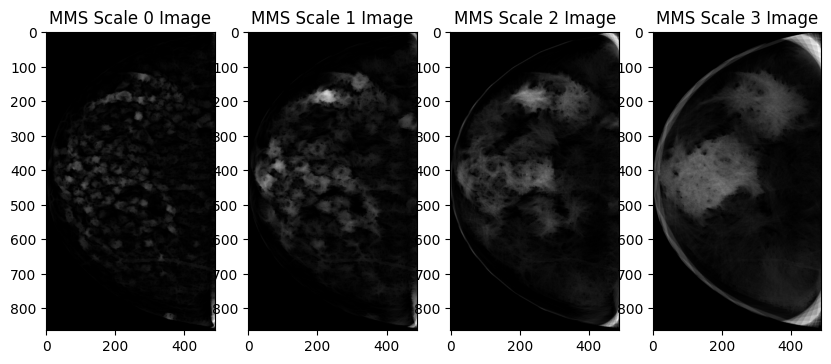

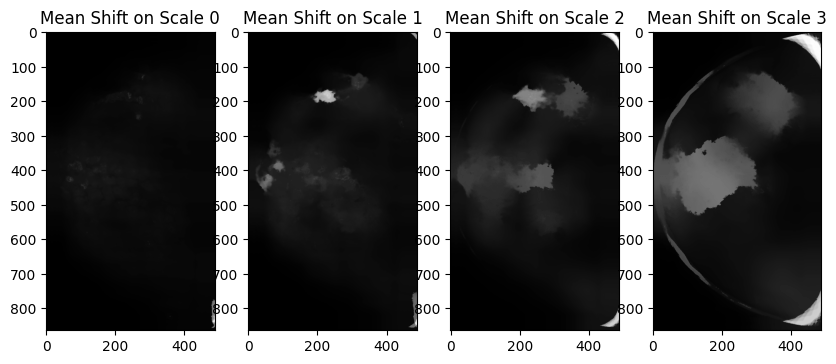

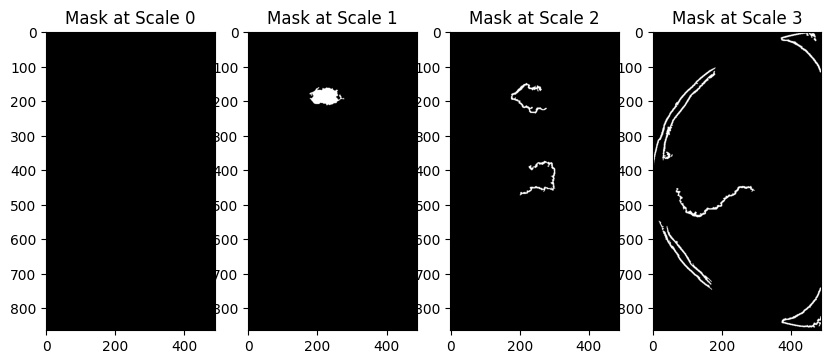

The Dice score on scale 0 0.0
The Dice score on scale 1 0.0
The Dice score on scale 2 0.0
The Dice score on scale 3 0.0
The sensitivity on scale 0 0.0
The sensitivity on scale 1 0.0
The sensitivity on scale 2 0.0
The sensitivity on scale 3 0.0
h: (832, 413) uint16
h: (832, 413) uint8
20586934_6c613a14b80a8591_MG_L_CC_ANON.tif
(4, 832, 413) int32
ms: (832, 413) uint8
(832, 413) uint8


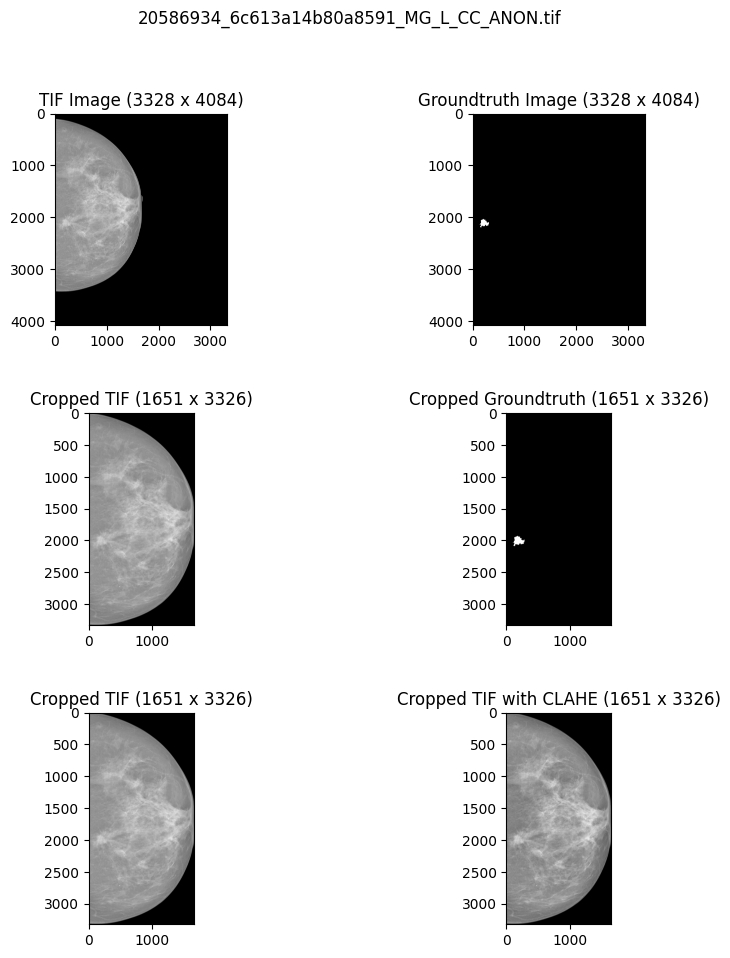

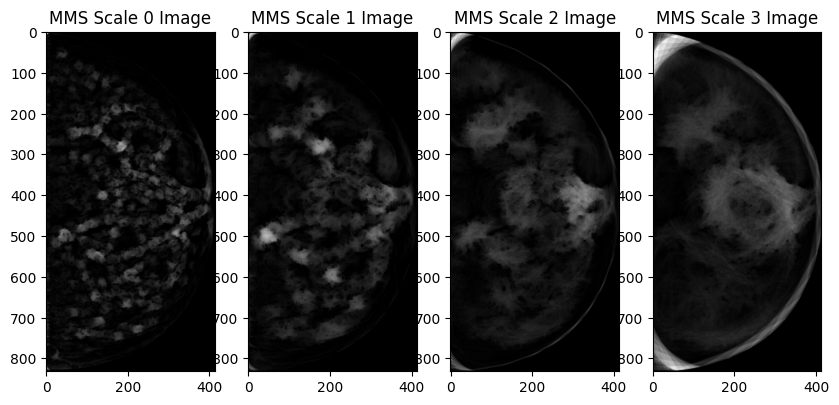

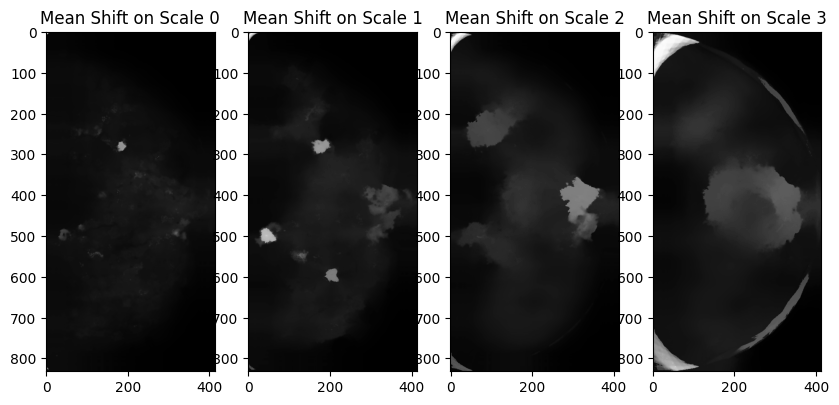

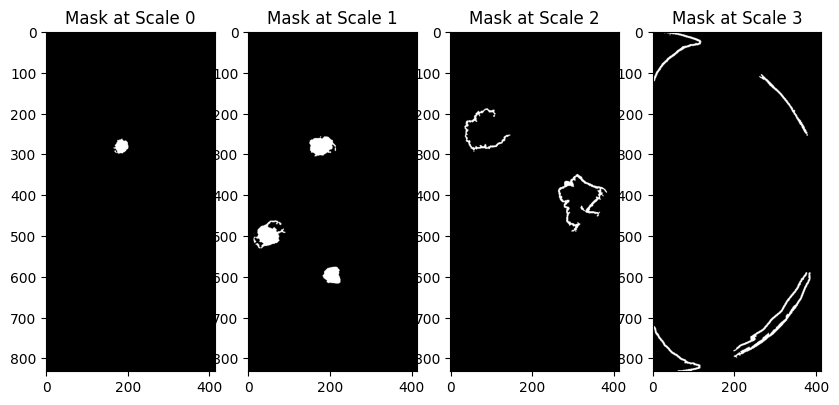

The Dice score on scale 0 0.0
The Dice score on scale 1 0.29134967596506056
The Dice score on scale 2 0.0
The Dice score on scale 3 0.0
The sensitivity on scale 0 0.0
The sensitivity on scale 1 0.9672591206735267
The sensitivity on scale 2 0.0
The sensitivity on scale 3 0.0
h: (800, 557) uint16
h: (800, 557) uint8
20586960_6c613a14b80a8591_MG_R_ML_ANON.tif
(4, 800, 557) int32
ms: (800, 557) uint8
(800, 557) uint8


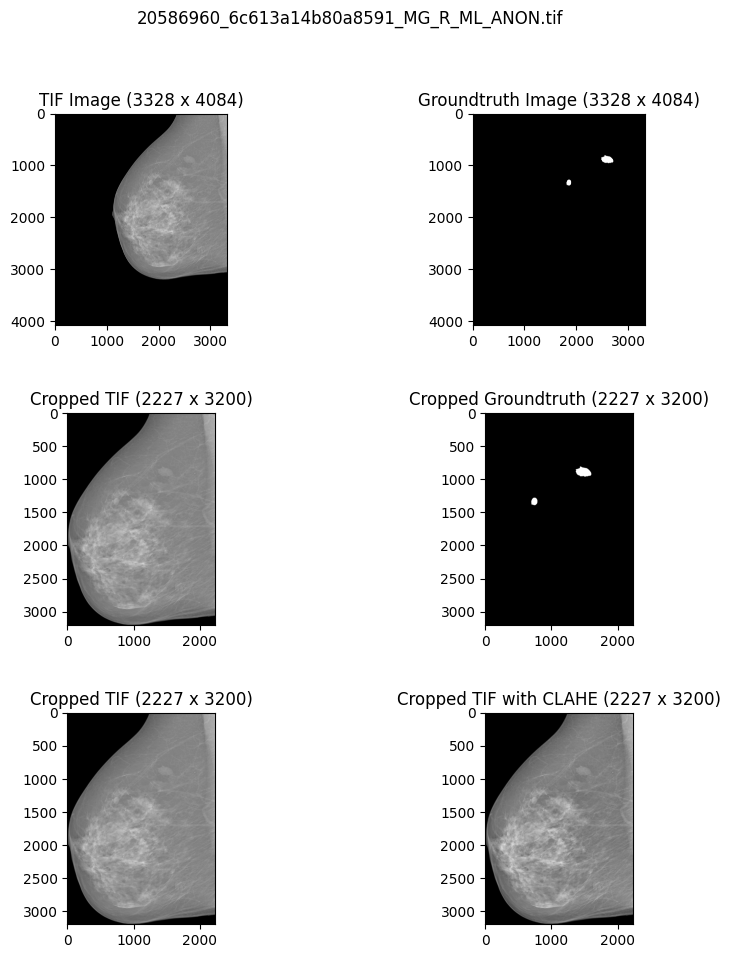

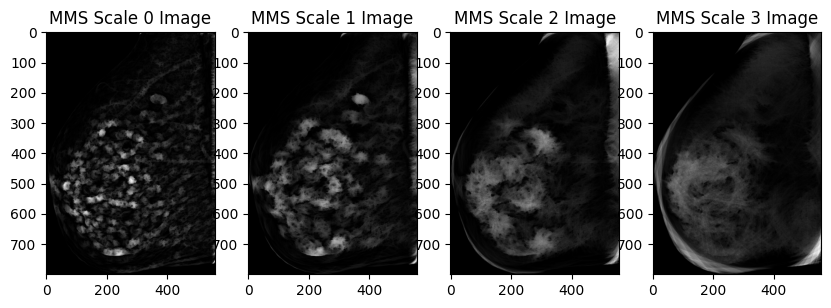

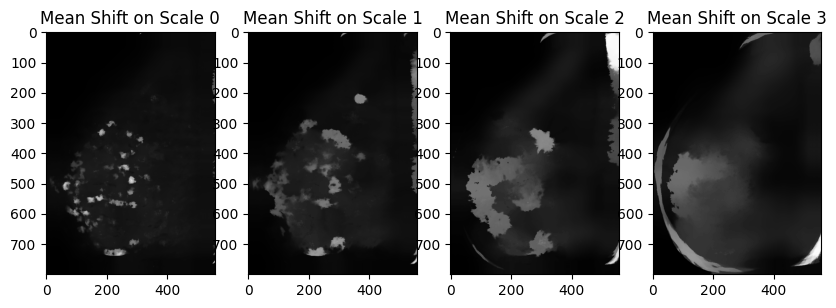

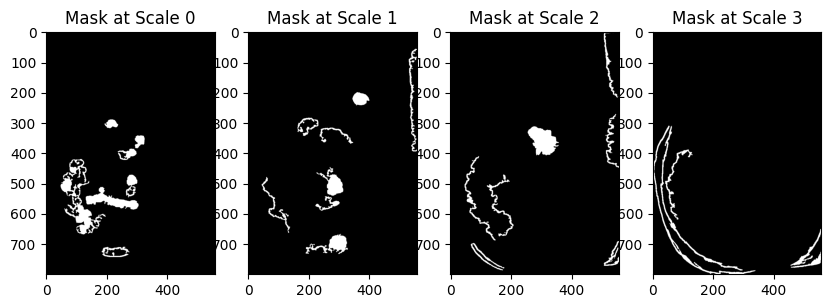

The Dice score on scale 0 0.0
The Dice score on scale 1 0.18464823555855248
The Dice score on scale 2 0.0
The Dice score on scale 3 0.0
The sensitivity on scale 0 0.0
The sensitivity on scale 1 0.7602961591855623
The sensitivity on scale 2 0.0
The sensitivity on scale 3 0.0
h: (786, 472) uint16
h: (786, 472) uint8
20586986_6c613a14b80a8591_MG_L_ML_ANON.tif
(4, 786, 472) int32
ms: (786, 472) uint8
(786, 472) uint8


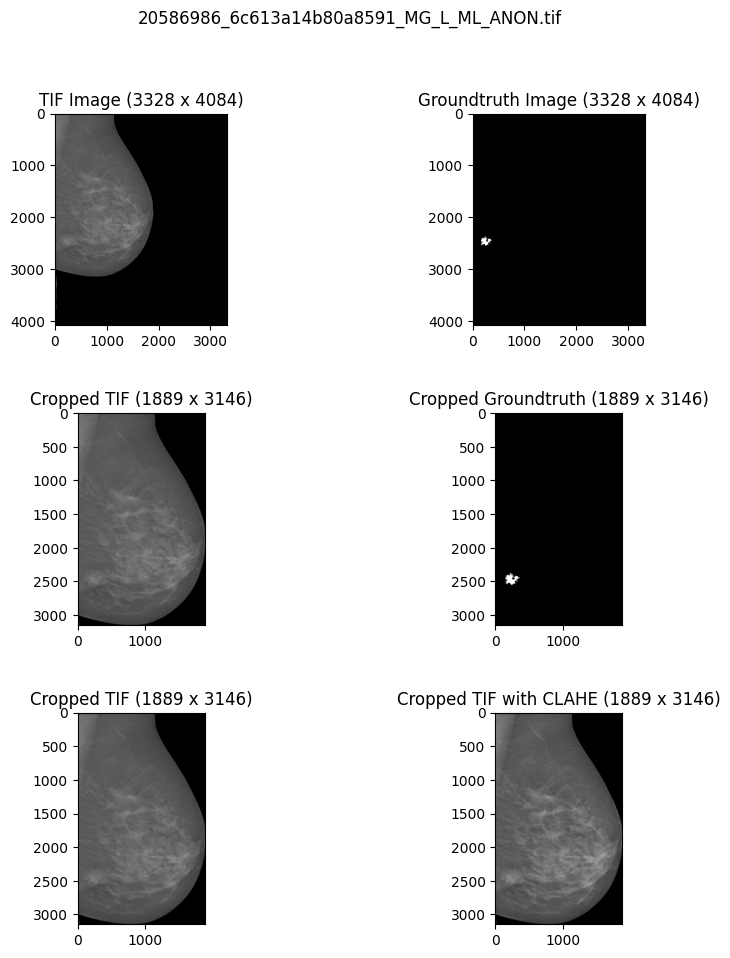

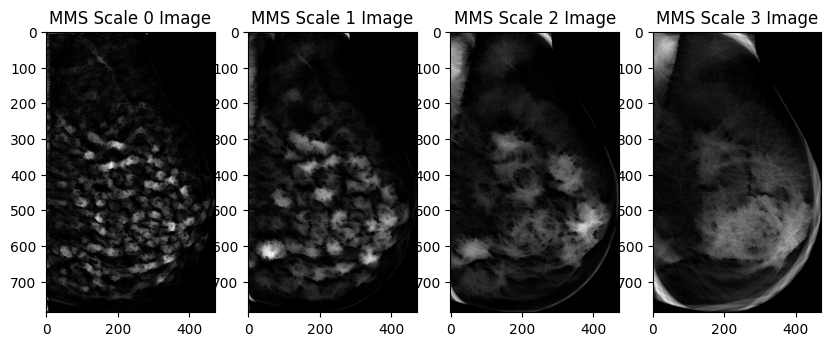

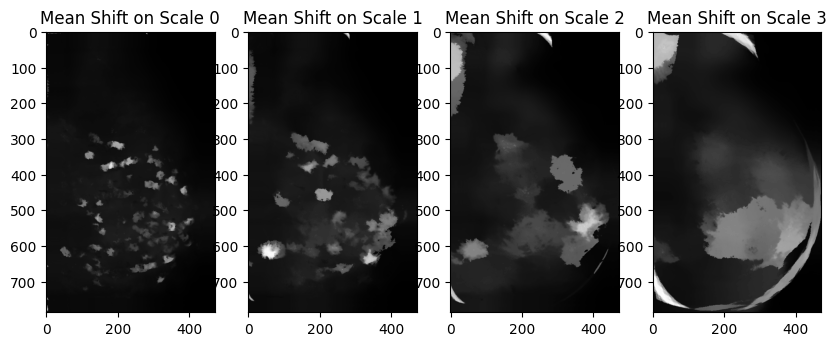

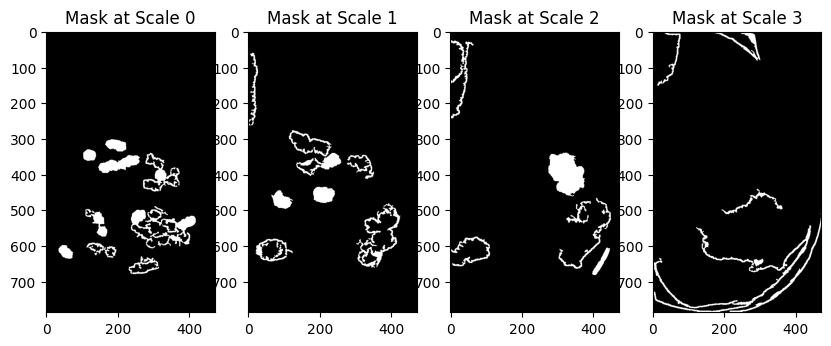

The Dice score on scale 0 0.07814418921992268
The Dice score on scale 1 0.0038644315630059012
The Dice score on scale 2 0.0001094391244870041
The Dice score on scale 3 0.0
The sensitivity on scale 0 0.6944219886822959
The sensitivity on scale 1 0.029911075181891674
The sensitivity on scale 2 0.0008084074373484236
The sensitivity on scale 3 0.0
h: (869, 480) uint16
h: (869, 480) uint8
20587612_f4b2d377f43ba0bd_MG_R_CC_ANON.tif
(4, 869, 480) int32
ms: (869, 480) uint8
(869, 480) uint8


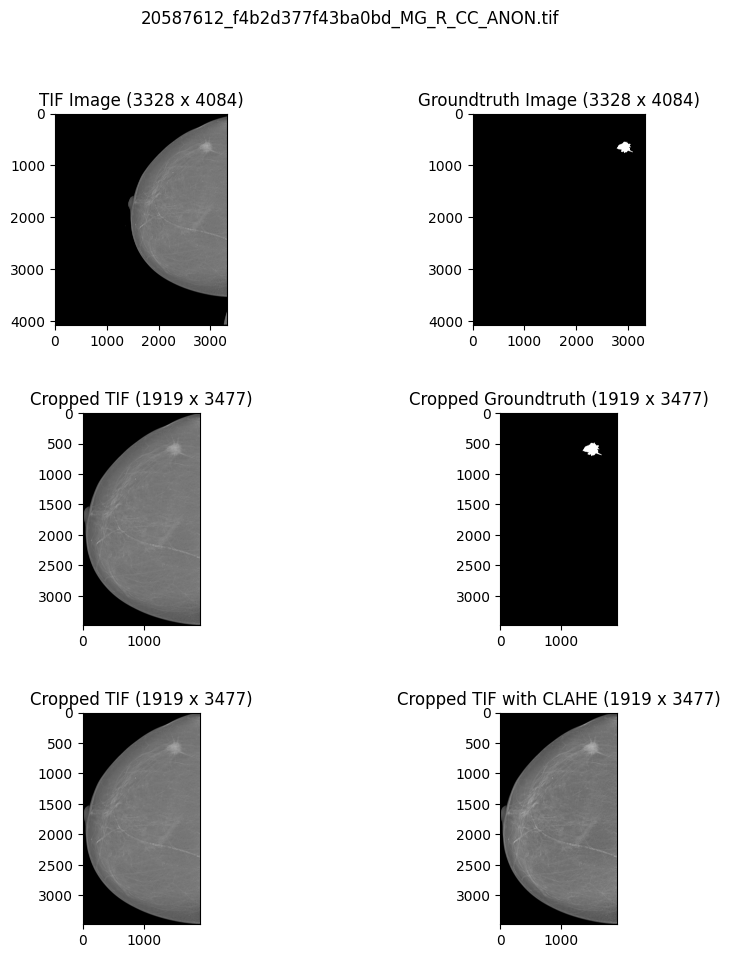

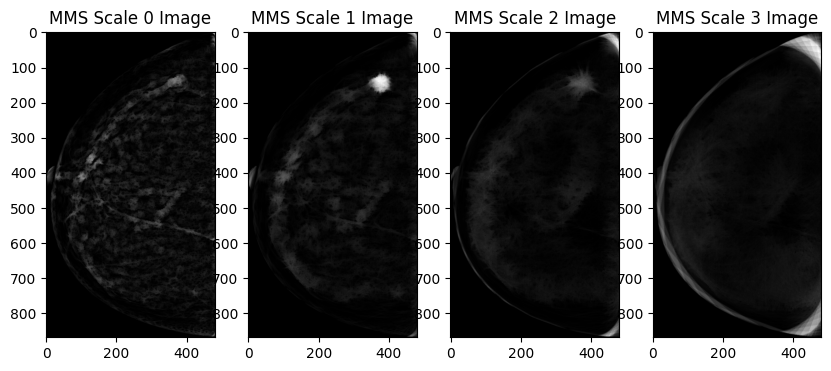

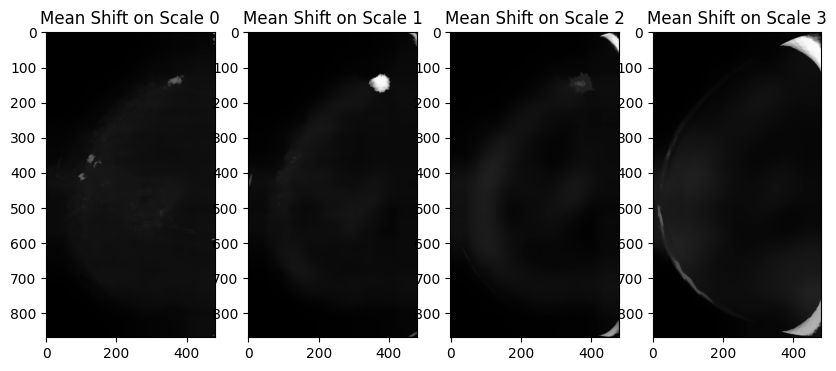

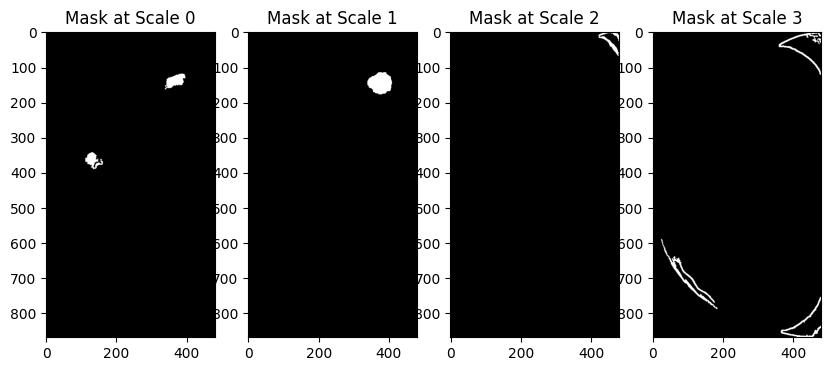

The Dice score on scale 0 0.49576020508775387
The Dice score on scale 1 0.8214665249734325
The Dice score on scale 2 0.0
The Dice score on scale 3 0.0
The sensitivity on scale 0 0.5288178376104333
The sensitivity on scale 1 0.9755994951619689
The sensitivity on scale 2 0.0
The sensitivity on scale 3 0.0
h: (820, 515) uint16
h: (820, 515) uint8
20587664_f4b2d377f43ba0bd_MG_R_ML_ANON.tif
(4, 820, 515) int32
ms: (820, 515) uint8
(820, 515) uint8


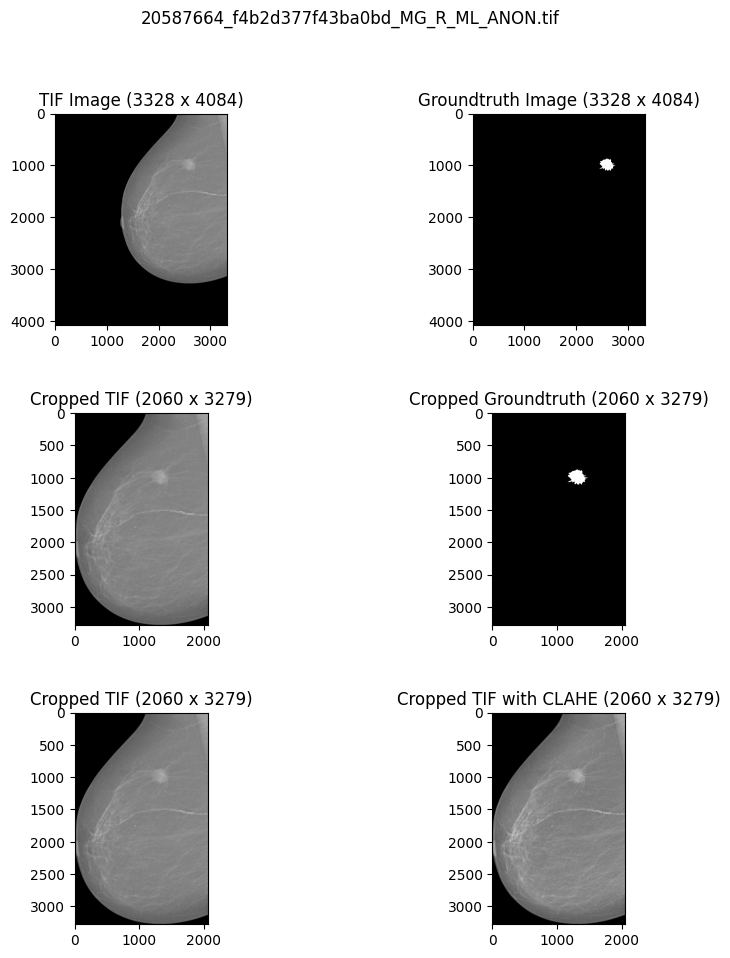

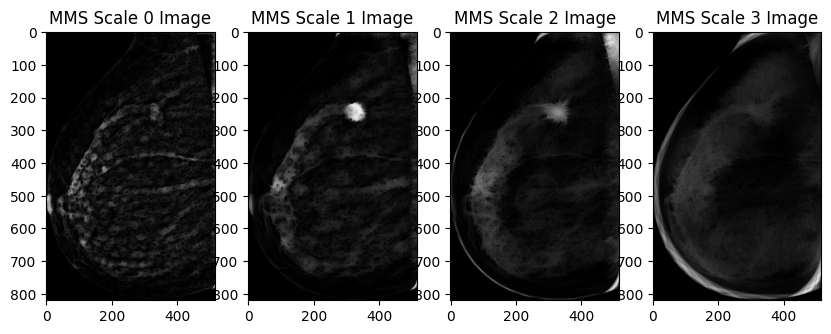

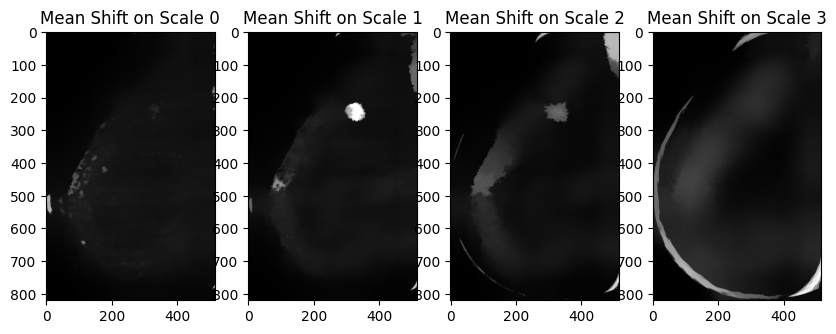

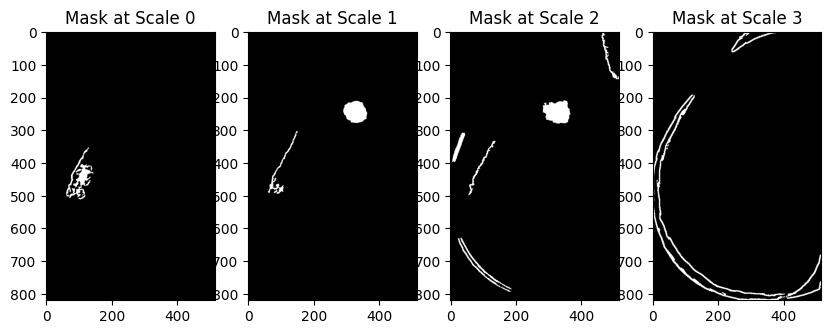

The Dice score on scale 0 0.0
The Dice score on scale 1 0.6759016598028205
The Dice score on scale 2 0.43763432301201943
The Dice score on scale 3 0.0
The sensitivity on scale 0 0.0
The sensitivity on scale 1 0.9822270583968081
The sensitivity on scale 2 0.9970982952484585
The sensitivity on scale 3 0.0
h: (757, 359) uint16
h: (757, 359) uint8
20587758_81cd83d2f4d78528_MG_L_CC_ANON.tif
(4, 757, 359) int32
ms: (757, 359) uint8
(757, 359) uint8


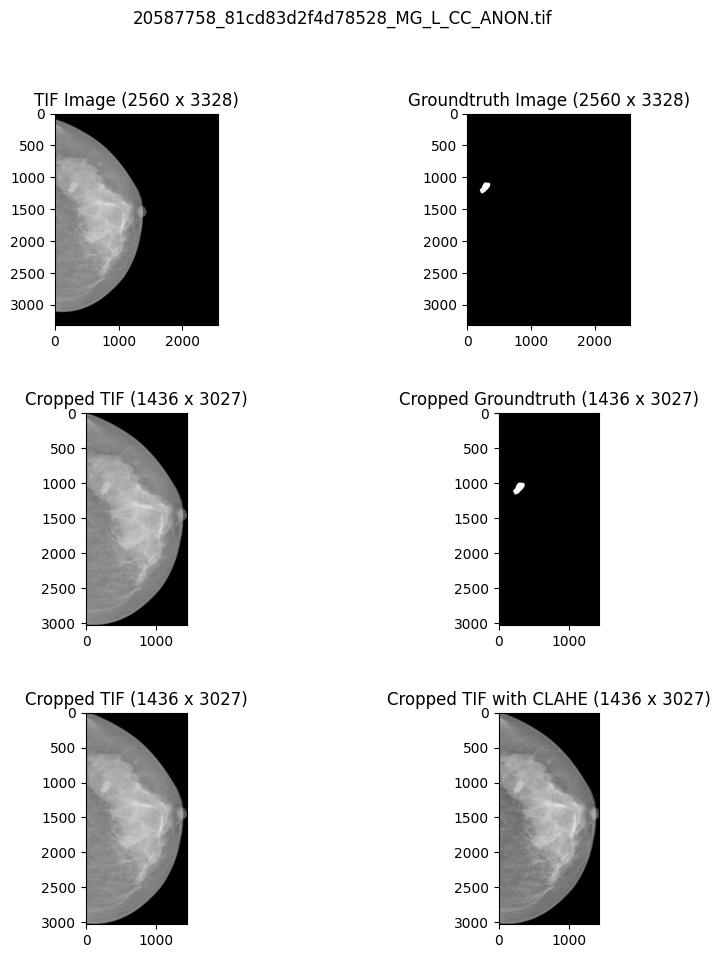

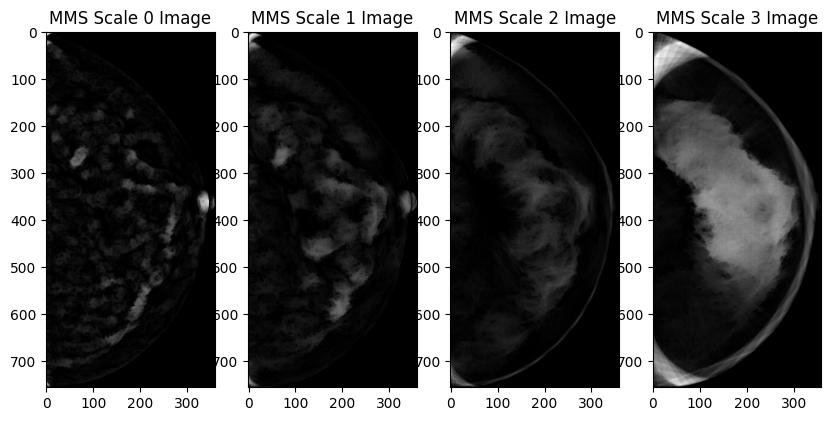

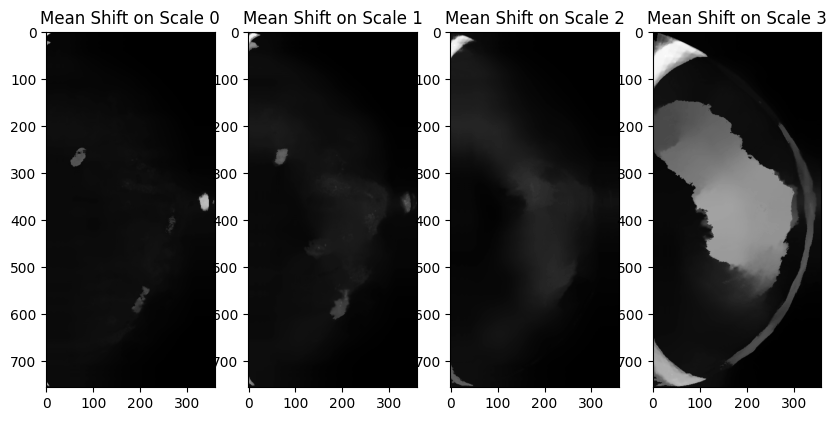

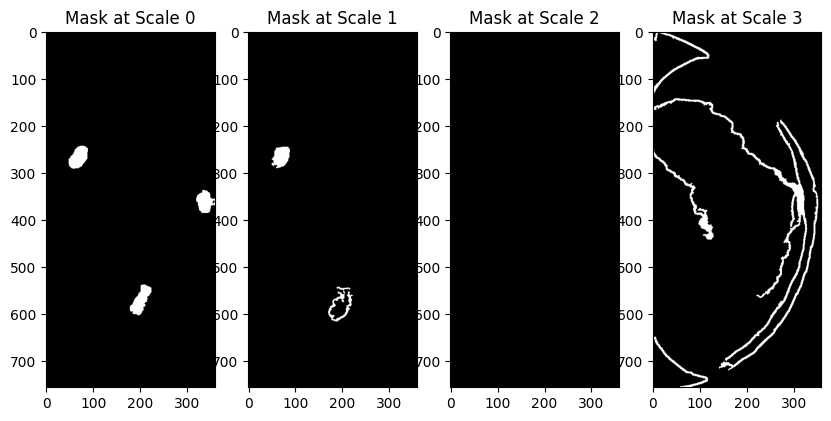

The Dice score on scale 0 0.389314403138427
The Dice score on scale 1 0.5794282346006484
The Dice score on scale 2 0.0
The Dice score on scale 3 0.0
The sensitivity on scale 0 0.9675023212627669
The sensitivity on scale 1 0.9127205199628597
The sensitivity on scale 2 0.0
The sensitivity on scale 3 0.0
h: (832, 390) uint16
h: (832, 390) uint8
20587810_81cd83d2f4d78528_MG_L_ML_ANON.tif
(4, 832, 390) int32
ms: (832, 390) uint8
(832, 390) uint8


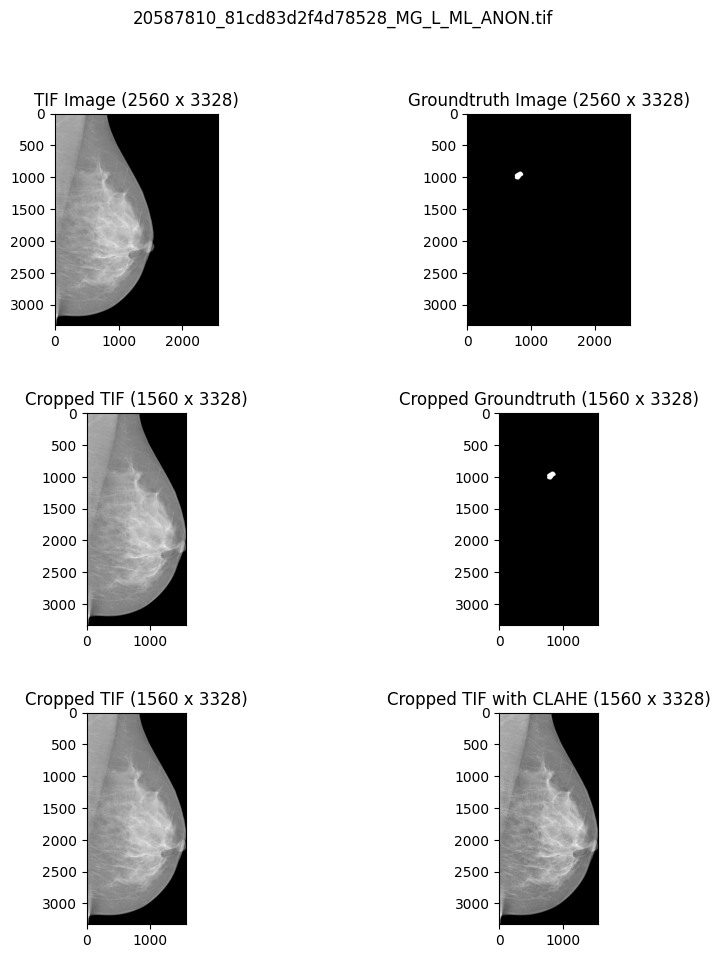

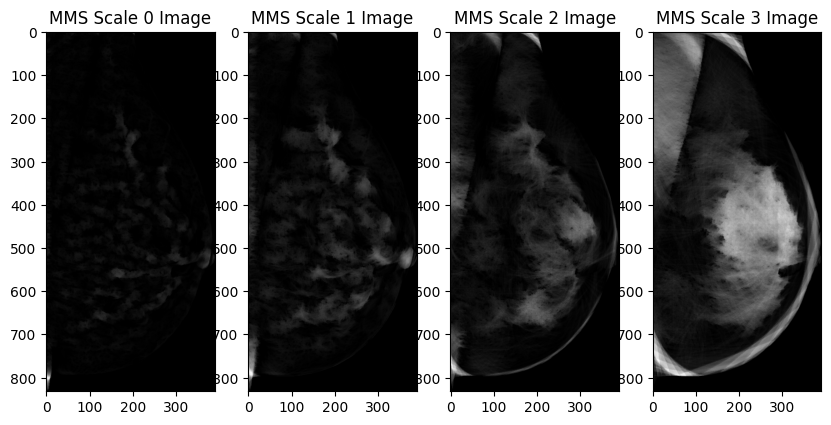

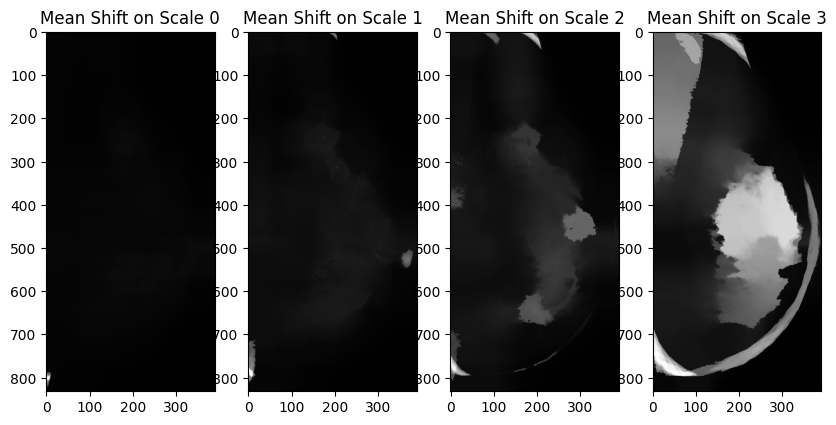

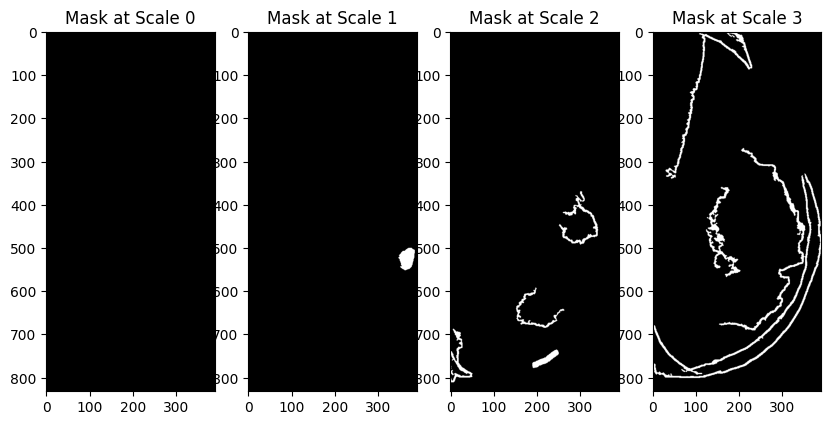

The Dice score on scale 0 0.0
The Dice score on scale 1 0.0
The Dice score on scale 2 0.0
The Dice score on scale 3 0.0
The sensitivity on scale 0 0.0
The sensitivity on scale 1 0.0
The sensitivity on scale 2 0.0
The sensitivity on scale 3 0.0
h: (638, 277) uint16
h: (638, 277) uint8
20587902_8dbbd4e51f549ff0_MG_R_CC_ANON.tif
(4, 638, 277) int32
ms: (638, 277) uint8
(638, 277) uint8


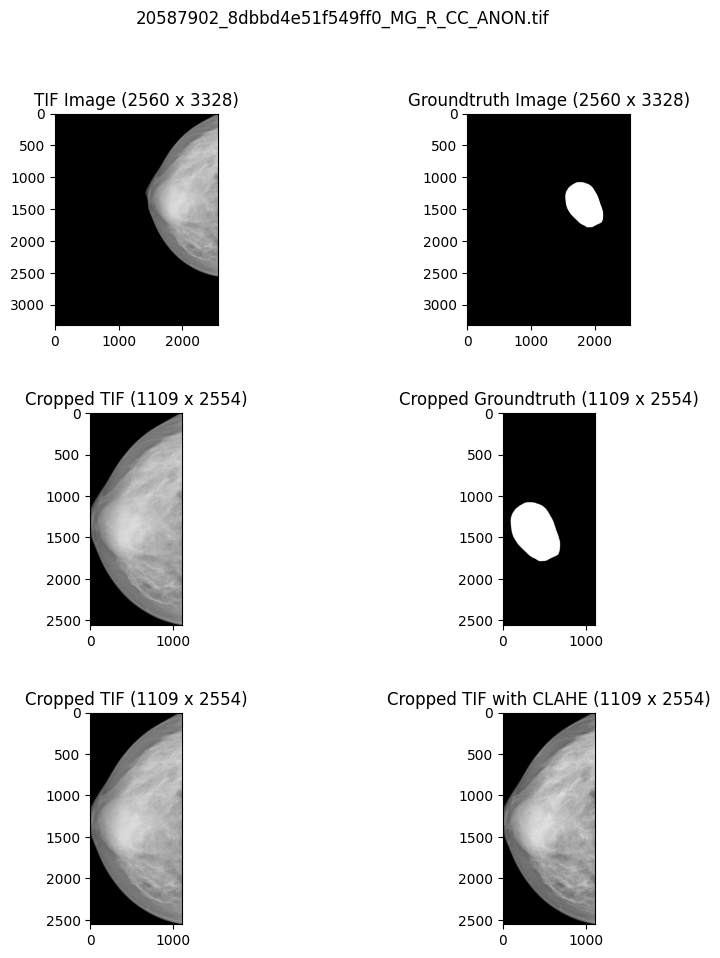

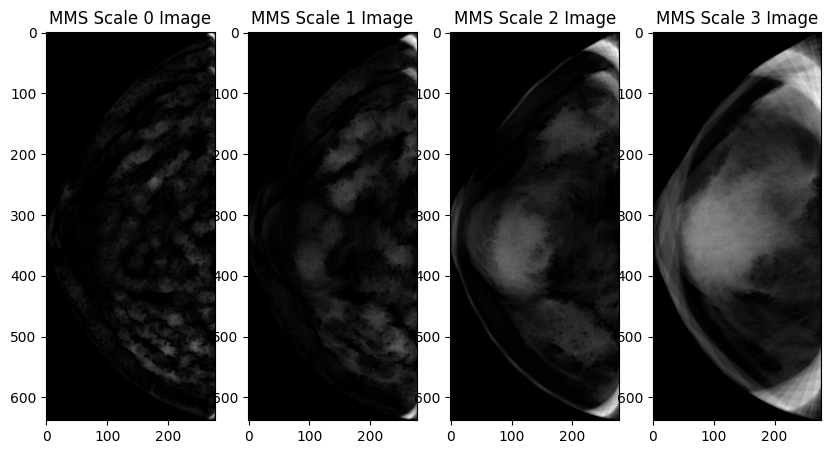

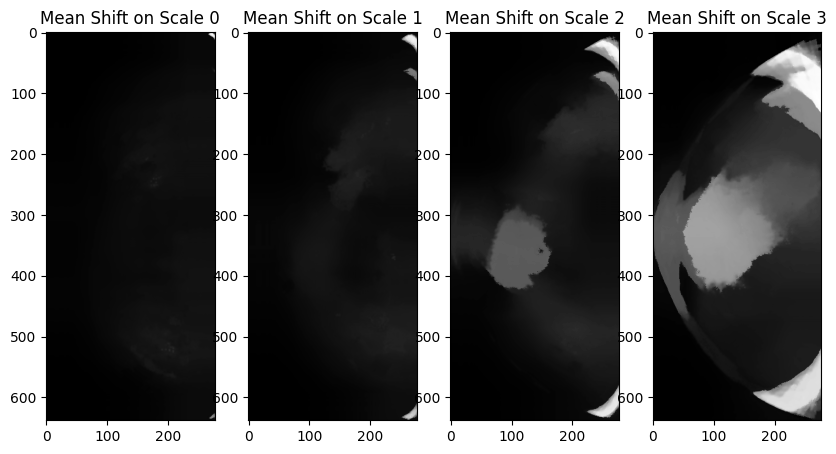

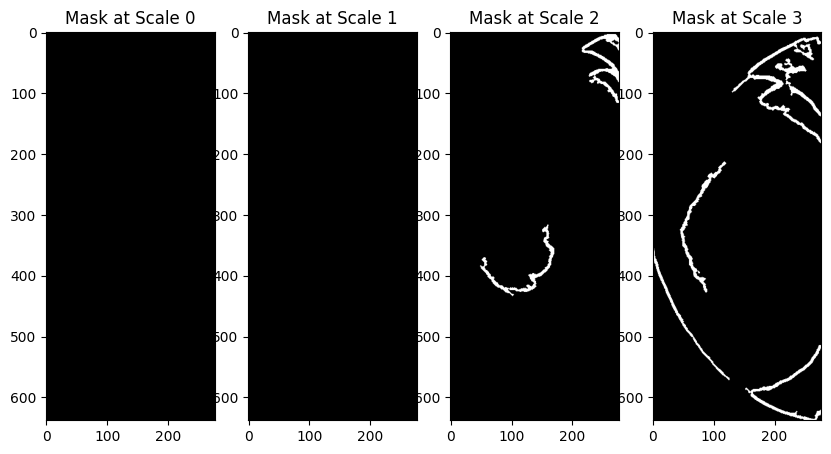

The Dice score on scale 0 0.0
The Dice score on scale 1 0.0
The Dice score on scale 2 0.10282042127811496
The Dice score on scale 3 0.0745797929575897
The sensitivity on scale 0 0.0
The sensitivity on scale 1 0.0
The sensitivity on scale 2 0.05959956541983548
The sensitivity on scale 3 0.05199441254074189
h: (694, 320) uint16
h: (694, 320) uint8
20587928_8dbbd4e51f549ff0_MG_R_ML_ANON.tif
(4, 694, 320) int32
ms: (694, 320) uint8
(694, 320) uint8


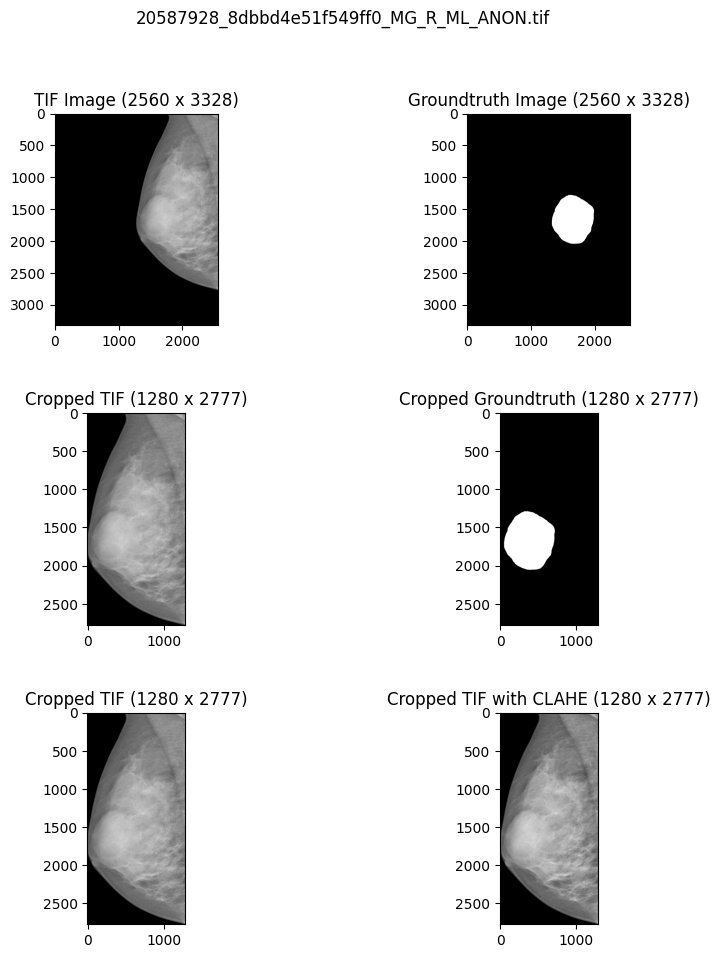

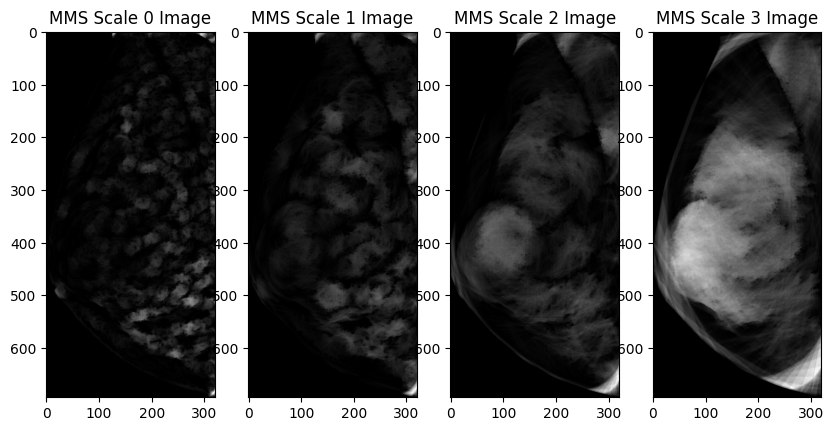

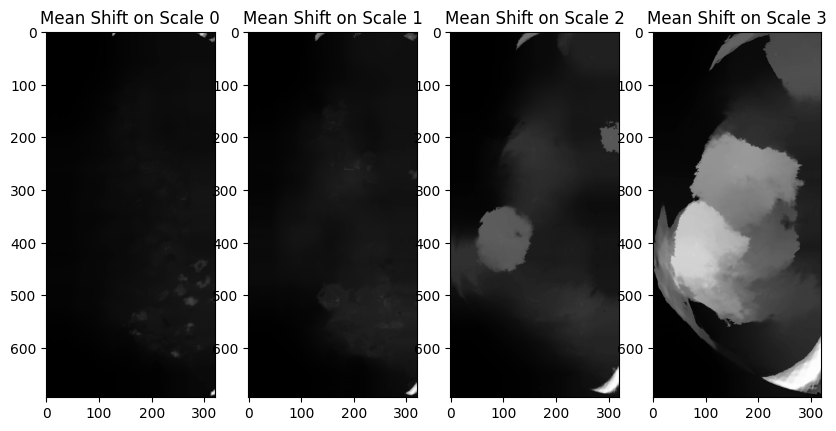

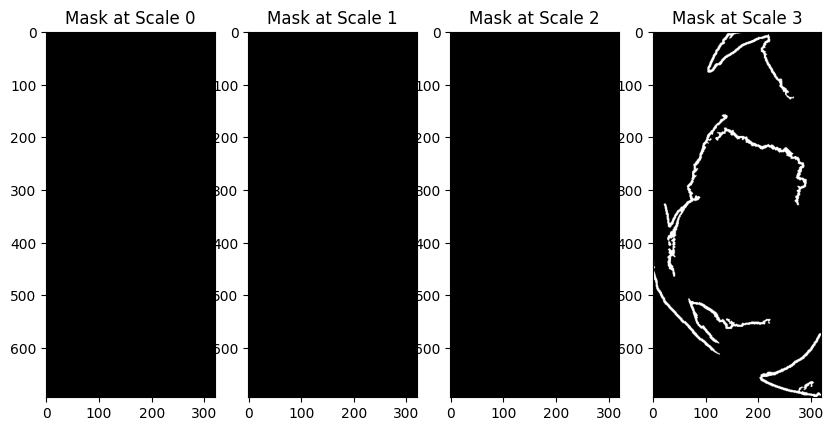

The Dice score on scale 0 0.0
The Dice score on scale 1 0.0
The Dice score on scale 2 0.0
The Dice score on scale 3 0.06671847566416257
The sensitivity on scale 0 0.0
The sensitivity on scale 1 0.0
The sensitivity on scale 2 0.0
The sensitivity on scale 3 0.04801557709835115
h: (770, 354) uint16
h: (770, 354) uint8
20587994_024ee3569b2605dc_MG_R_CC_ANON.tif
(4, 770, 354) int32
ms: (770, 354) uint8
(770, 354) uint8


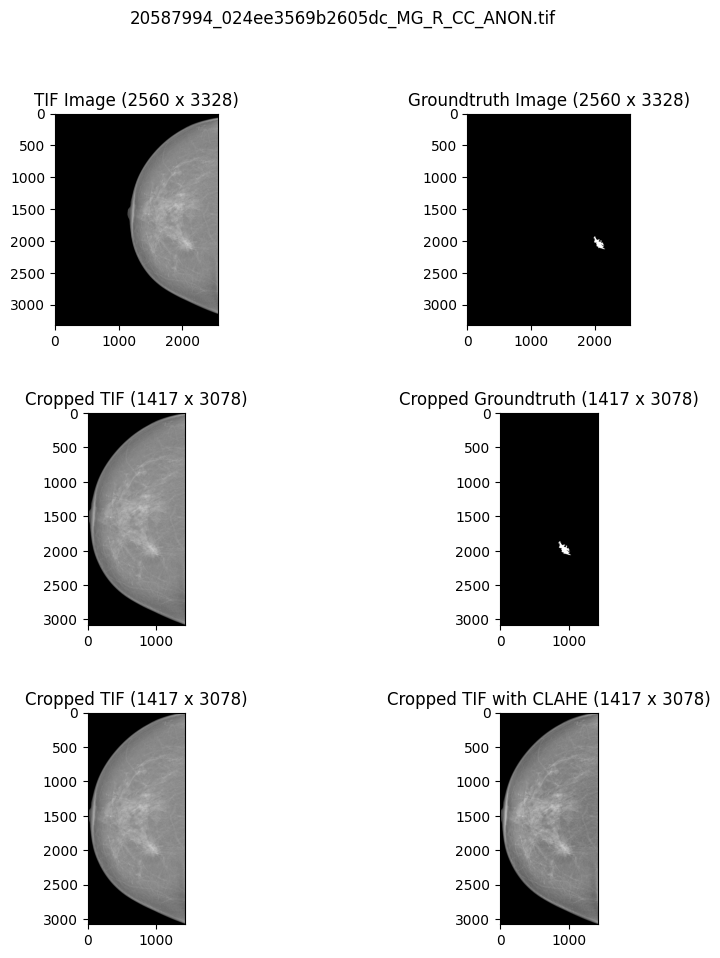

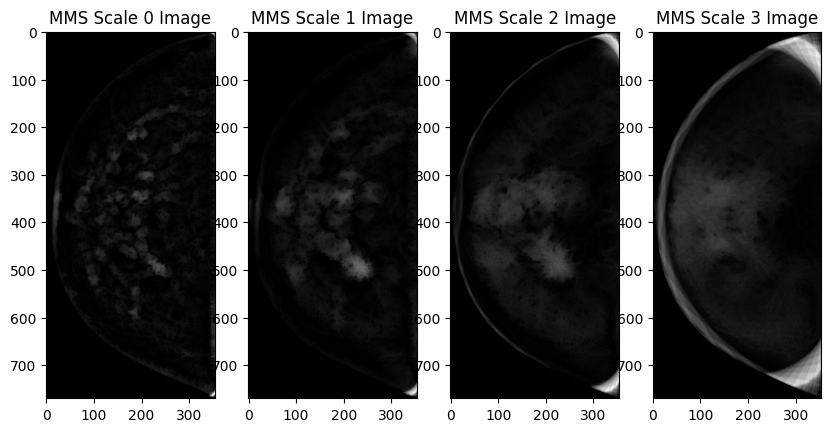

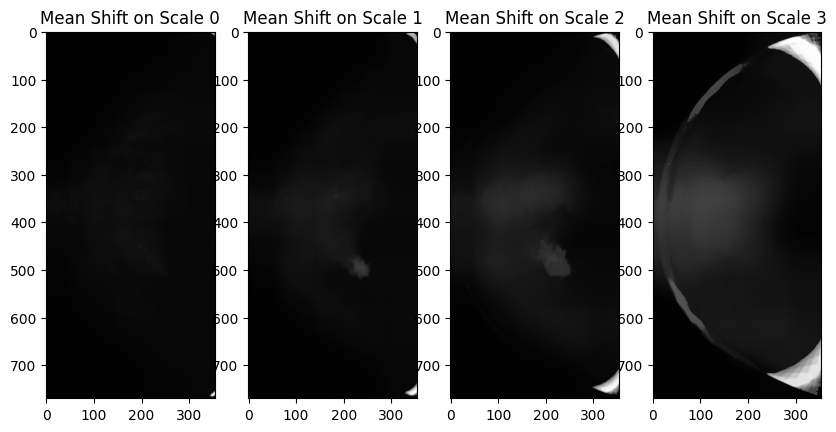

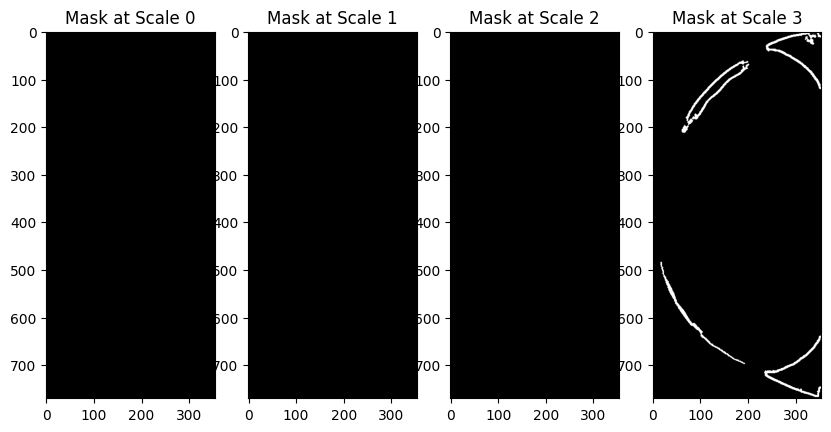

The Dice score on scale 0 0.0
The Dice score on scale 1 0.0
The Dice score on scale 2 0.0
The Dice score on scale 3 0.0
The sensitivity on scale 0 0.0
The sensitivity on scale 1 0.0
The sensitivity on scale 2 0.0
The sensitivity on scale 3 0.0
h: (782, 414) uint16
h: (782, 414) uint8
20588046_024ee3569b2605dc_MG_R_ML_ANON.tif
(4, 782, 414) int32
ms: (782, 414) uint8
(782, 414) uint8


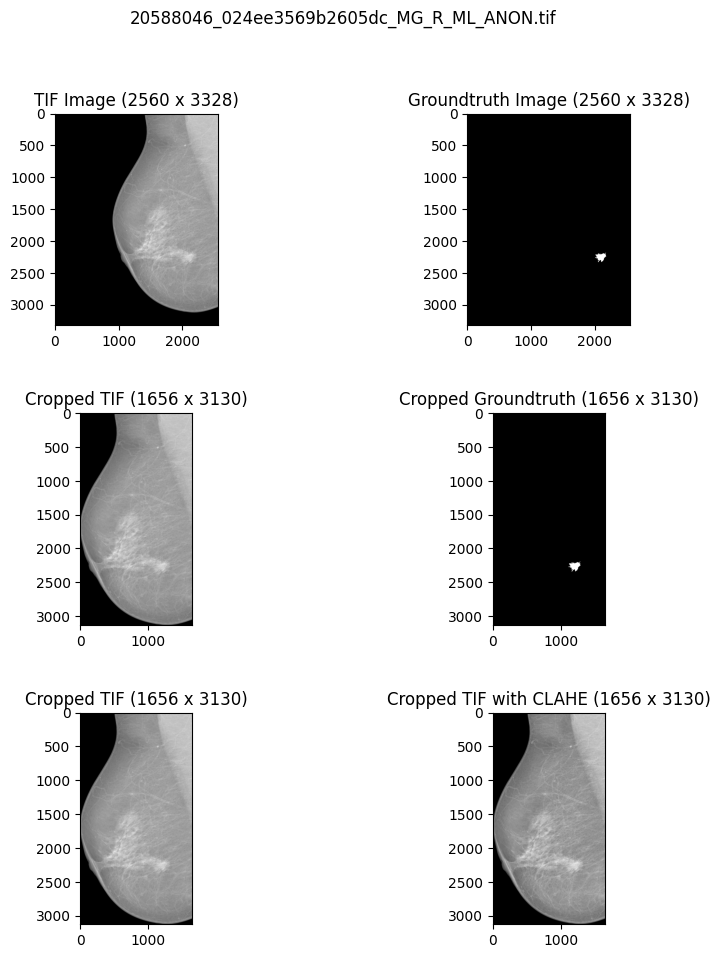

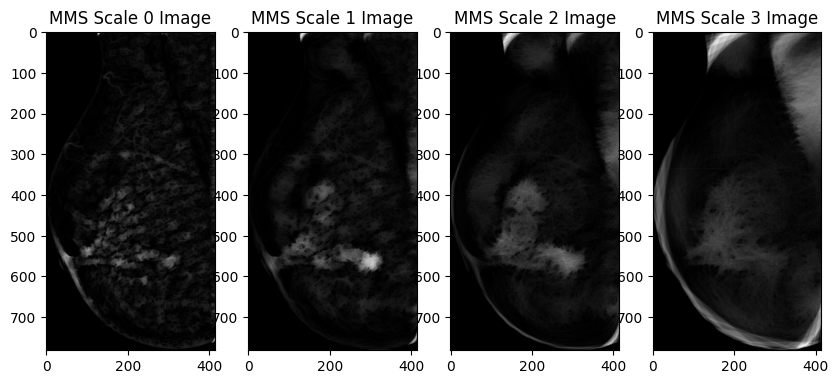

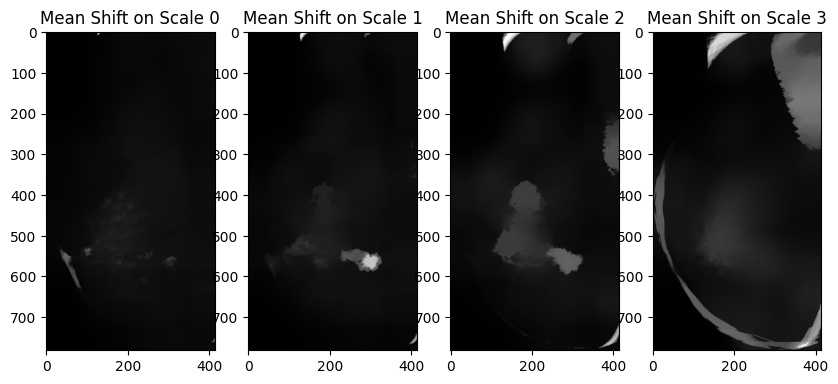

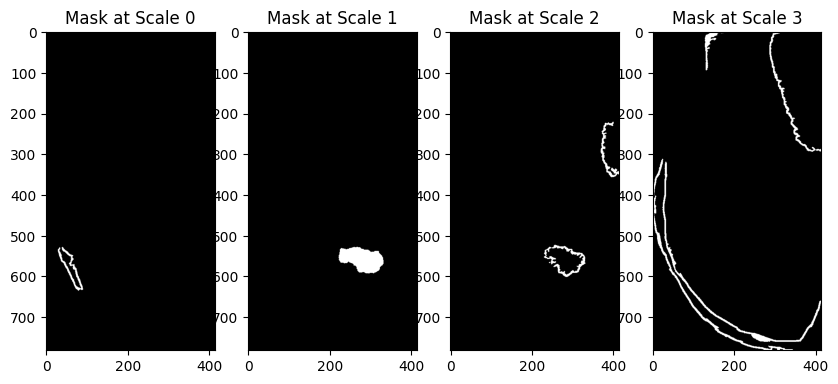

The Dice score on scale 0 0.0
The Dice score on scale 1 0.3201229928254185
The Dice score on scale 2 0.0032318879612173446
The Dice score on scale 3 0.0
The sensitivity on scale 0 0.0
The sensitivity on scale 1 1.0
The sensitivity on scale 2 0.0064034151547491995
The sensitivity on scale 3 0.0
h: (754, 303) uint16
h: (754, 303) uint8
20588190_8d0b9620c53c0268_MG_L_CC_ANON.tif
(4, 754, 303) int32
ms: (754, 303) uint8
(754, 303) uint8


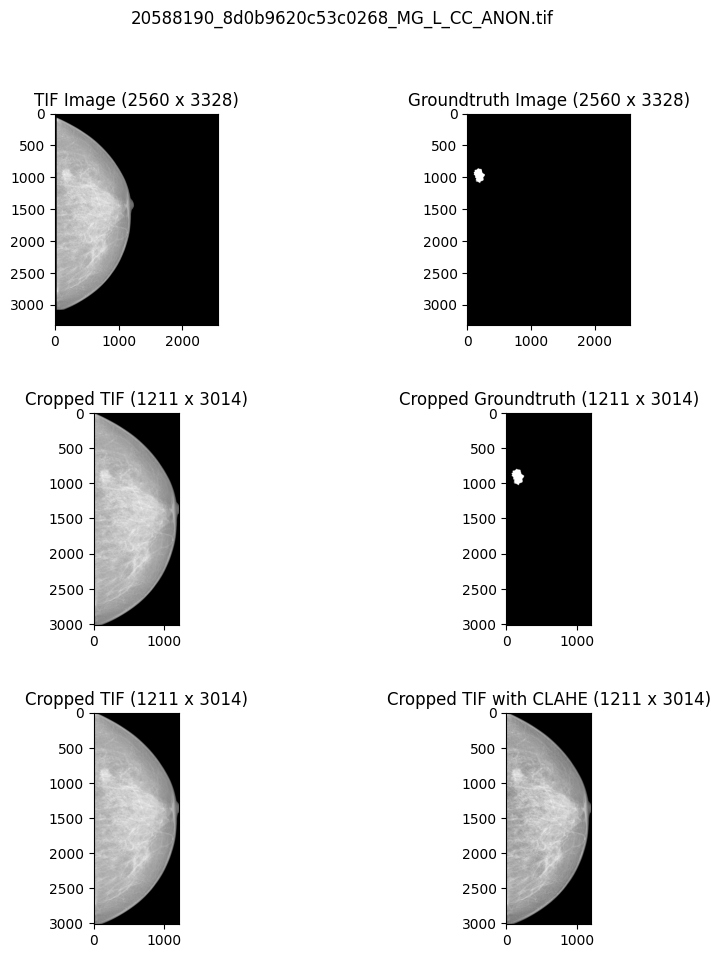

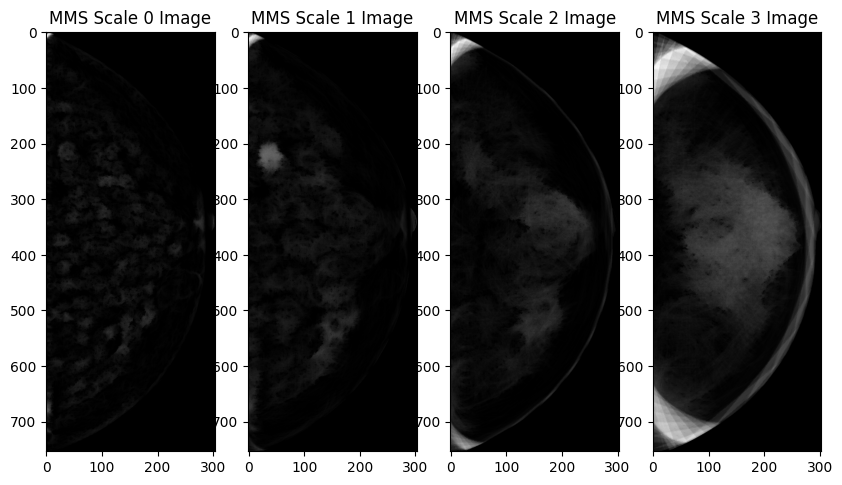

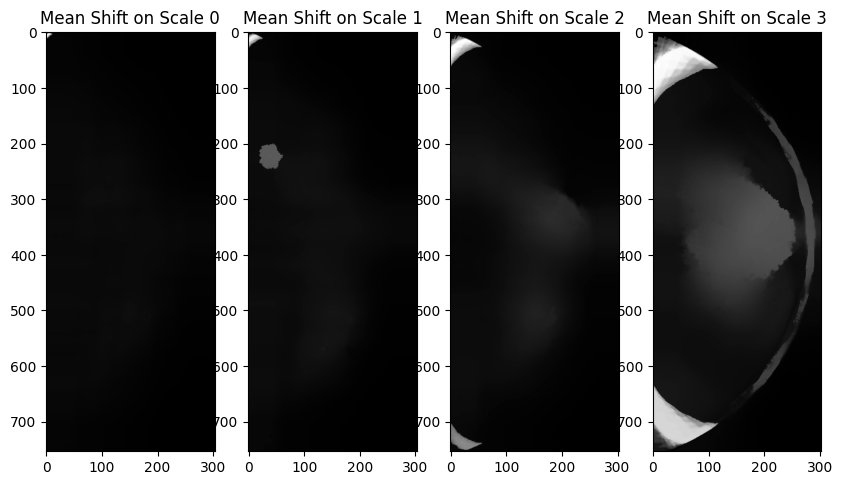

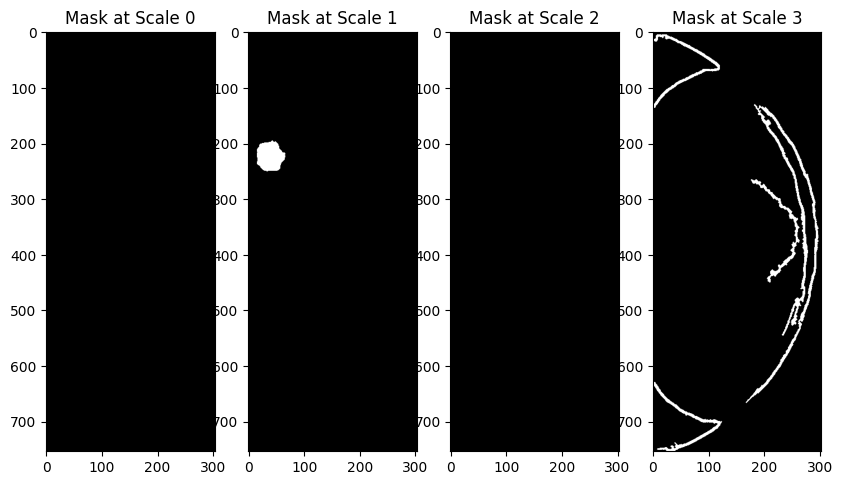

The Dice score on scale 0 0.0
The Dice score on scale 1 0.8486772486772487
The Dice score on scale 2 0.0
The Dice score on scale 3 0.0
The sensitivity on scale 0 0.0
The sensitivity on scale 1 0.9738919247115968
The sensitivity on scale 2 0.0
The sensitivity on scale 3 0.0
h: (776, 347) uint16
h: (776, 347) uint8
20588216_8d0b9620c53c0268_MG_L_ML_ANON.tif
(4, 776, 347) int32
ms: (776, 347) uint8
(776, 347) uint8


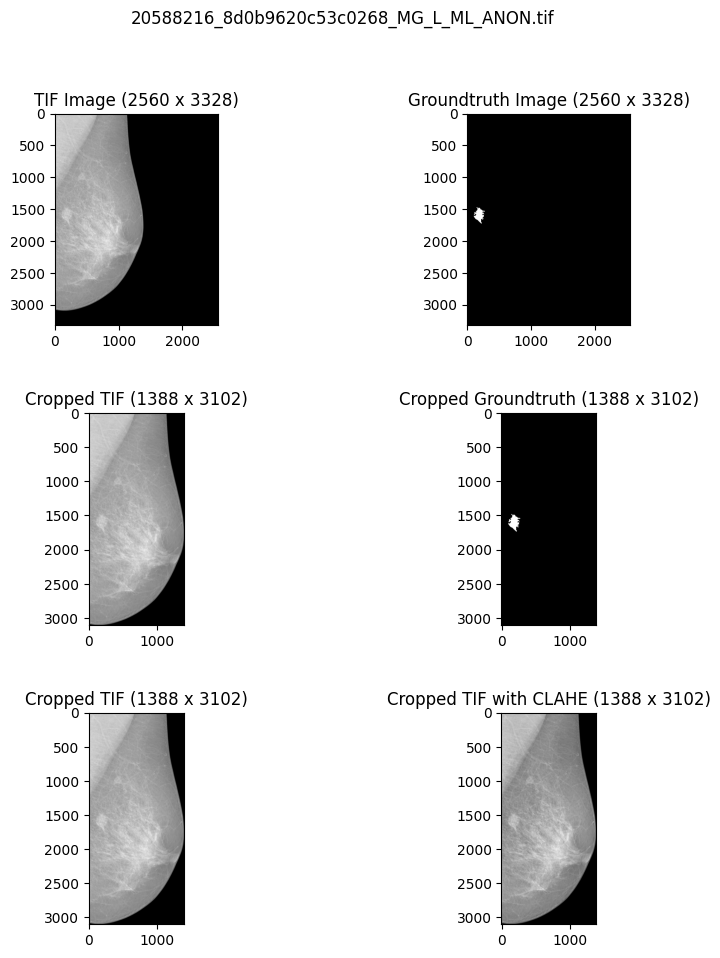

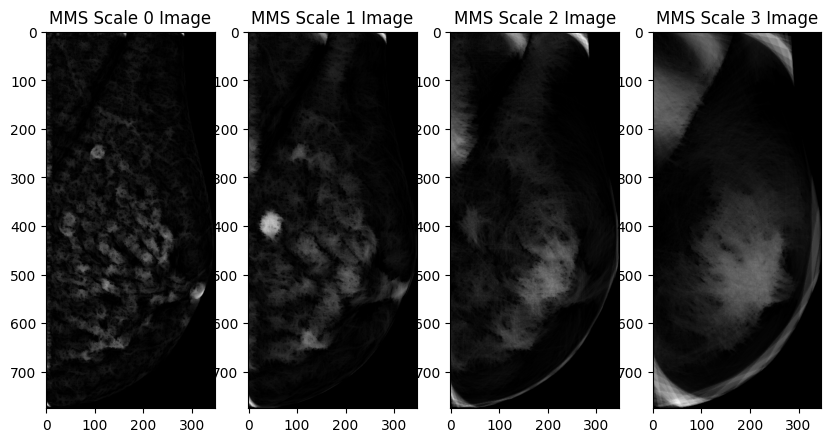

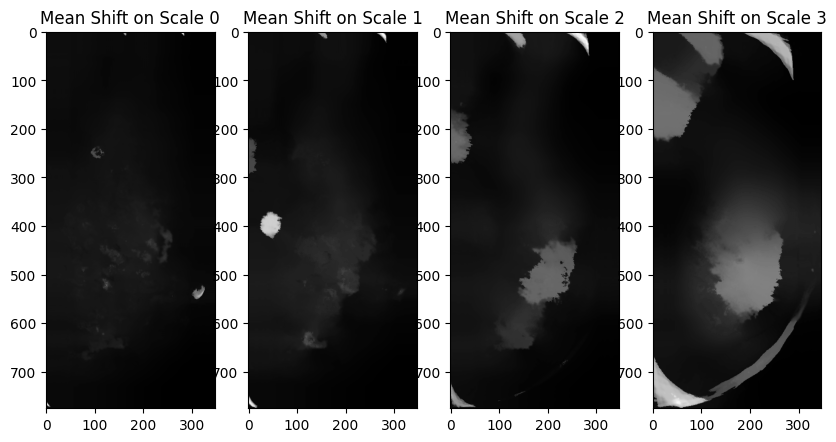

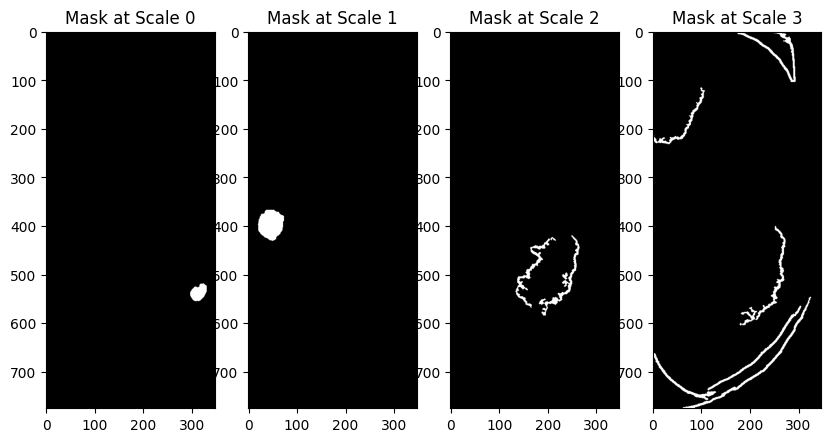

The Dice score on scale 0 0.0
The Dice score on scale 1 0.7274975272007913
The Dice score on scale 2 0.0
The Dice score on scale 3 0.0
The sensitivity on scale 0 0.0
The sensitivity on scale 1 0.9885752688172043
The sensitivity on scale 2 0.0
The sensitivity on scale 3 0.0
h: (653, 290) uint16
h: (653, 290) uint8
20588308_493155e17143edef_MG_L_ML_ANON.tif
(4, 653, 290) int32
ms: (653, 290) uint8
(653, 290) uint8


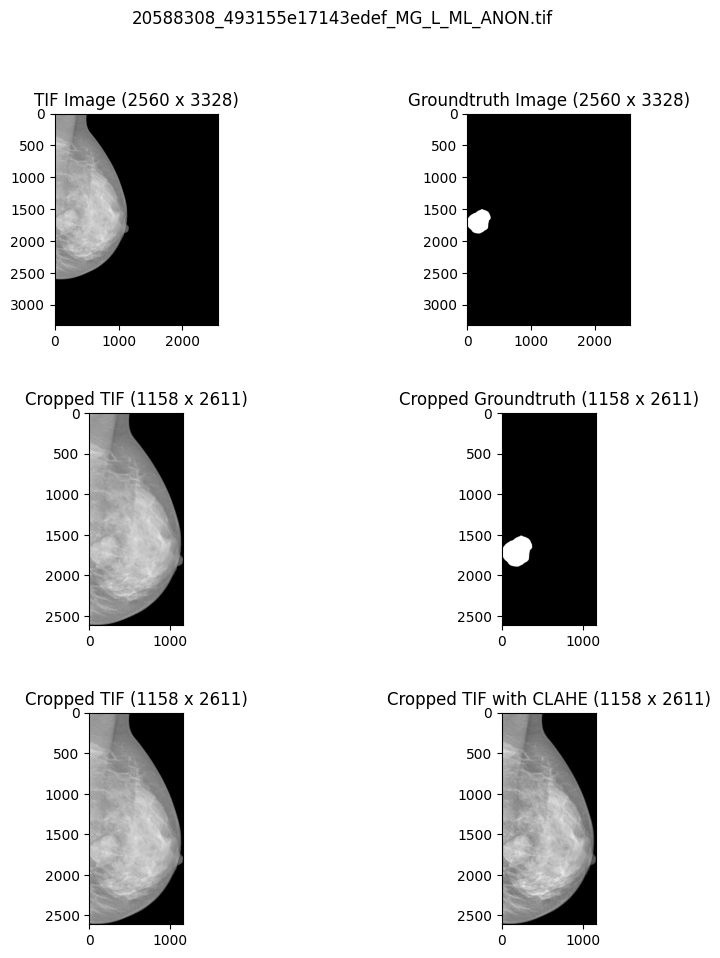

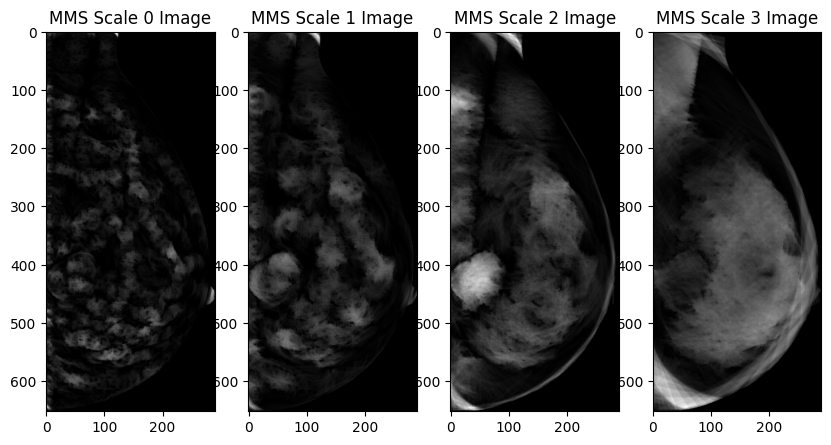

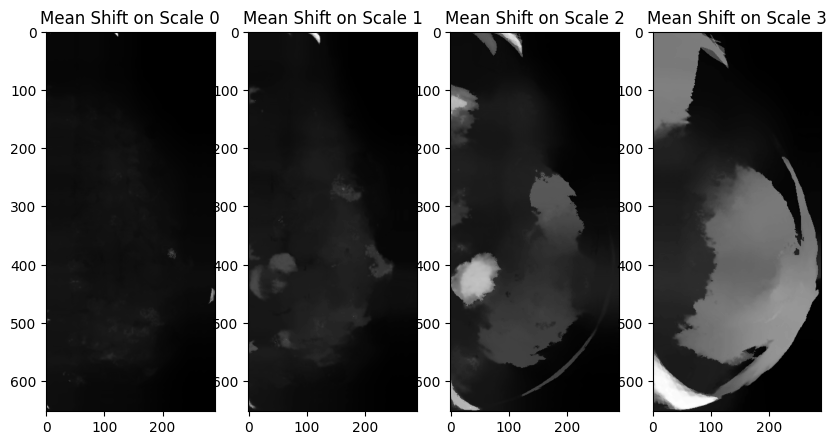

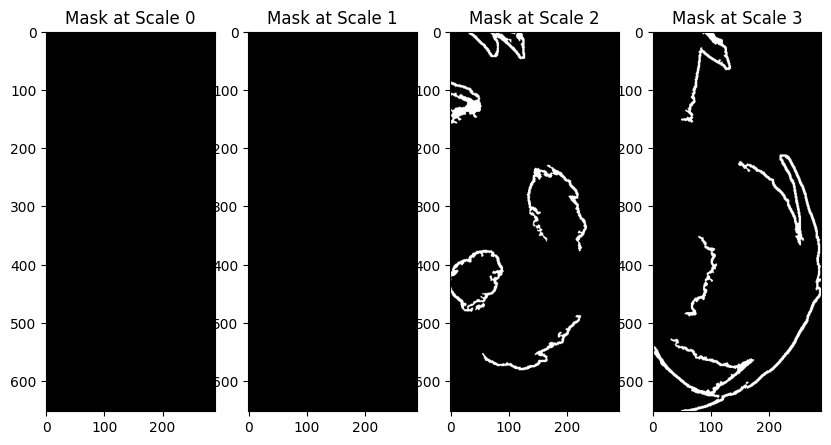

The Dice score on scale 0 0.0
The Dice score on scale 1 0.0
The Dice score on scale 2 0.1622070109935698
The Dice score on scale 3 0.0016247969003874516
The sensitivity on scale 0 0.0
The sensitivity on scale 1 0.0
The sensitivity on scale 2 0.1831095847642835
The sensitivity on scale 3 0.0020293474867311896
h: (563, 248) uint16
h: (563, 248) uint8
20588334_493155e17143edef_MG_L_CC_ANON.tif
(4, 563, 248) int32
ms: (563, 248) uint8
(563, 248) uint8


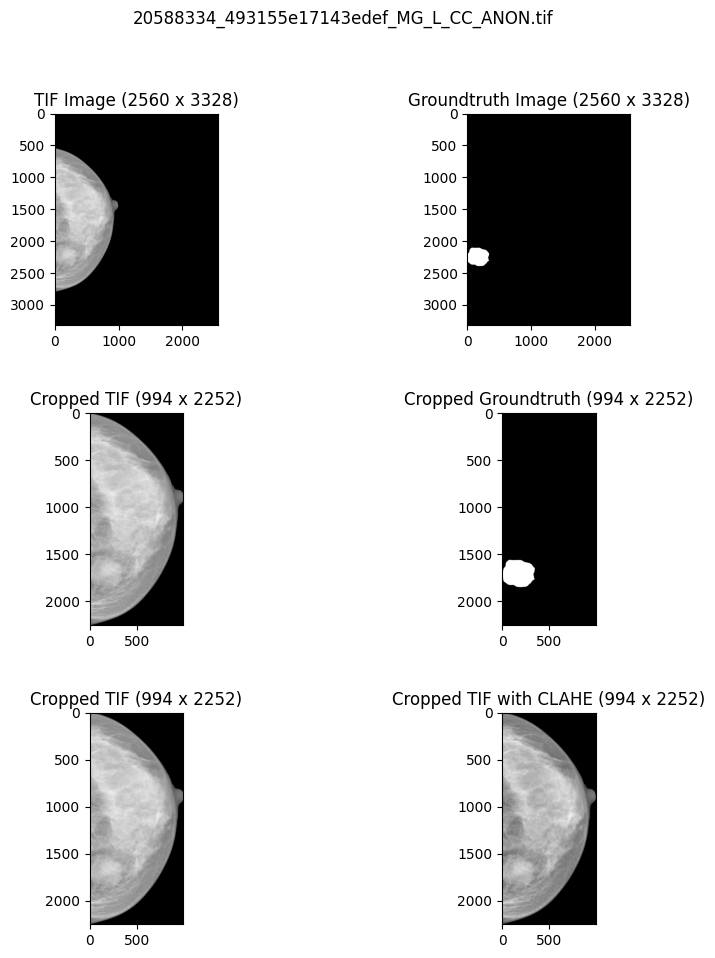

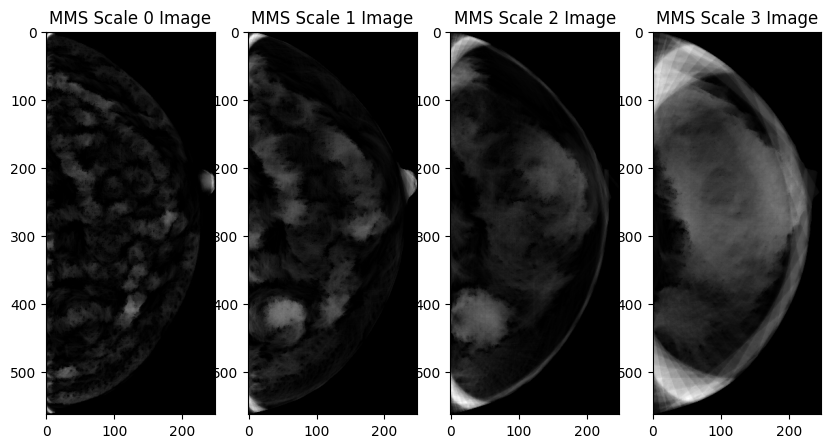

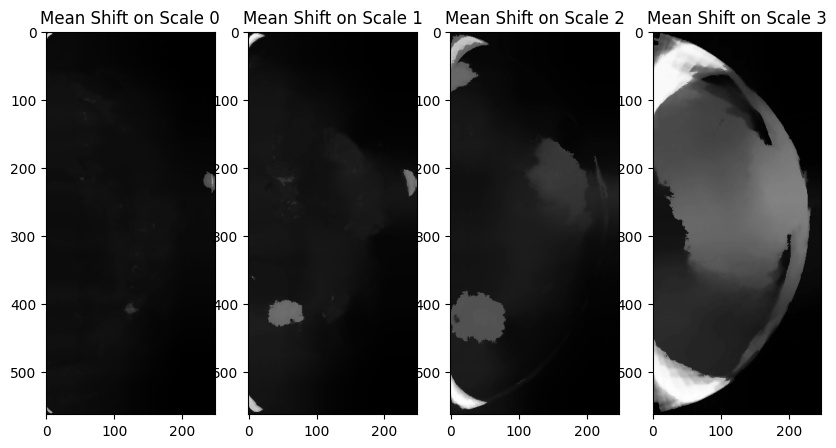

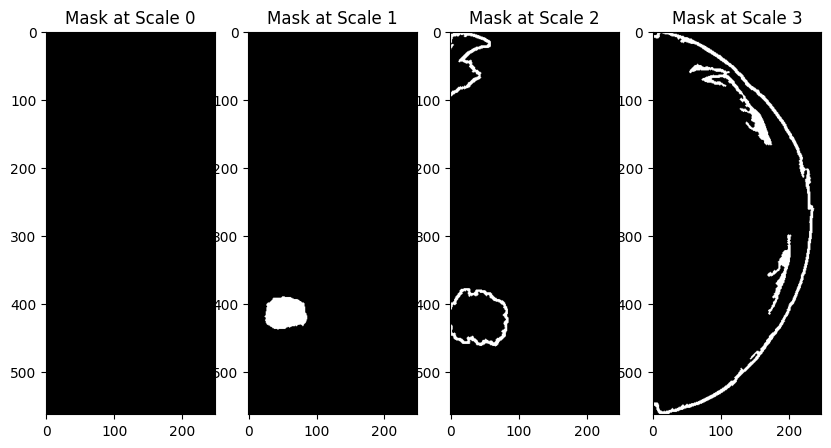

The Dice score on scale 0 0.0
The Dice score on scale 1 0.6026552232801394
The Dice score on scale 2 0.16258648217136776
The Dice score on scale 3 0.0
The sensitivity on scale 0 0.0
The sensitivity on scale 1 0.44337016574585636
The sensitivity on scale 2 0.12056037884767166
The sensitivity on scale 3 0.0
h: (789, 419) uint16
h: (789, 419) uint8
20588536_bf1a6aaadb05e3df_MG_L_ML_ANON.tif
(4, 789, 419) int32
ms: (789, 419) uint8
(789, 419) uint8


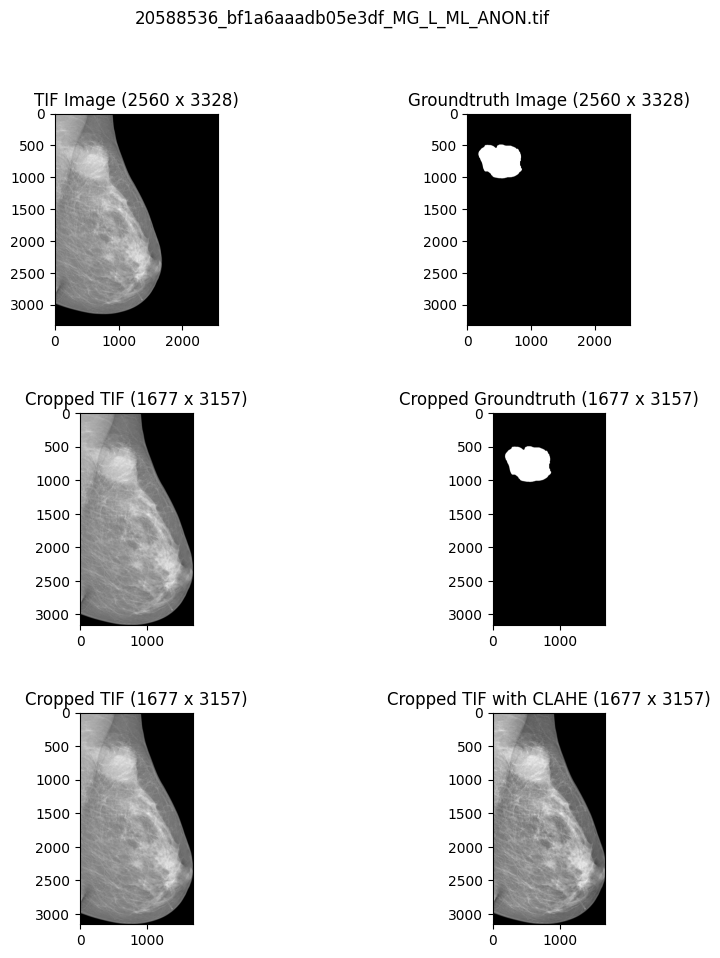

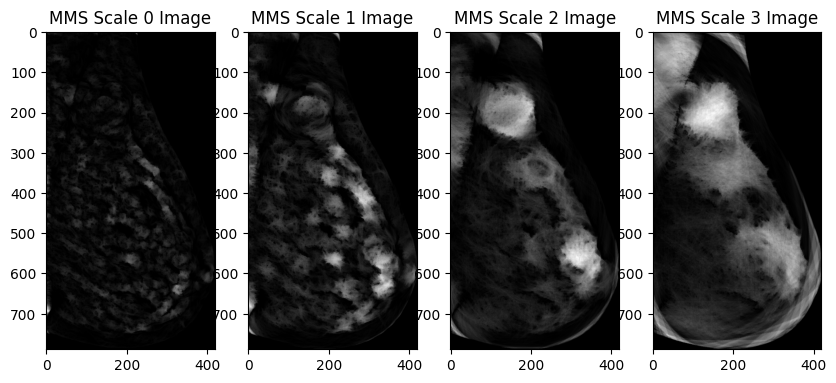

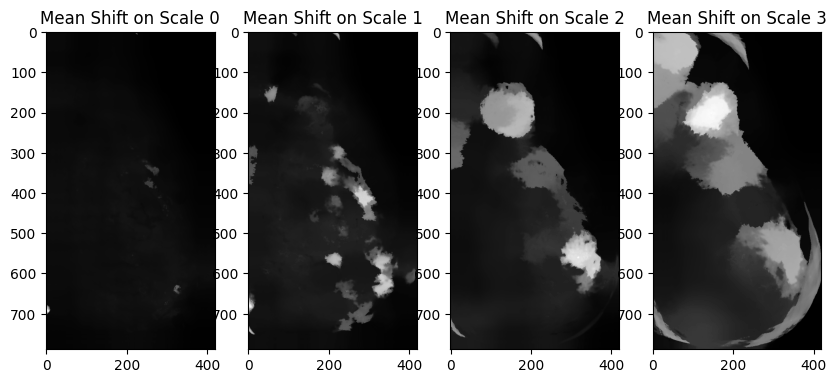

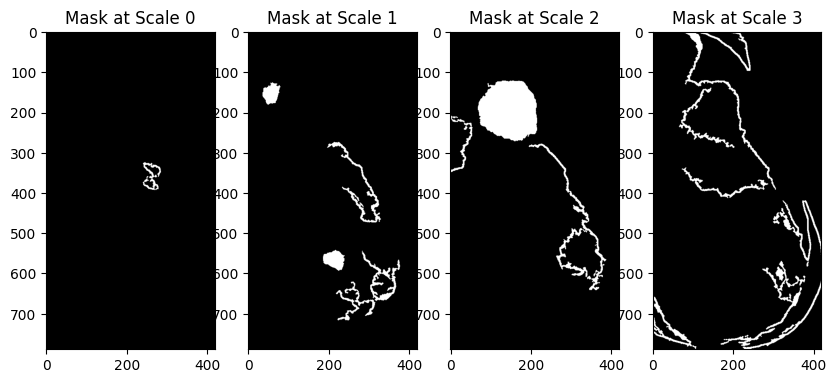

The Dice score on scale 0 0.0
The Dice score on scale 1 0.08254349978780591
The Dice score on scale 2 0.7370399826476756
The Dice score on scale 3 0.06958804307065945
The sensitivity on scale 0 0.0
The sensitivity on scale 1 0.0649994430210538
The sensitivity on scale 2 0.8516765066280495
The sensitivity on scale 3 0.07235156511083882
h: (730, 447) uint16
h: (730, 447) uint8
20588562_bf1a6aaadb05e3df_MG_L_CC_ANON.tif
(4, 730, 447) int32
ms: (730, 447) uint8
(730, 447) uint8


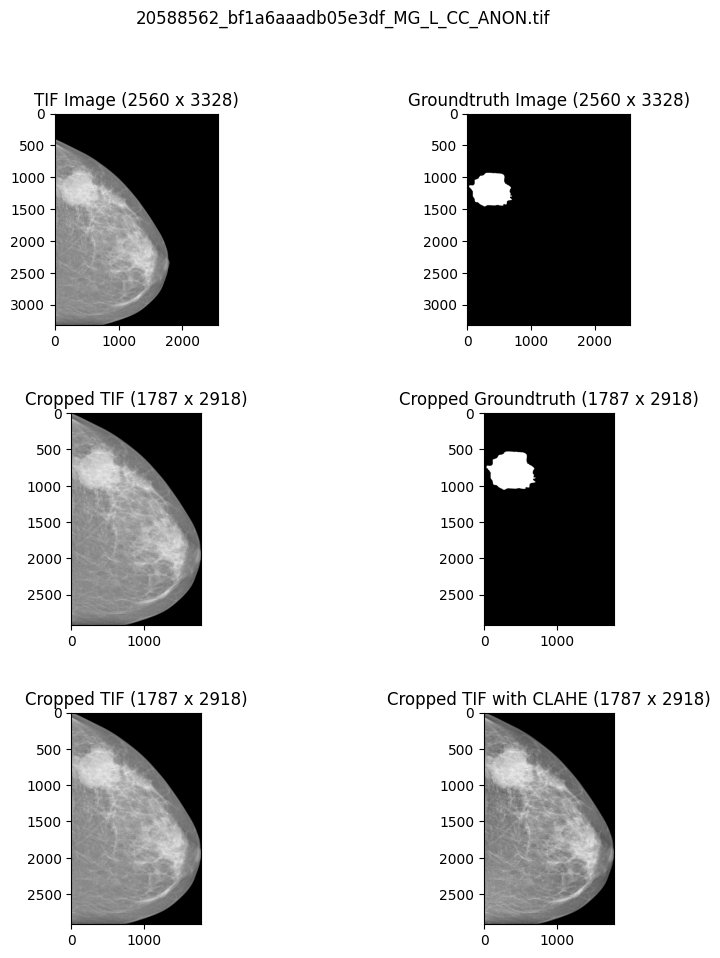

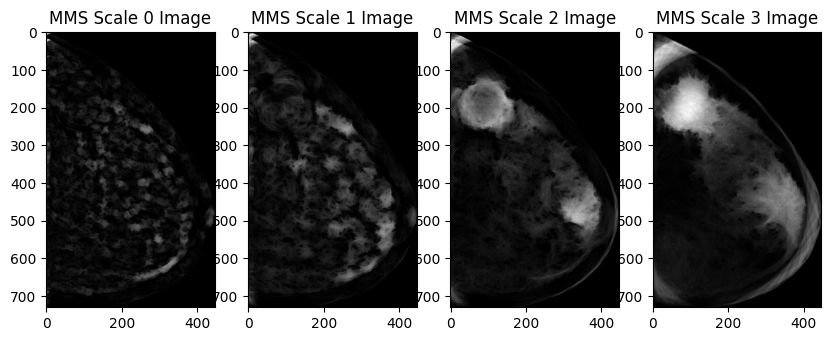

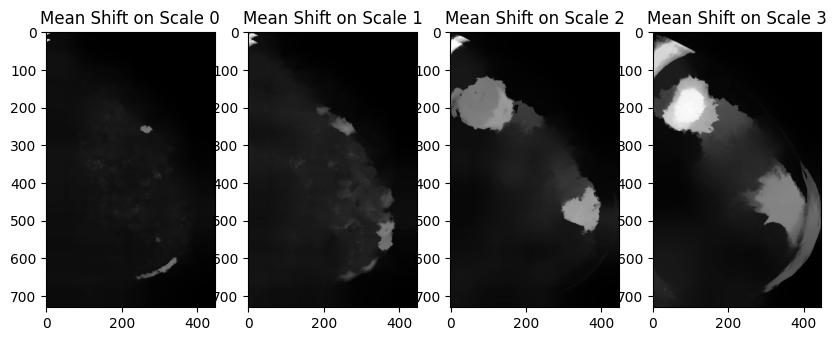

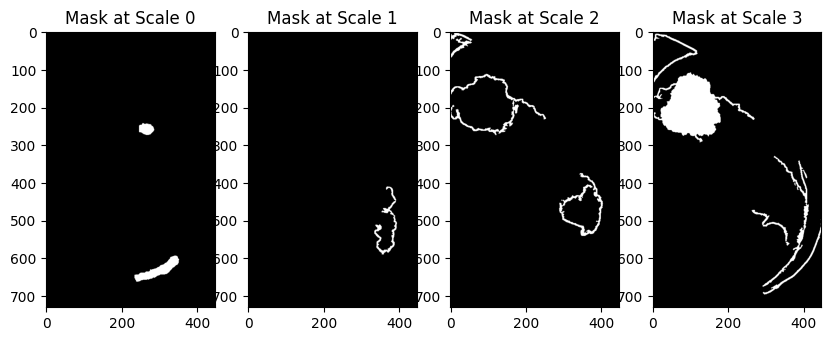

The Dice score on scale 0 0.0
The Dice score on scale 1 0.0
The Dice score on scale 2 0.06817050920550671
The Dice score on scale 3 0.6909889908676844
The sensitivity on scale 0 0.0
The sensitivity on scale 1 0.0
The sensitivity on scale 2 0.050860042074000744
The sensitivity on scale 3 0.9339809429526049
h: (862, 468) uint16
h: (862, 468) uint8
20588680_036aff49b8ac84f0_MG_L_ML_ANON.tif
(4, 862, 468) int32
ms: (862, 468) uint8
(862, 468) uint8


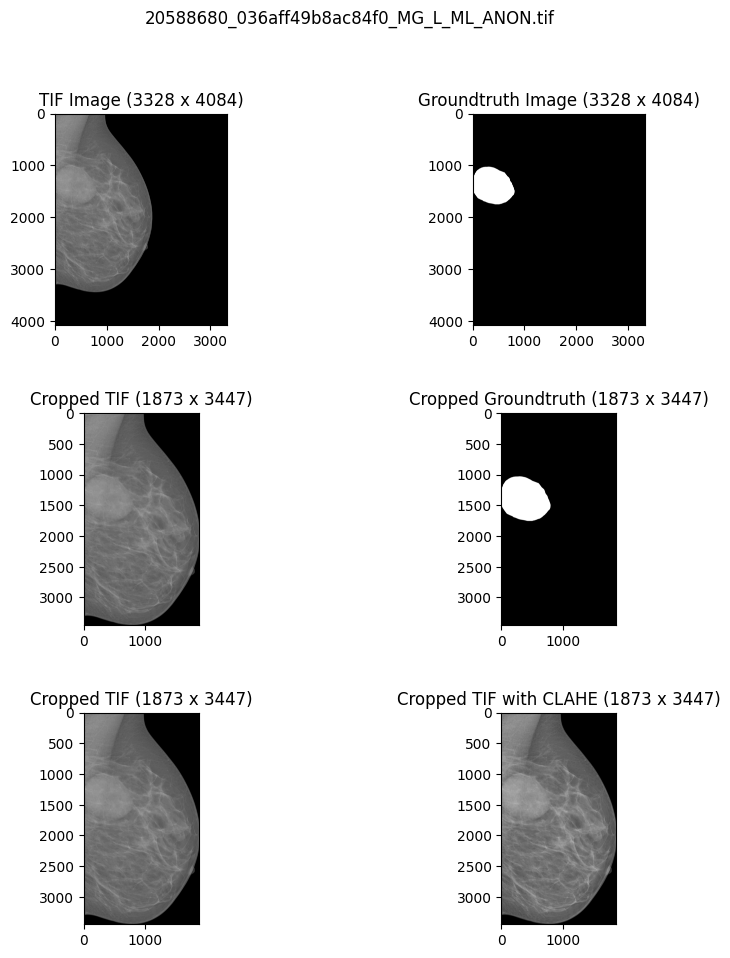

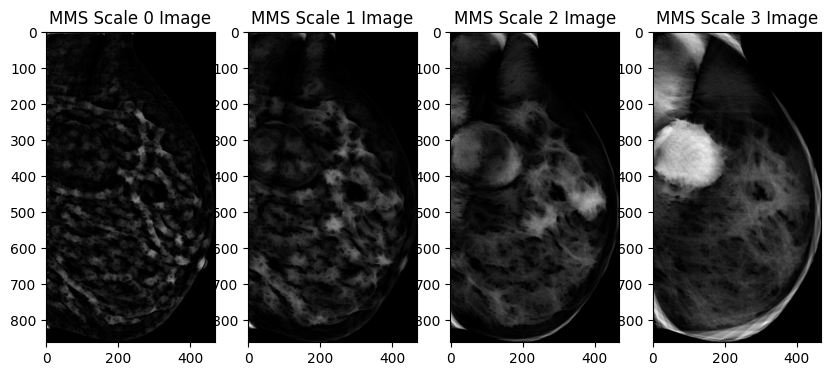

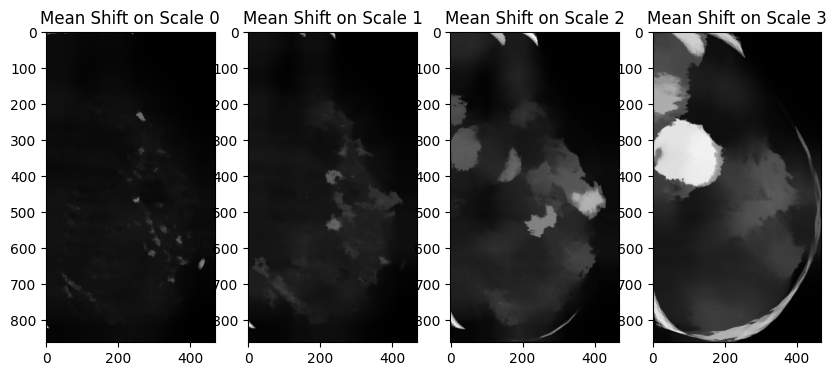

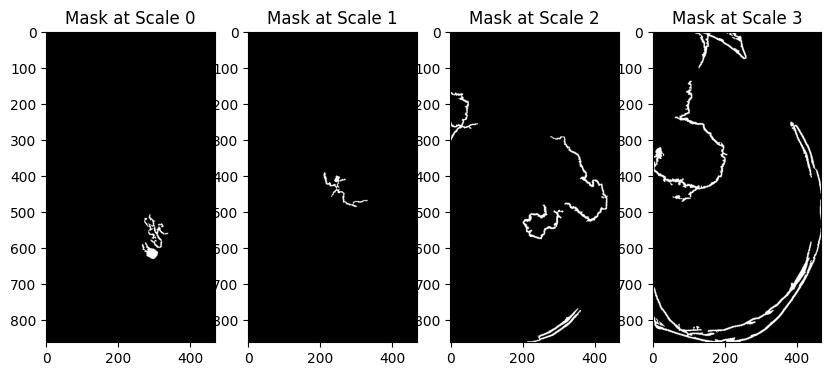

The Dice score on scale 0 0.0
The Dice score on scale 1 0.0
The Dice score on scale 2 0.013757235131280934
The Dice score on scale 3 0.10138248847926268
The sensitivity on scale 0 0.0
The sensitivity on scale 1 0.0
The sensitivity on scale 2 0.008767240457607186
The sensitivity on scale 3 0.08428668163512598
h: (876, 404) uint16
h: (876, 404) uint8
22427705_d713ef5849f98b6c_MG_L_CC_ANON.tif
(4, 876, 404) int32
ms: (876, 404) uint8
(876, 404) uint8


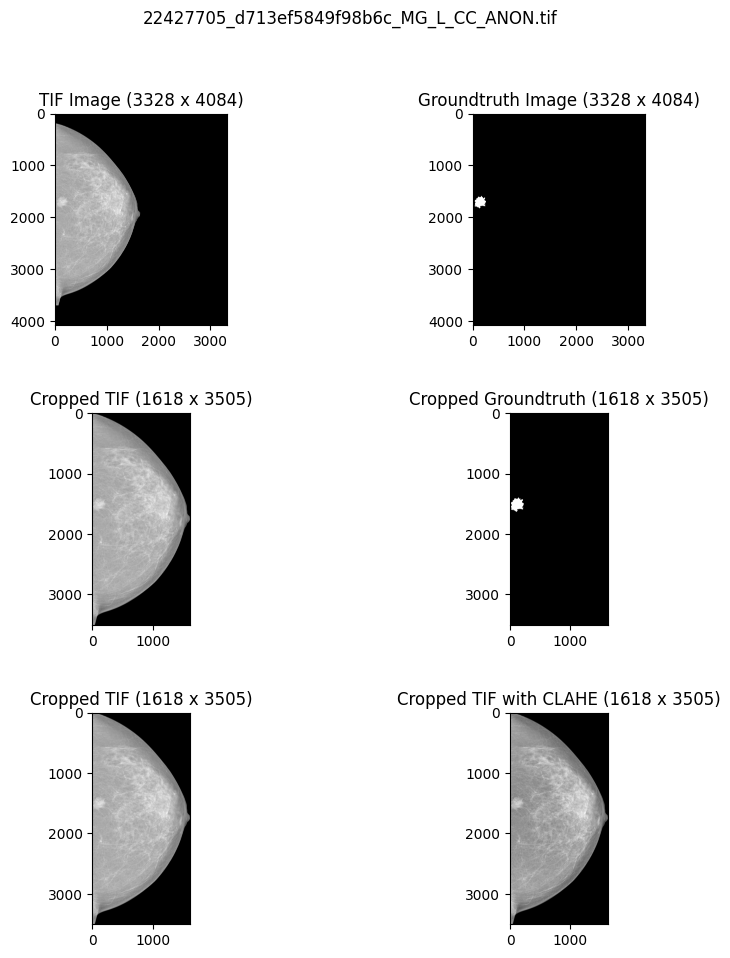

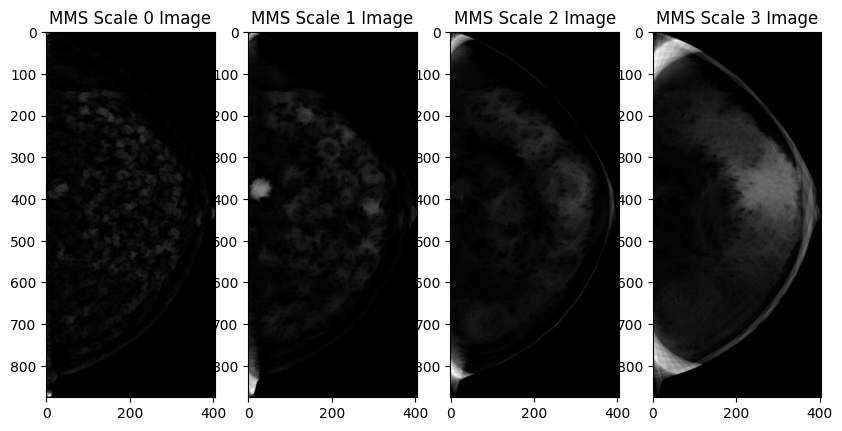

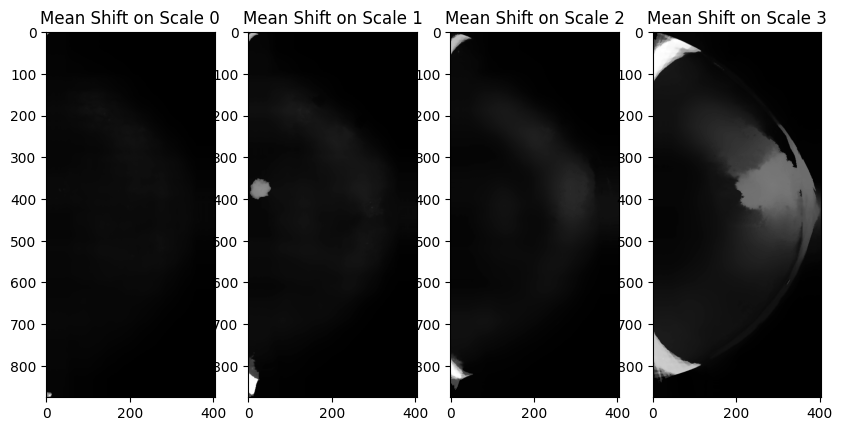

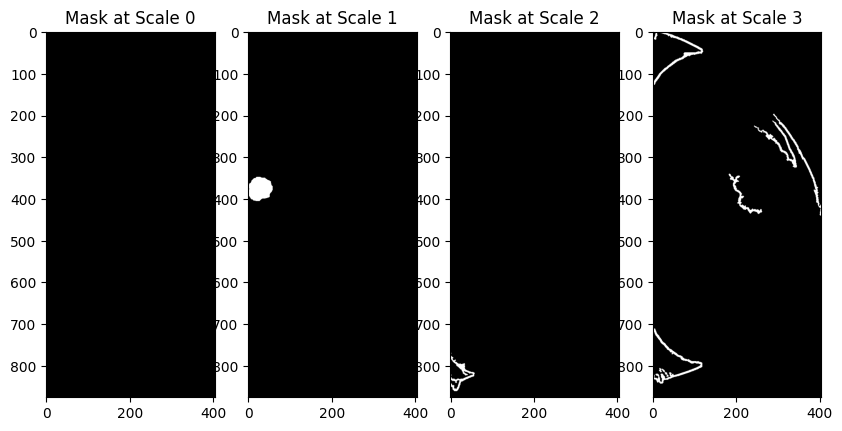

The Dice score on scale 0 0.0
The Dice score on scale 1 0.8864346738903939
The Dice score on scale 2 0.0
The Dice score on scale 3 0.0
The sensitivity on scale 0 0.0
The sensitivity on scale 1 0.9734553775743707
The sensitivity on scale 2 0.0
The sensitivity on scale 3 0.0
h: (1018, 435) uint16
h: (1018, 435) uint8
22427751_d713ef5849f98b6c_MG_L_ML_ANON.tif
(4, 1018, 435) int32
ms: (1018, 435) uint8
(1018, 435) uint8


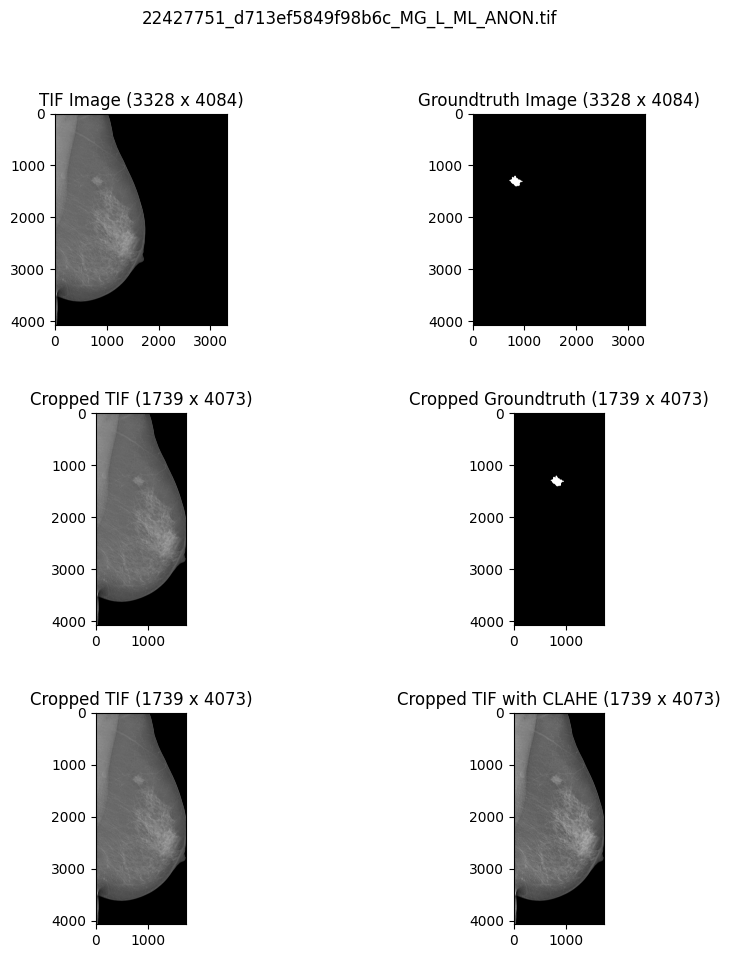

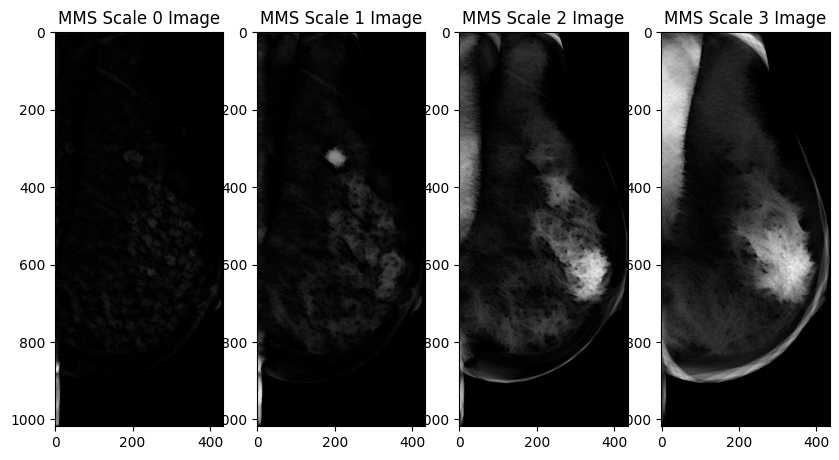

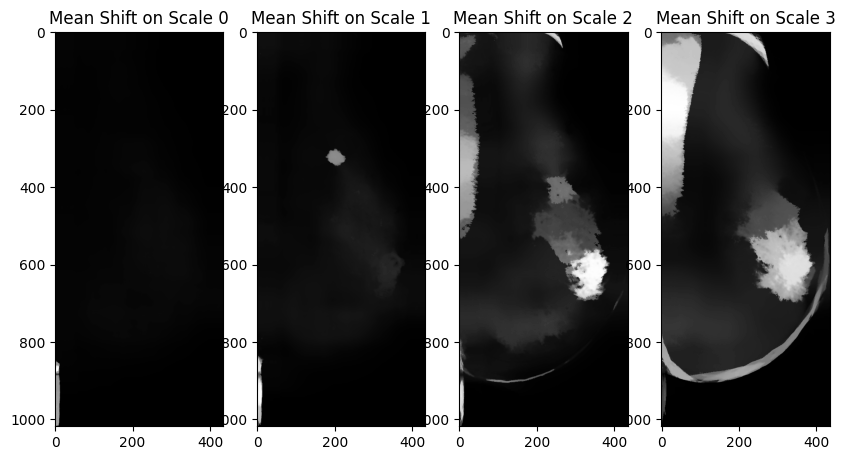

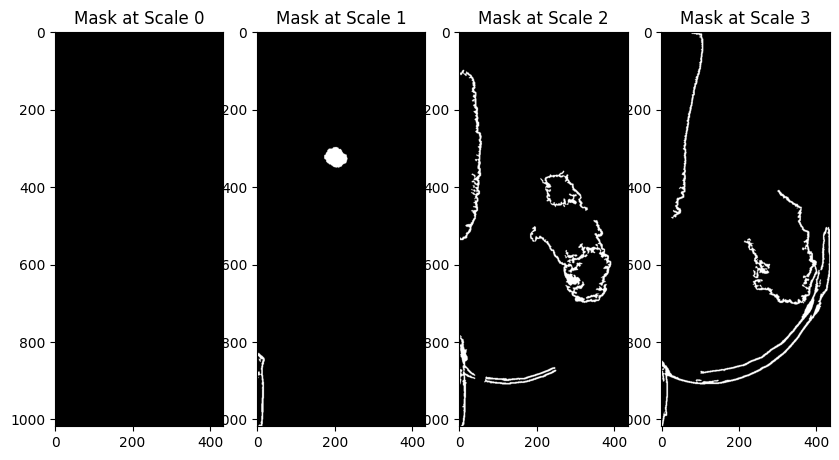

The Dice score on scale 0 0.0
The Dice score on scale 1 0.6424789174347911
The Dice score on scale 2 0.0
The Dice score on scale 3 0.0
The sensitivity on scale 0 0.0
The sensitivity on scale 1 0.9590163934426229
The sensitivity on scale 2 0.0
The sensitivity on scale 3 0.0
h: (600, 243) uint16
h: (600, 243) uint8
22427840_bbd6a3a35438c11b_MG_R_CC_ANON.tif
(4, 600, 243) int32
ms: (600, 243) uint8
(600, 243) uint8


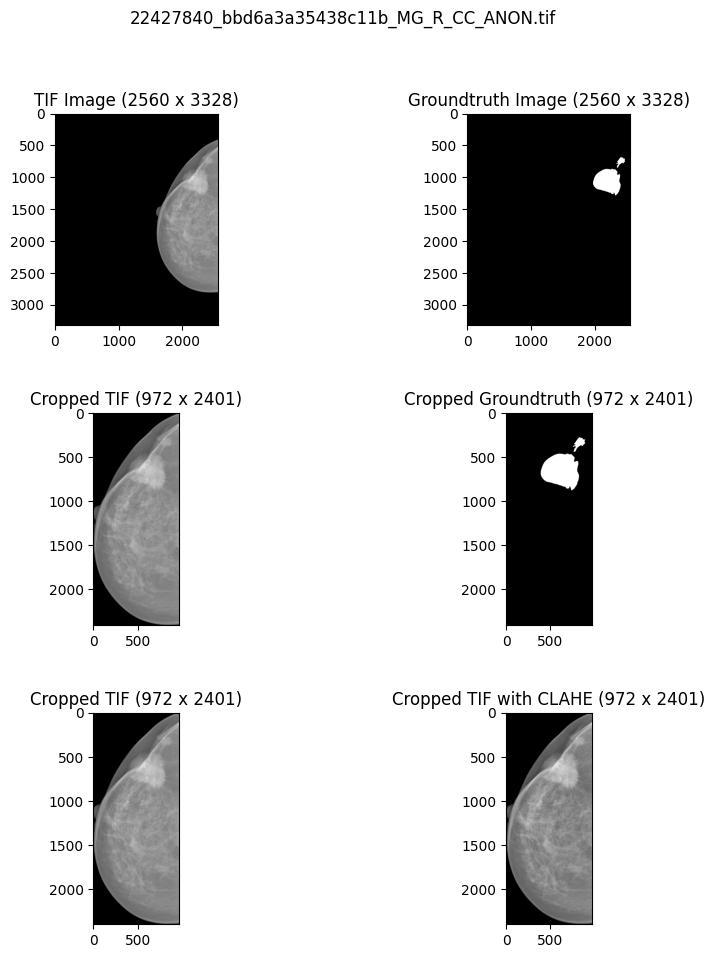

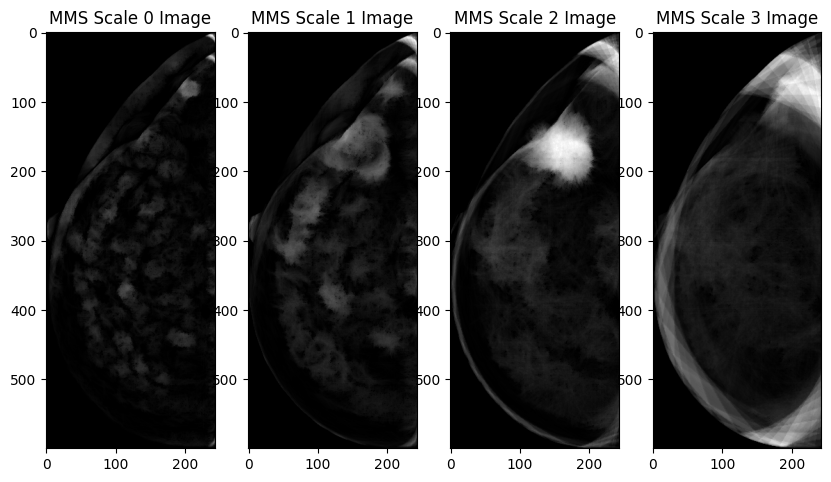

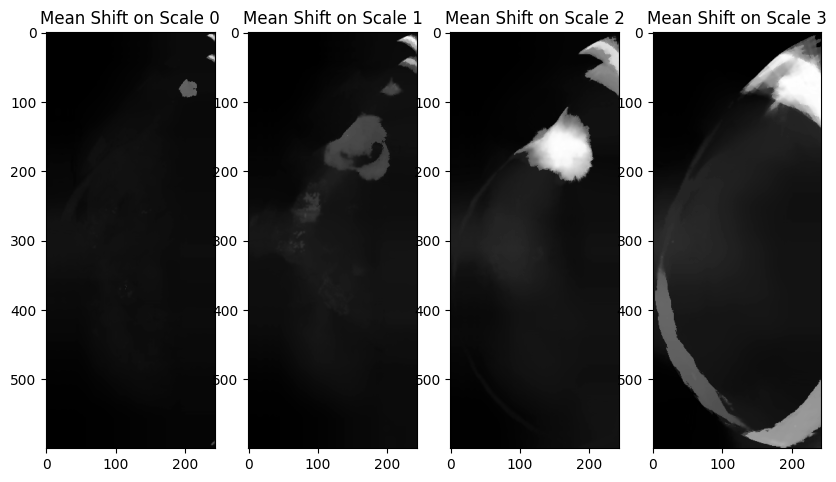

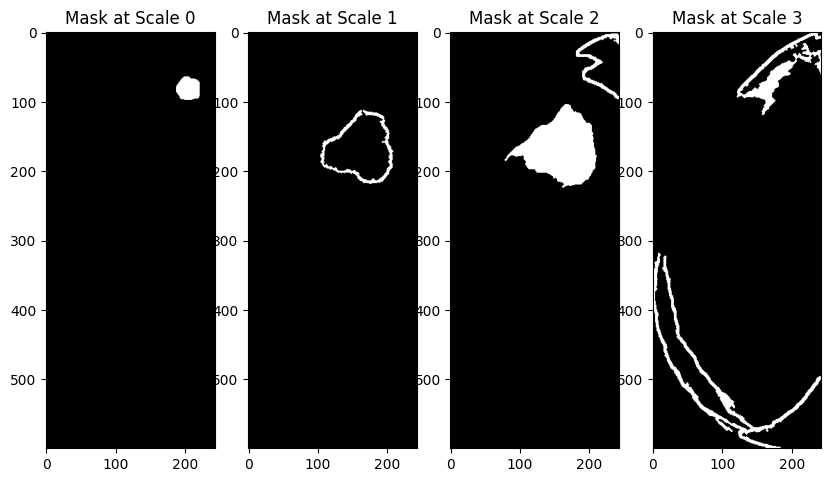

The Dice score on scale 0 0.1158573443481765
The Dice score on scale 1 0.19886255924170615
The Dice score on scale 2 0.8069706526968514
The Dice score on scale 3 0.0019228458118014662
The sensitivity on scale 0 0.06403118040089087
The sensitivity on scale 1 0.11681514476614699
The sensitivity on scale 2 0.8405345211581292
The sensitivity on scale 3 0.0017817371937639199
h: (832, 308) uint16
h: (832, 308) uint8
22579730_bbd6a3a35438c11b_MG_R_ML_ANON.tif
(4, 832, 308) int32
ms: (832, 308) uint8
(832, 308) uint8


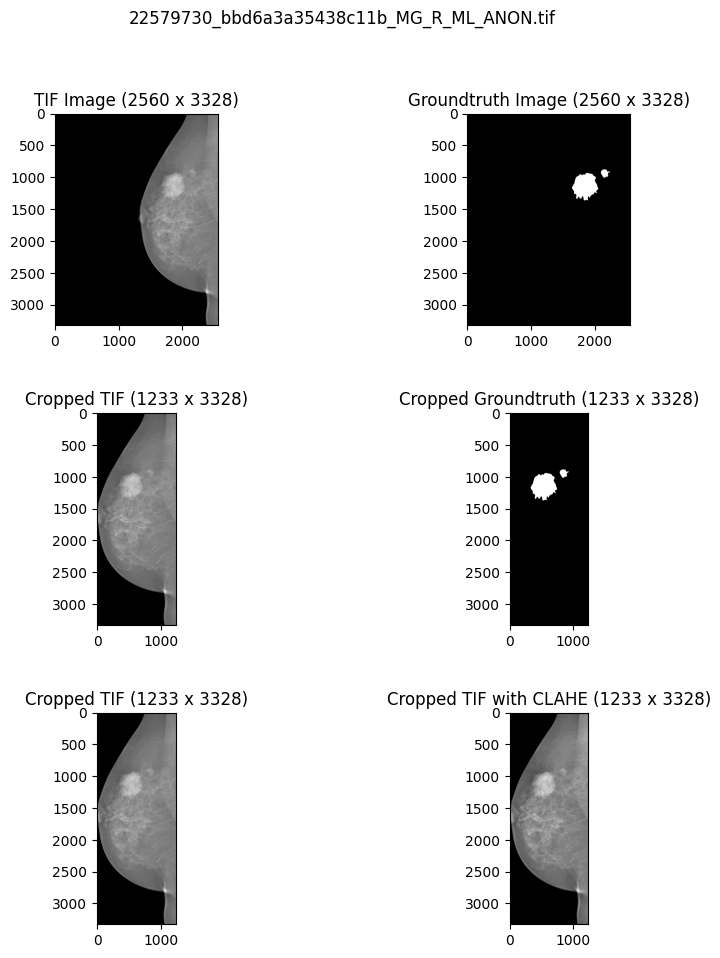

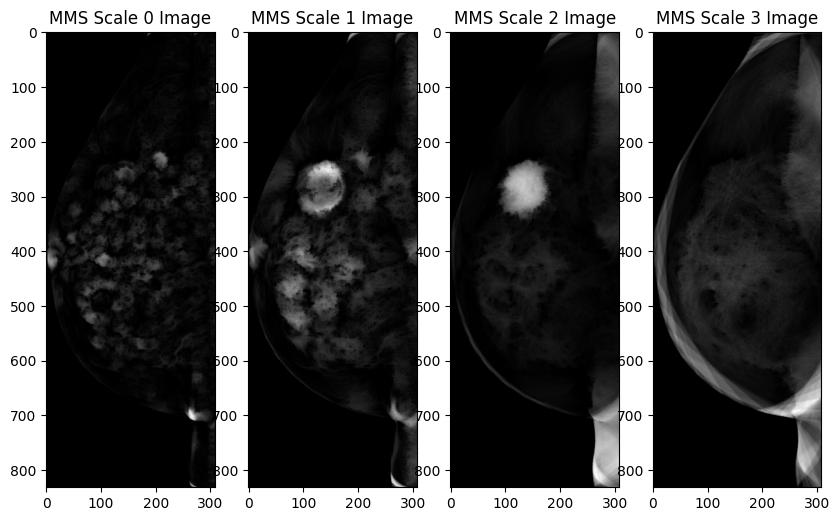

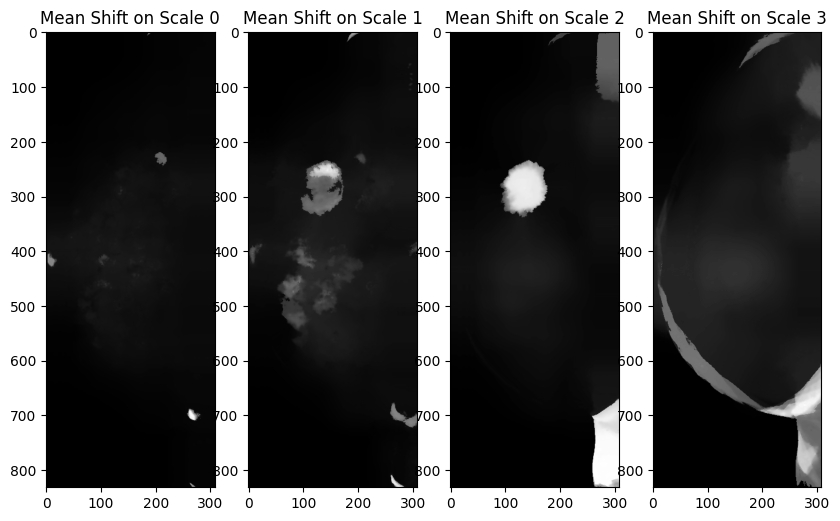

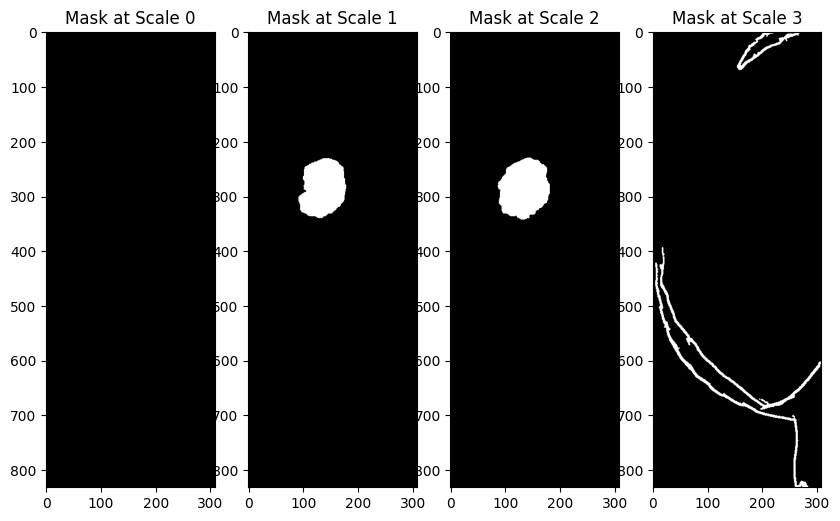

The Dice score on scale 0 0.0
The Dice score on scale 1 0.8540215933047978
The Dice score on scale 2 0.8822348000730327
The Dice score on scale 3 0.0
The sensitivity on scale 0 0.0
The sensitivity on scale 1 0.7930707166587565
The sensitivity on scale 2 0.8599905078310394
The sensitivity on scale 3 0.0
h: (676, 364) uint16
h: (676, 364) uint8
22580038_6200187f3f1ccc18_MG_L_CC_ANON.tif
(4, 676, 364) int32
ms: (676, 364) uint8
(676, 364) uint8


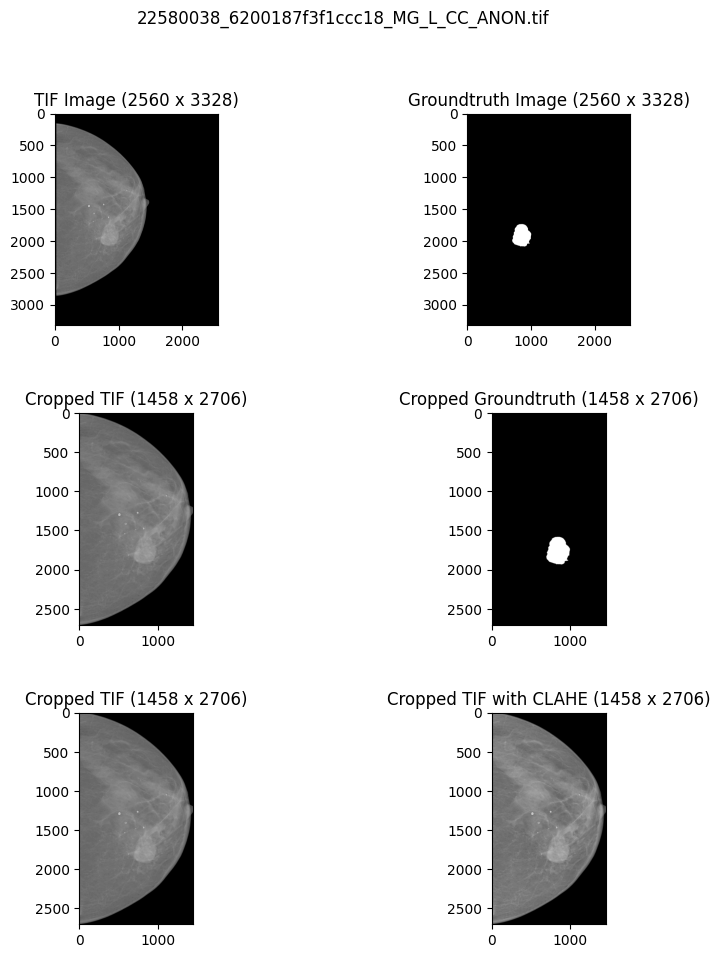

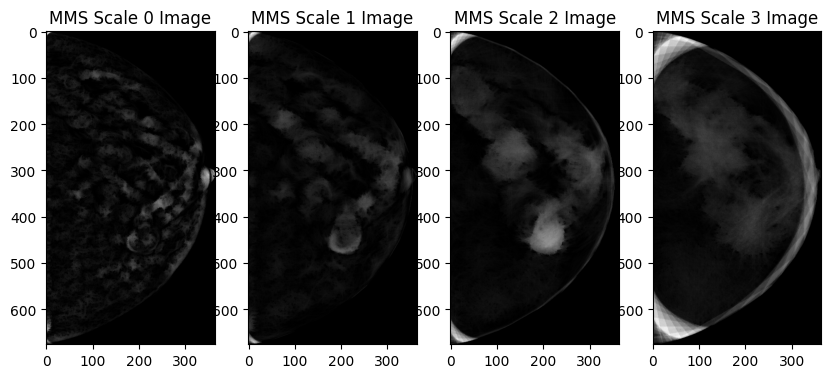

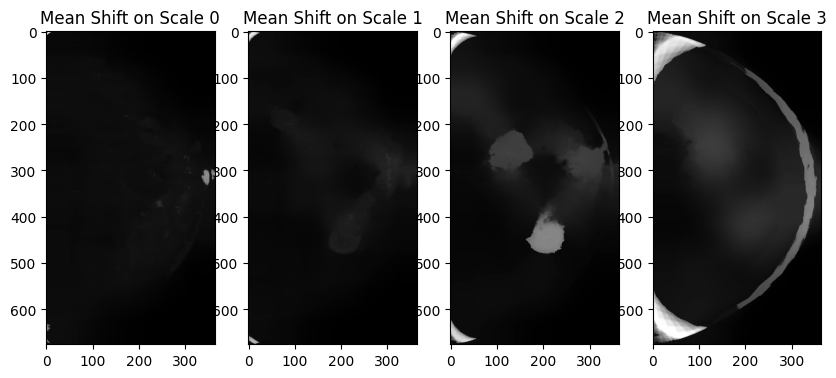

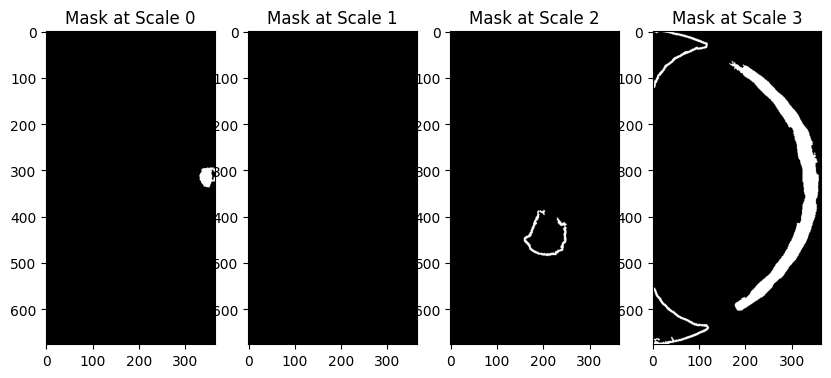

The Dice score on scale 0 0.0
The Dice score on scale 1 0.0
The Dice score on scale 2 0.08243559718969555
The Dice score on scale 3 0.0
The sensitivity on scale 0 0.0
The sensitivity on scale 1 0.0
The sensitivity on scale 2 0.052937637858431925
The sensitivity on scale 3 0.0
h: (754, 412) uint16
h: (754, 412) uint8
22580098_6200187f3f1ccc18_MG_L_ML_ANON.tif
(4, 754, 412) int32
ms: (754, 412) uint8
(754, 412) uint8


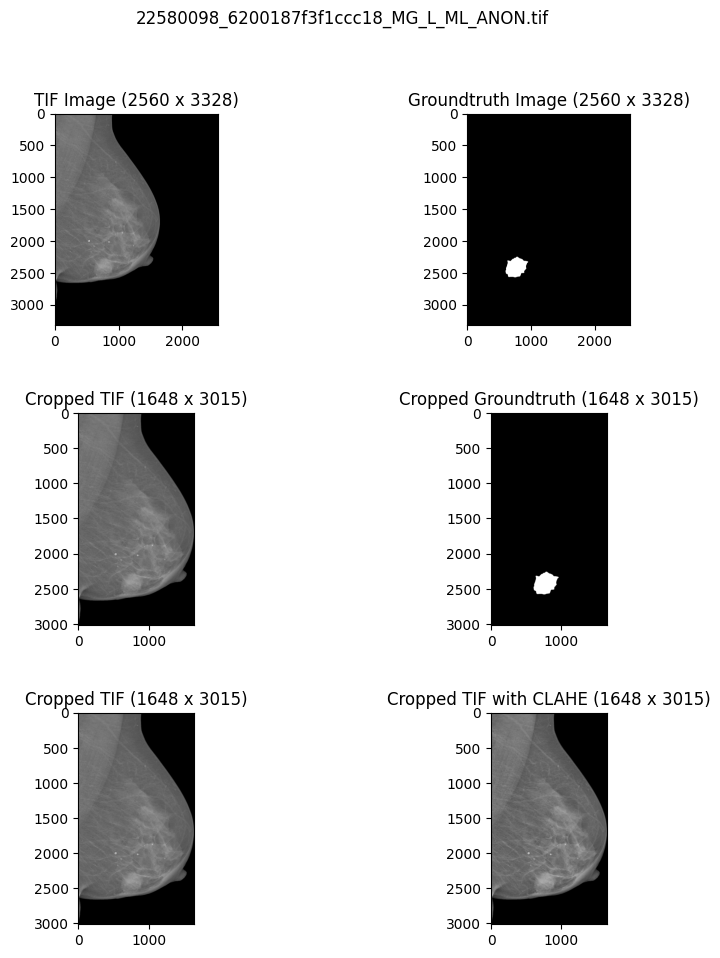

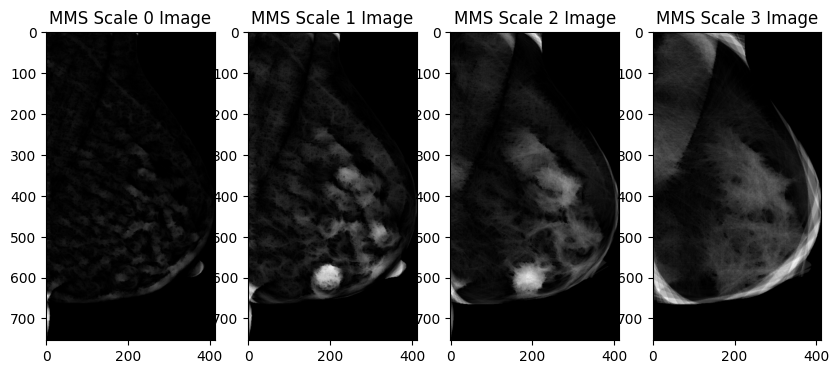

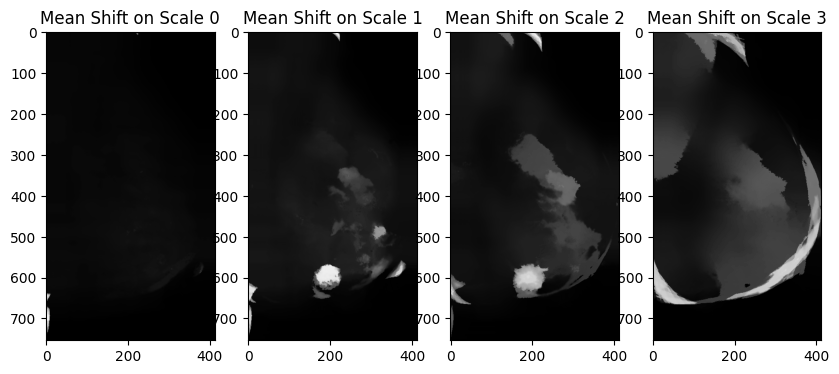

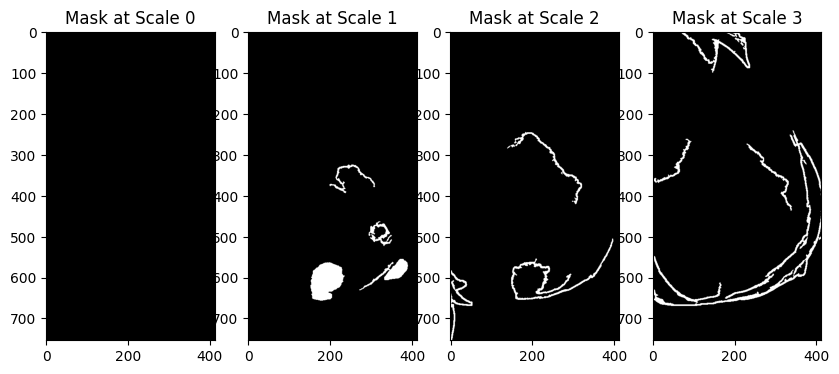

The Dice score on scale 0 0.0
The Dice score on scale 1 0.6305405585549557
The Dice score on scale 2 0.08086986068637445
The Dice score on scale 3 0.022929266368656324
The sensitivity on scale 0 0.0
The sensitivity on scale 1 0.946
The sensitivity on scale 2 0.0952
The sensitivity on scale 3 0.0436
h: (679, 384) uint16
h: (679, 384) uint8
22580192_5530d5782fc89dd7_MG_R_CC_ANON.tif
(4, 679, 384) int32
ms: (679, 384) uint8
(679, 384) uint8


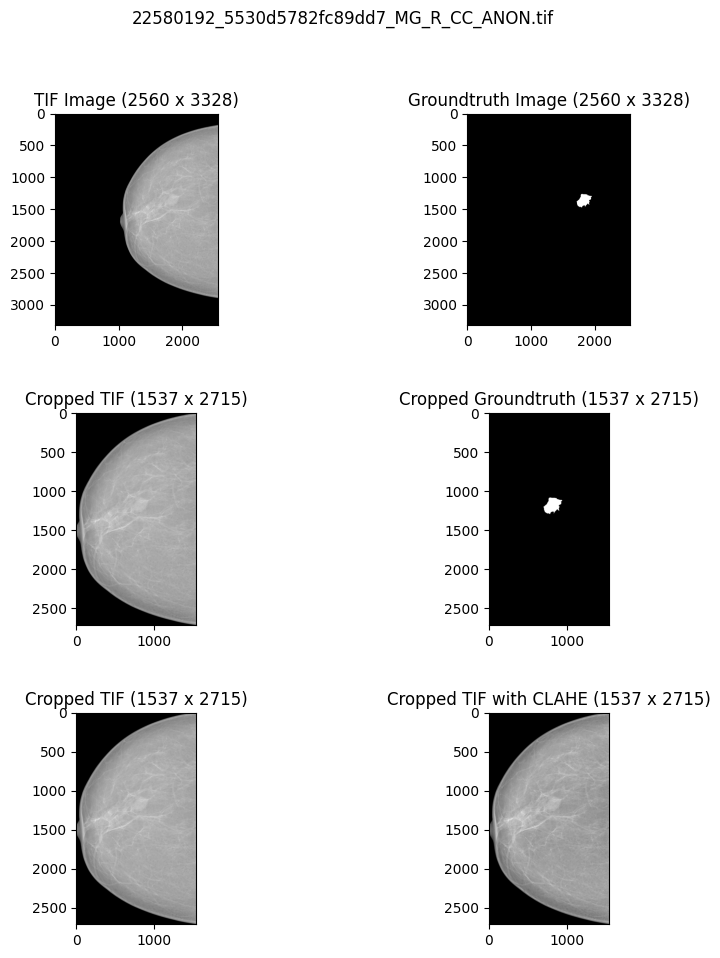

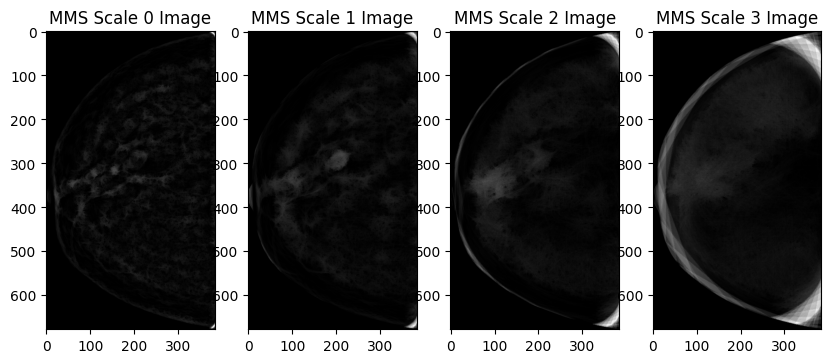

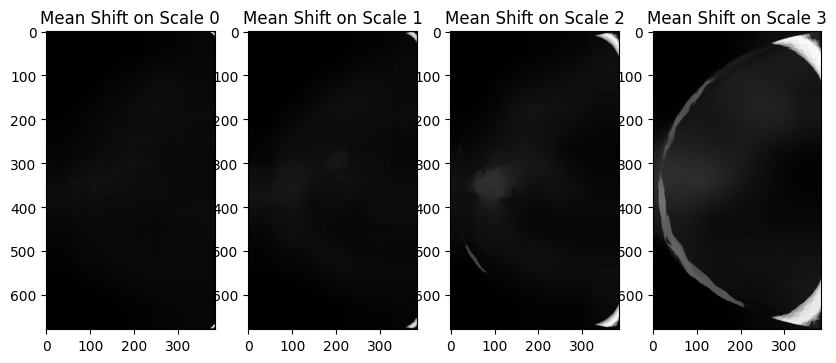

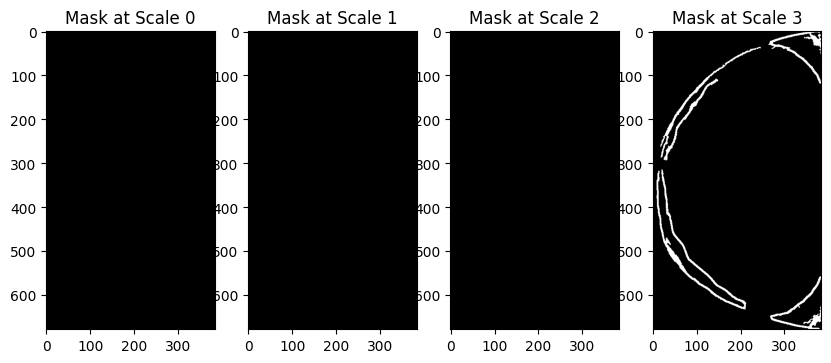

The Dice score on scale 0 0.0
The Dice score on scale 1 0.0
The Dice score on scale 2 0.0
The Dice score on scale 3 0.0
The sensitivity on scale 0 0.0
The sensitivity on scale 1 0.0
The sensitivity on scale 2 0.0
The sensitivity on scale 3 0.0
h: (717, 433) uint16
h: (717, 433) uint8
22580244_5530d5782fc89dd7_MG_R_ML_ANON.tif
(4, 717, 433) int32
ms: (717, 433) uint8
(717, 433) uint8


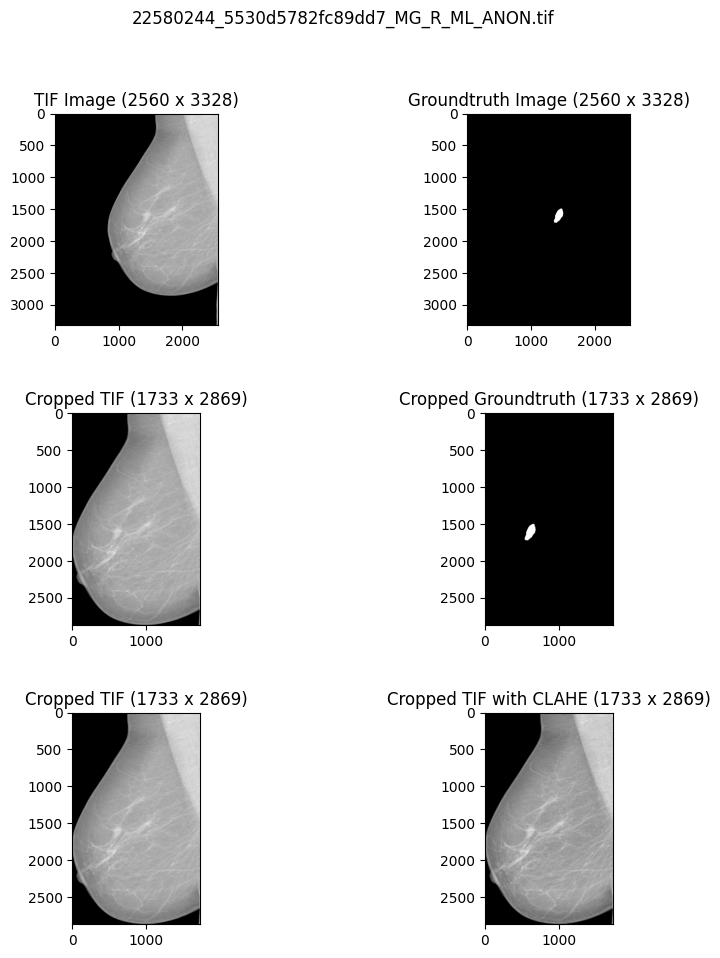

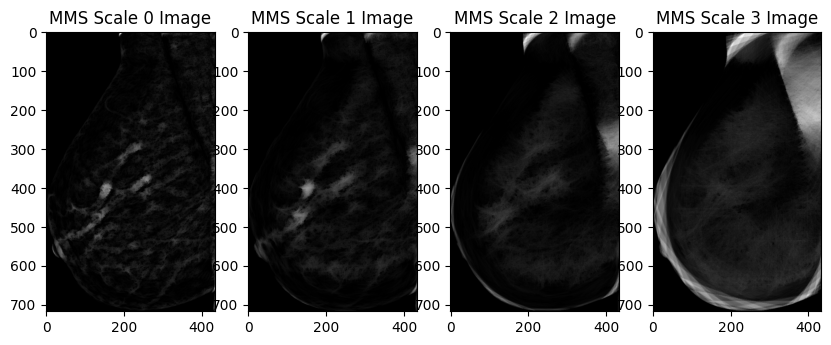

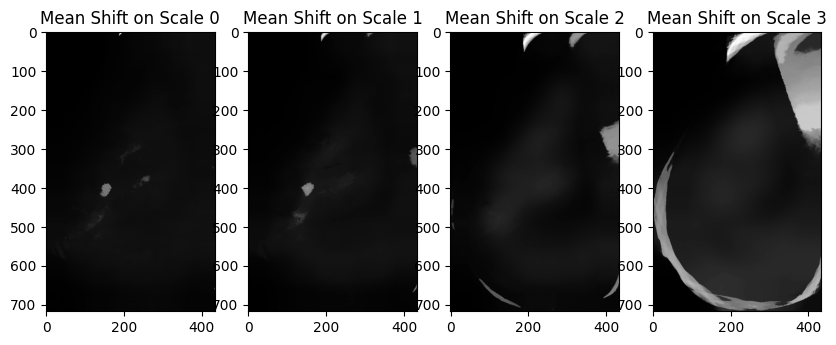

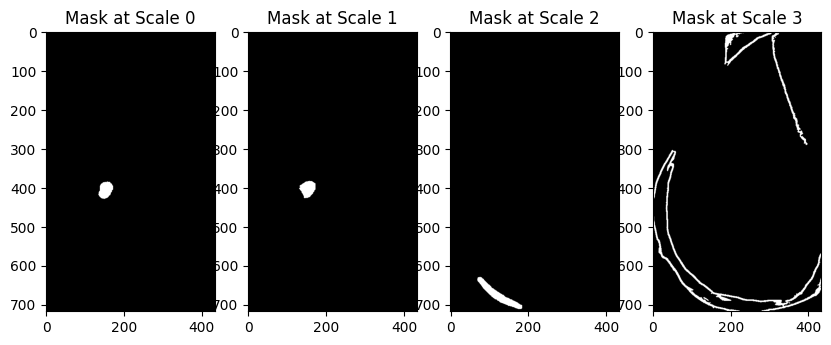

The Dice score on scale 0 0.8206349206349206
The Dice score on scale 1 0.7927441142416055
The Dice score on scale 2 0.0
The Dice score on scale 3 0.0
The sensitivity on scale 0 0.8003095975232198
The sensitivity on scale 1 0.794891640866873
The sensitivity on scale 2 0.0
The sensitivity on scale 3 0.0
h: (671, 282) uint16
h: (671, 282) uint8
22580341_5eae9beae14d26fd_MG_R_CC_ANON.tif
(4, 671, 282) int32
ms: (671, 282) uint8
(671, 282) uint8


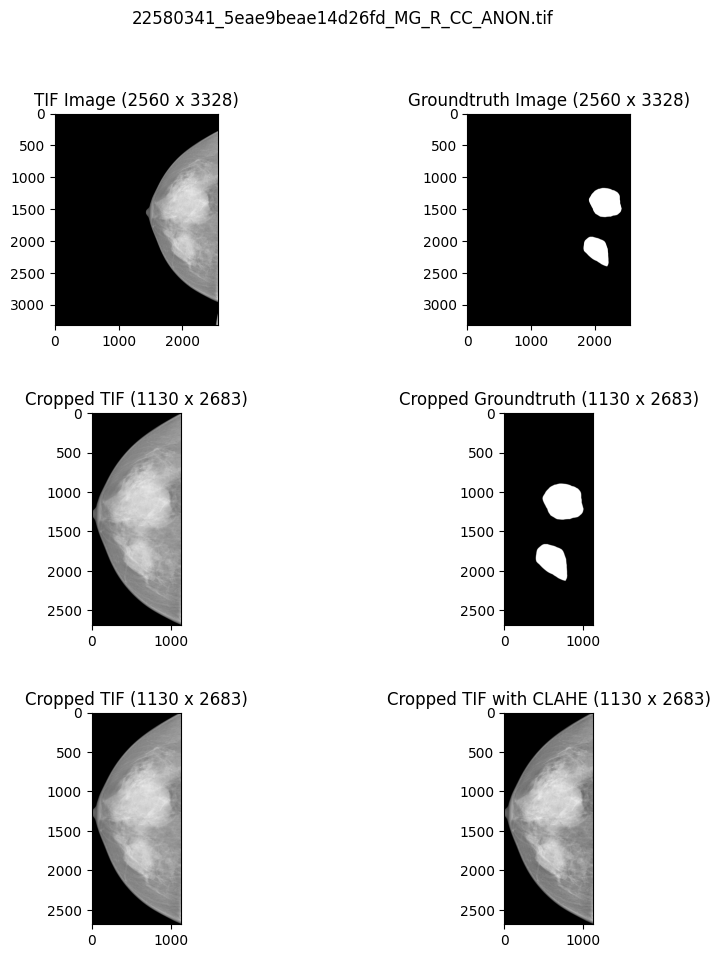

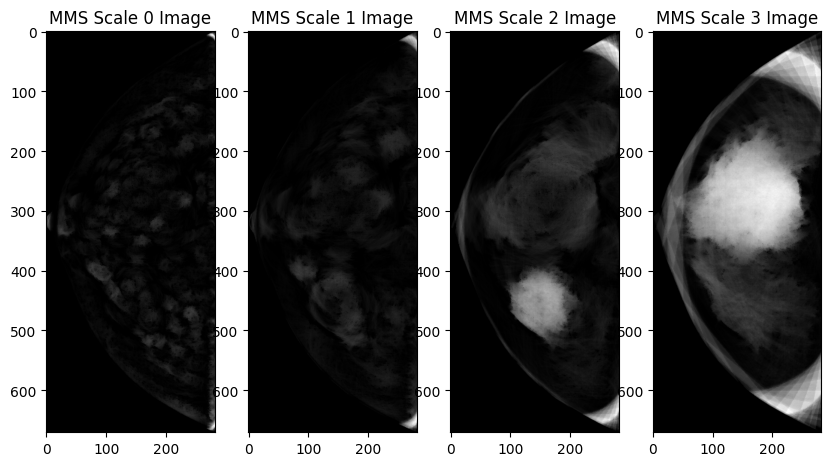

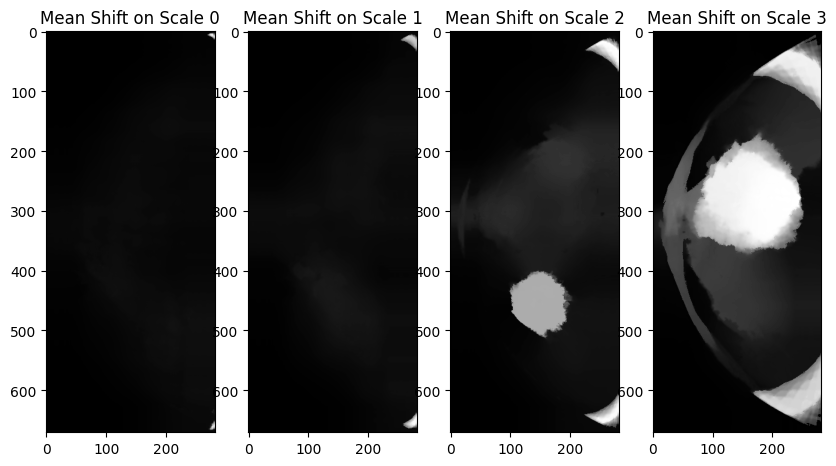

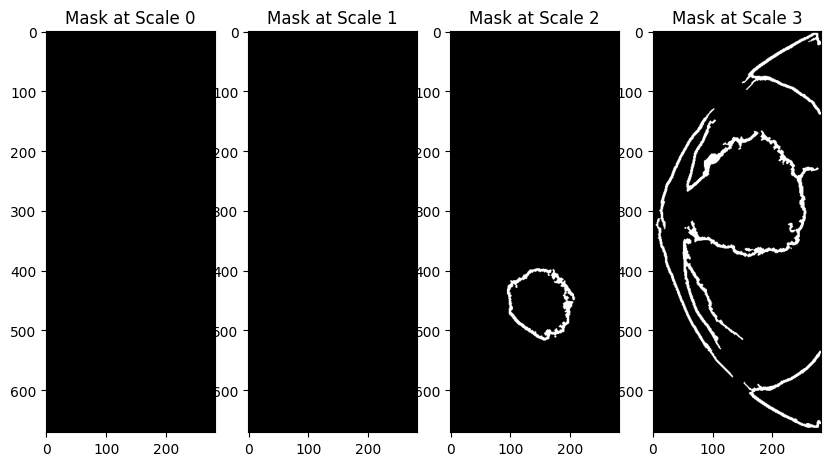

The Dice score on scale 0 0.0
The Dice score on scale 1 0.0
The Dice score on scale 2 0.0622303809086737
The Dice score on scale 3 0.005228270002800859
The sensitivity on scale 0 0.0
The sensitivity on scale 1 0.0
The sensitivity on scale 2 0.03497730086669418
The sensitivity on scale 3 0.004333470903838217
h: (707, 287) uint16
h: (707, 287) uint8
22580367_5eae9beae14d26fd_MG_L_CC_ANON.tif
(4, 707, 287) int32
ms: (707, 287) uint8
(707, 287) uint8


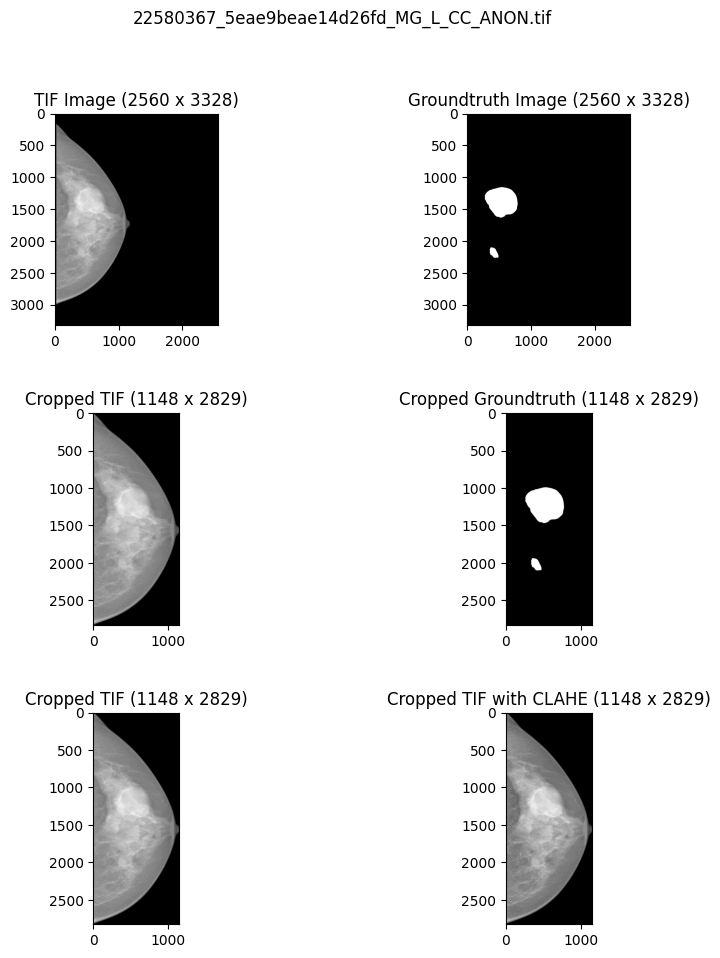

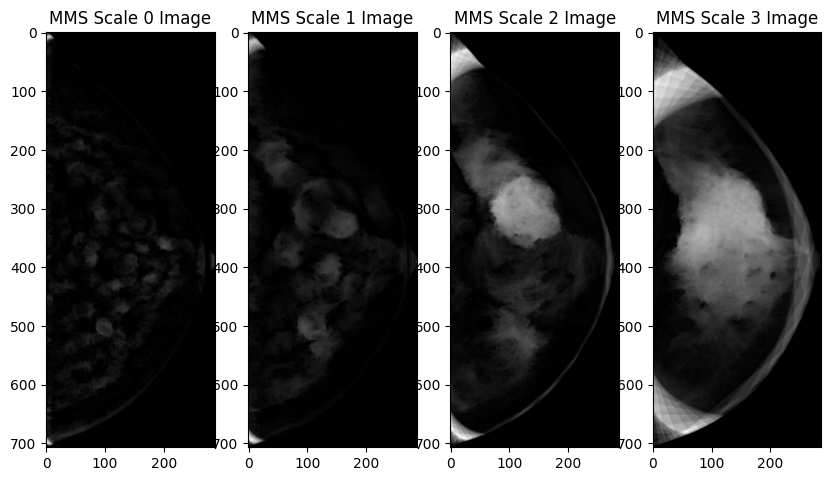

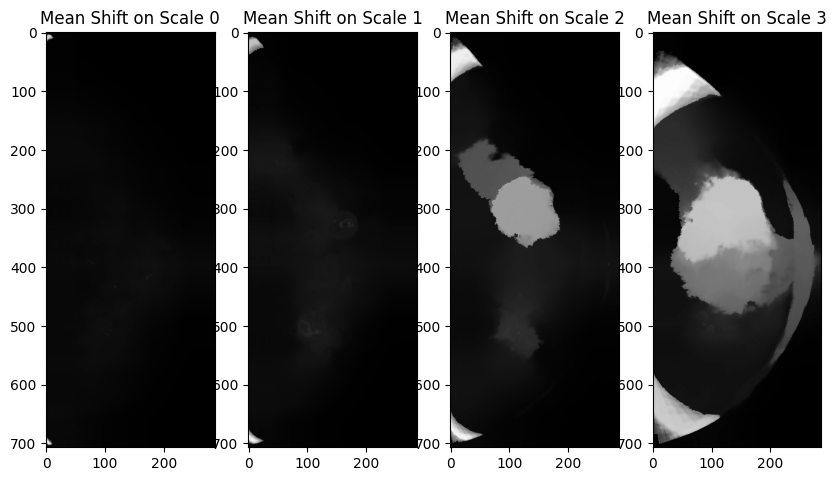

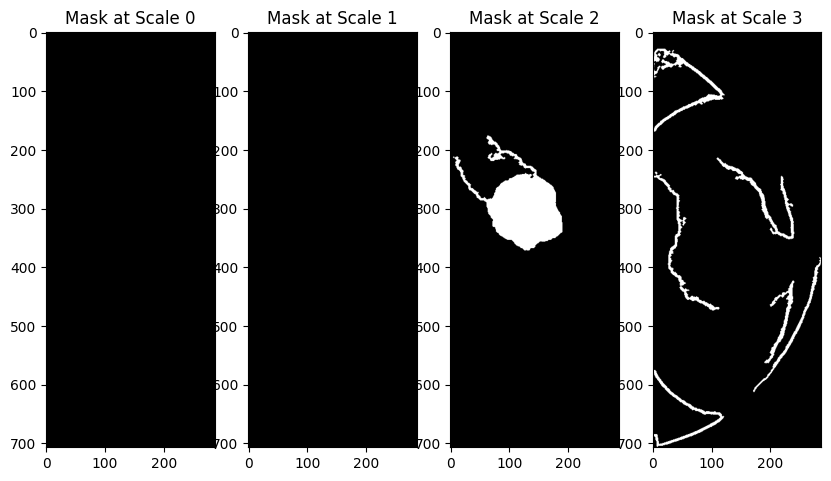

The Dice score on scale 0 0.0
The Dice score on scale 1 0.0
The Dice score on scale 2 0.839684068580235
The Dice score on scale 3 0.03675705038250871
The sensitivity on scale 0 0.0
The sensitivity on scale 1 0.0
The sensitivity on scale 2 0.8673883626522327
The sensitivity on scale 3 0.03231712170659874
h: (651, 292) uint16
h: (651, 292) uint8
22580393_5eae9beae14d26fd_MG_R_ML_ANON.tif
(4, 651, 292) int32
ms: (651, 292) uint8
(651, 292) uint8


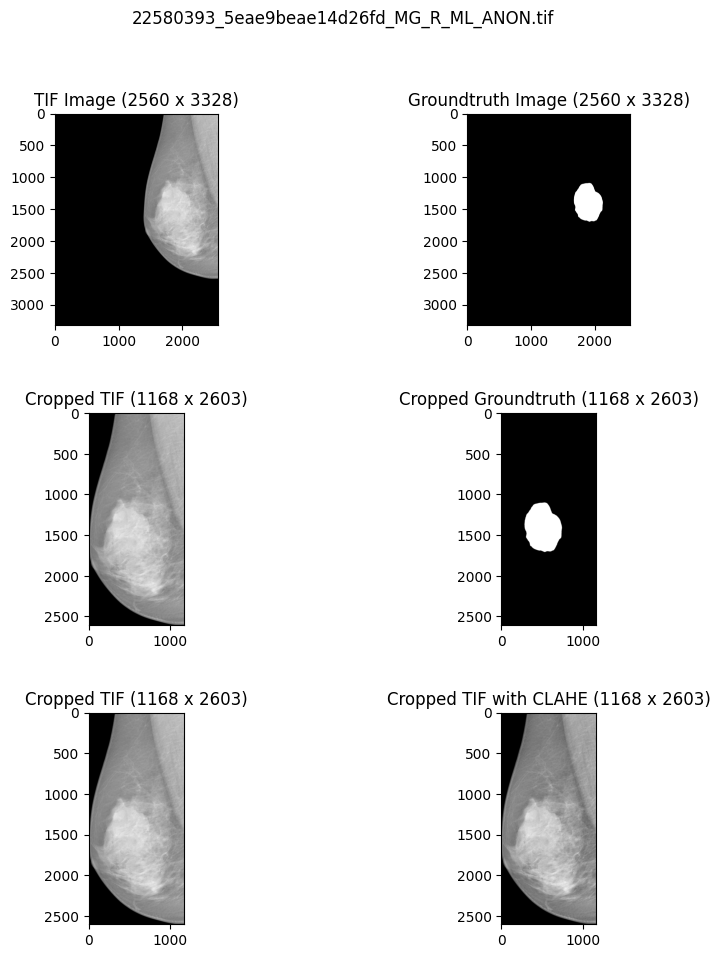

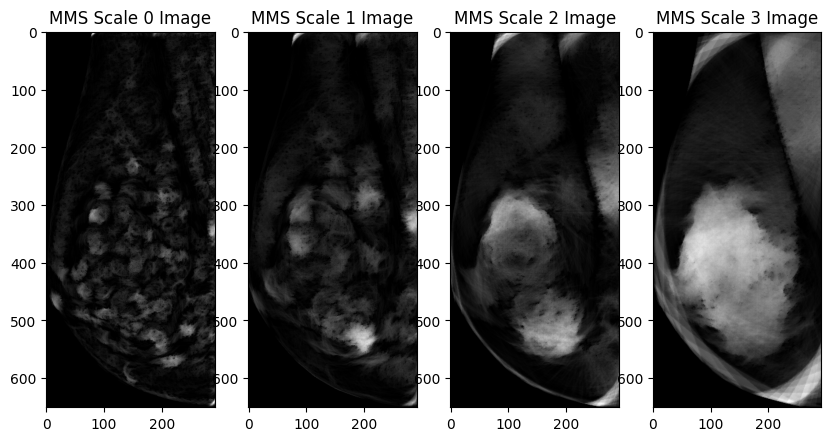

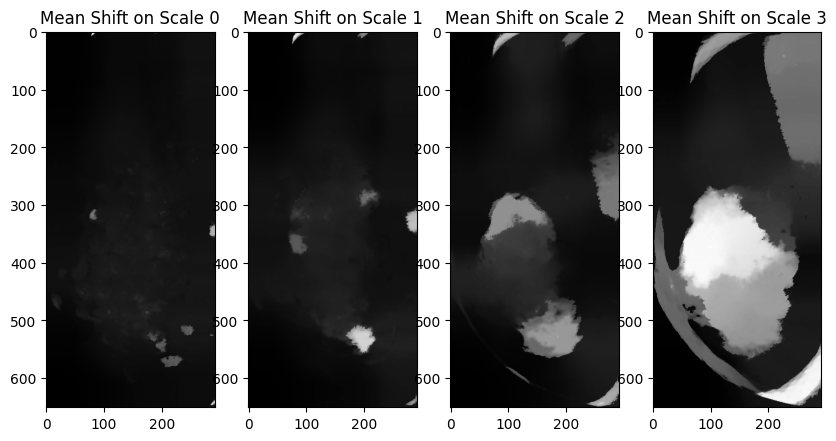

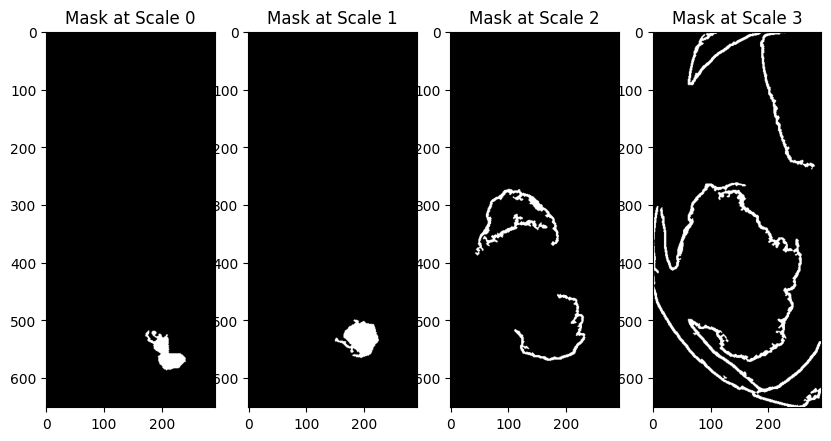

The Dice score on scale 0 0.0
The Dice score on scale 1 0.0
The Dice score on scale 2 0.18979861150955304
The Dice score on scale 3 0.027851964898893553
The sensitivity on scale 0 0.0
The sensitivity on scale 1 0.0
The sensitivity on scale 2 0.12622100122100122
The sensitivity on scale 3 0.027854090354090356
h: (692, 292) uint16
h: (692, 292) uint8
22580419_5eae9beae14d26fd_MG_L_ML_ANON.tif
(4, 692, 292) int32
ms: (692, 292) uint8
(692, 292) uint8


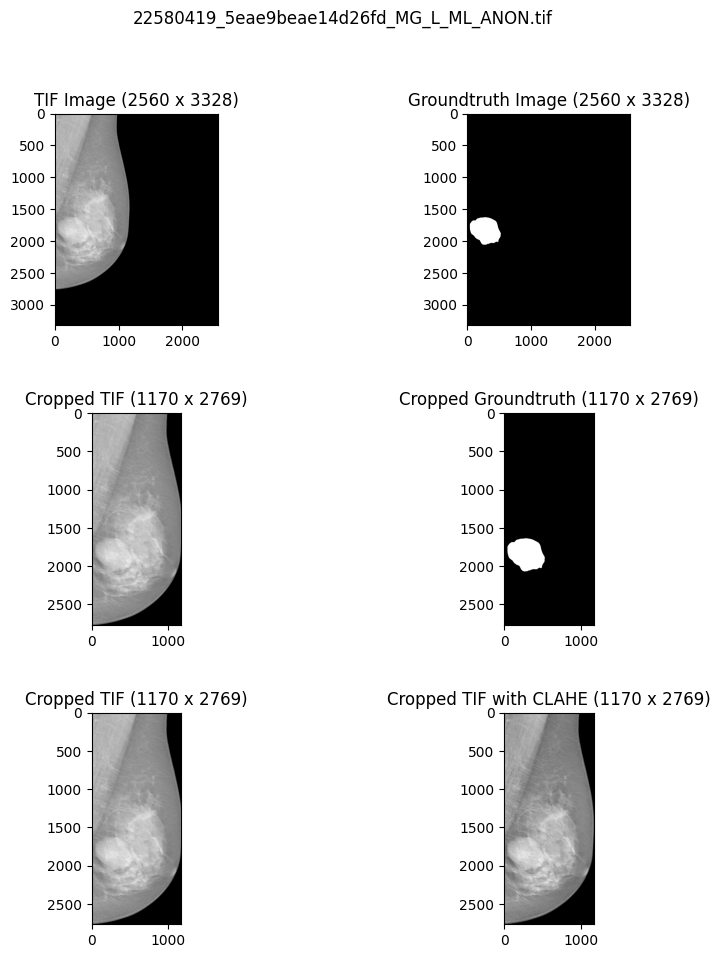

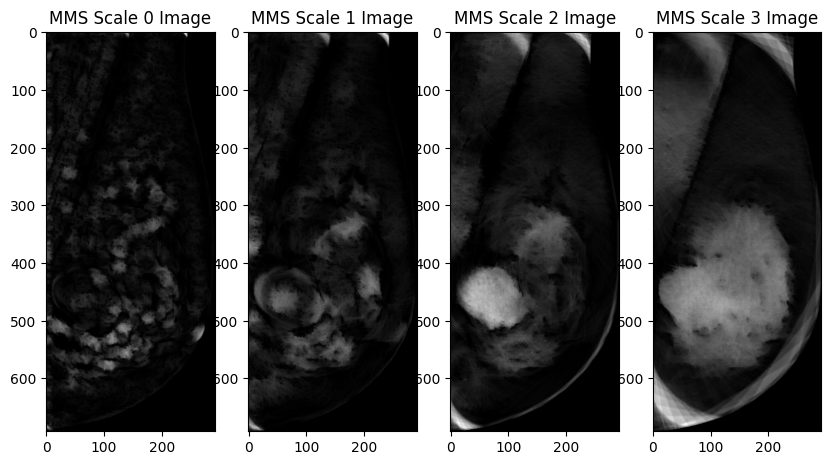

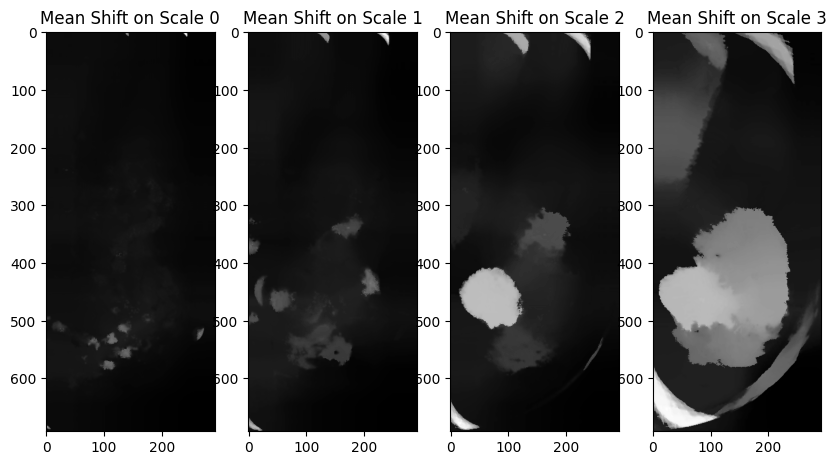

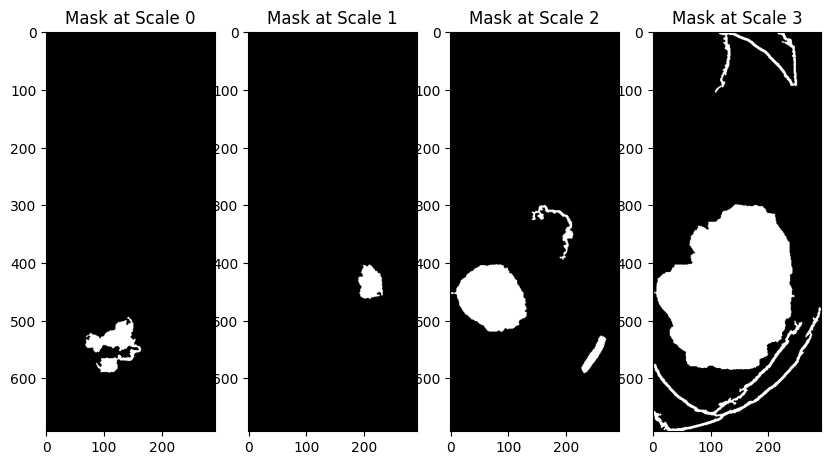

The Dice score on scale 0 0.0
The Dice score on scale 1 0.0
The Dice score on scale 2 0.8607617759747577
The Dice score on scale 3 0.3012711409601791
The sensitivity on scale 0 0.0
The sensitivity on scale 1 0.0
The sensitivity on scale 2 0.9719055374592834
The sensitivity on scale 3 1.0
h: (744, 360) uint16
h: (744, 360) uint8
22580654_fe7d005dcbbfb46d_MG_R_CC_ANON.tif
(4, 744, 360) int32
ms: (744, 360) uint8
(744, 360) uint8


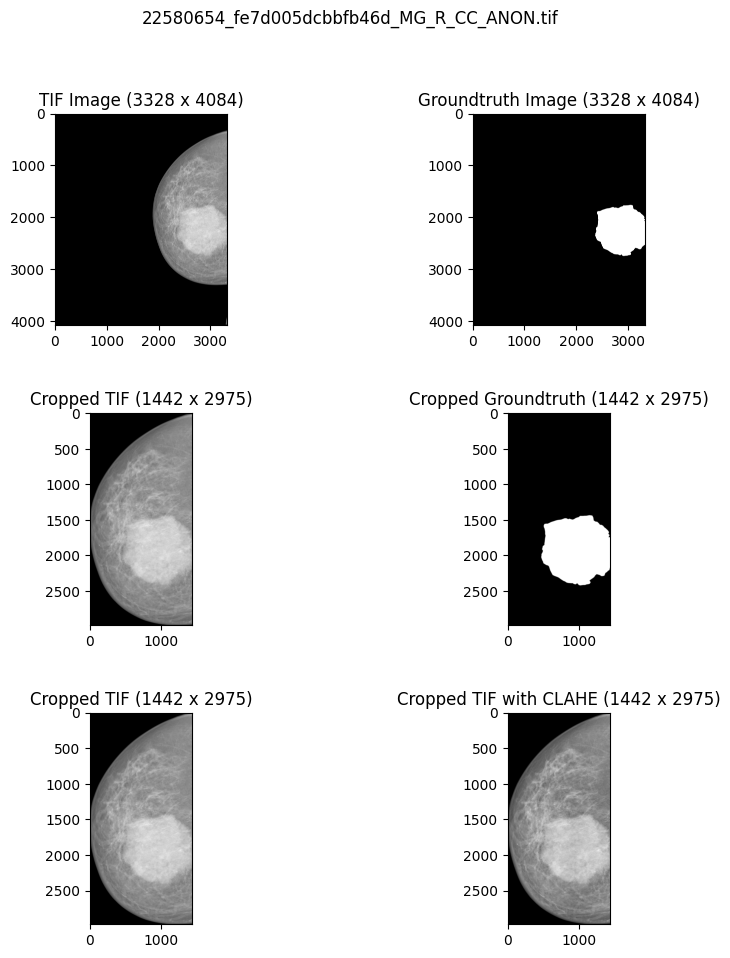

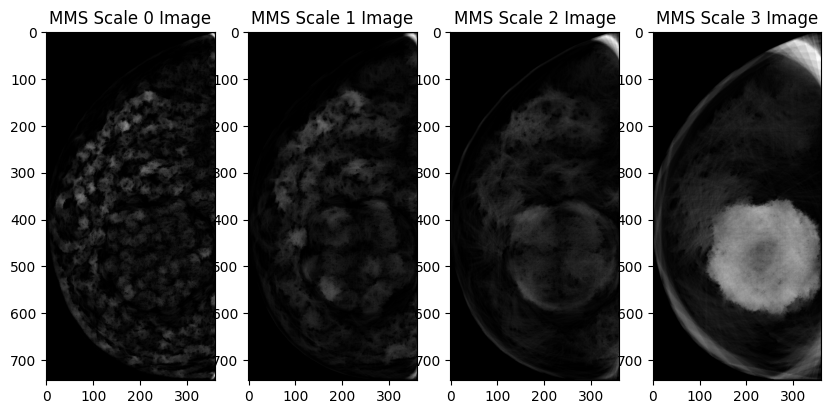

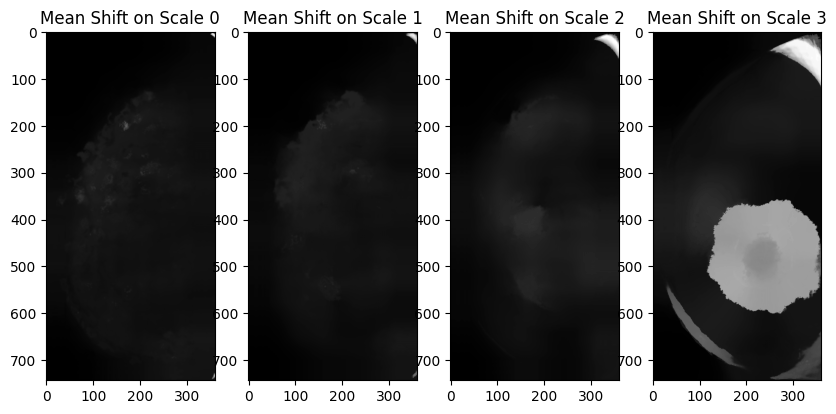

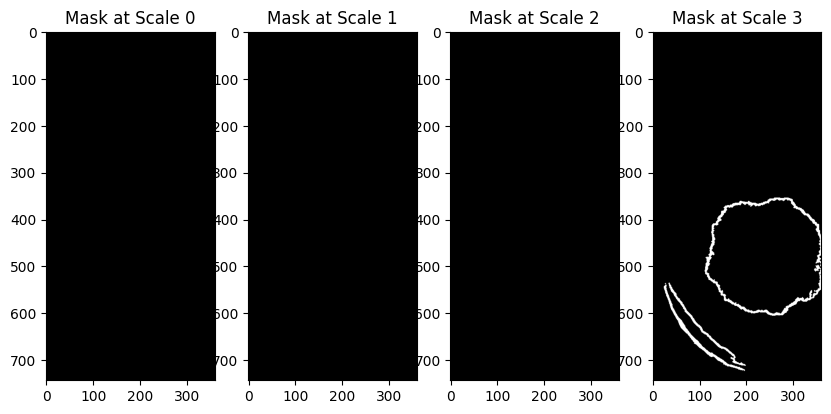

The Dice score on scale 0 0.0
The Dice score on scale 1 0.0
The Dice score on scale 2 0.0
The Dice score on scale 3 0.07534271481037053
The sensitivity on scale 0 0.0
The sensitivity on scale 1 0.0
The sensitivity on scale 2 0.0
The sensitivity on scale 3 0.04388342934598441
h: (724, 325) uint16
h: (724, 325) uint8
22580680_fe7d005dcbbfb46d_MG_L_CC_ANON.tif
(4, 724, 325) int32
ms: (724, 325) uint8
(724, 325) uint8


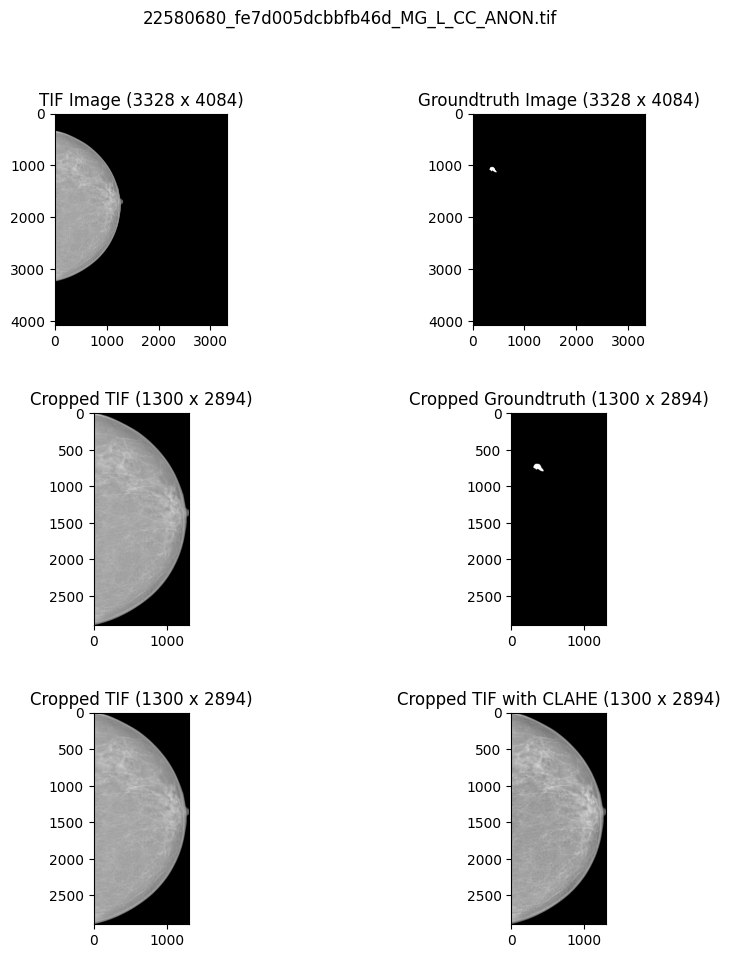

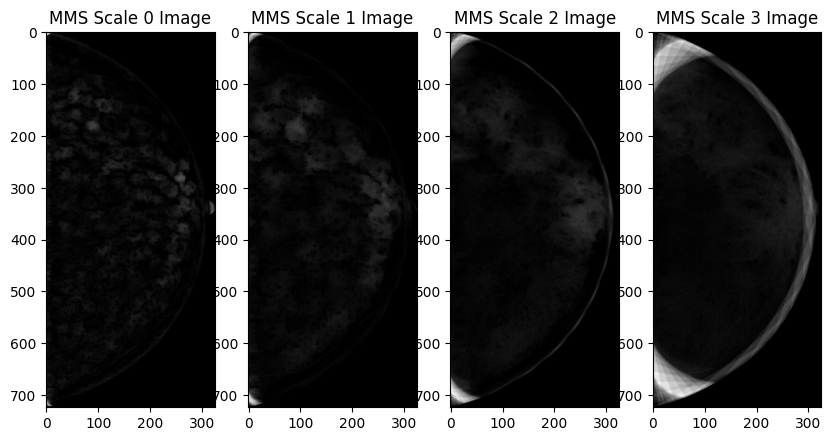

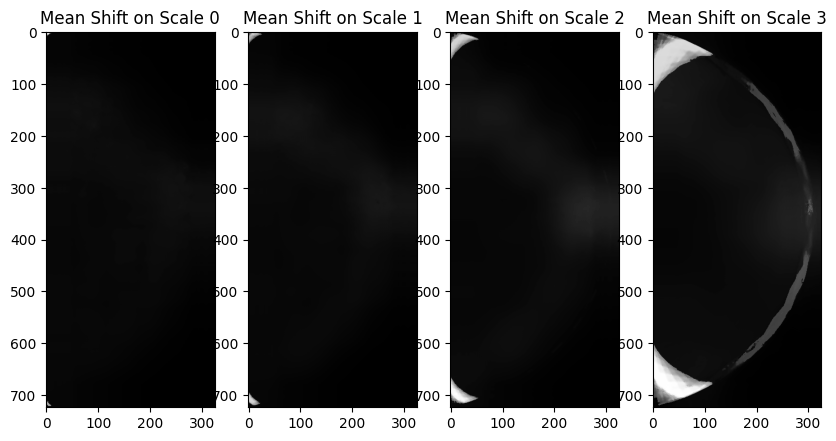

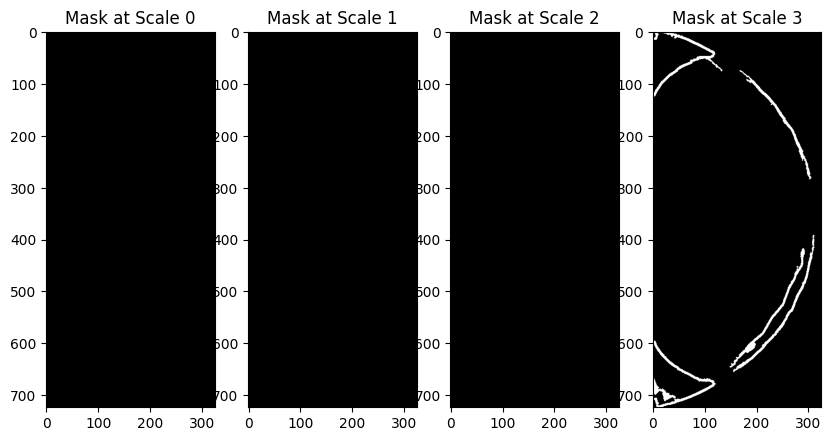

The Dice score on scale 0 0.0
The Dice score on scale 1 0.0
The Dice score on scale 2 0.0
The Dice score on scale 3 0.0
The sensitivity on scale 0 0.0
The sensitivity on scale 1 0.0
The sensitivity on scale 2 0.0
The sensitivity on scale 3 0.0
h: (995, 462) uint16
h: (995, 462) uint8
22580706_fe7d005dcbbfb46d_MG_R_ML_ANON.tif
(4, 995, 462) int32
ms: (995, 462) uint8
(995, 462) uint8


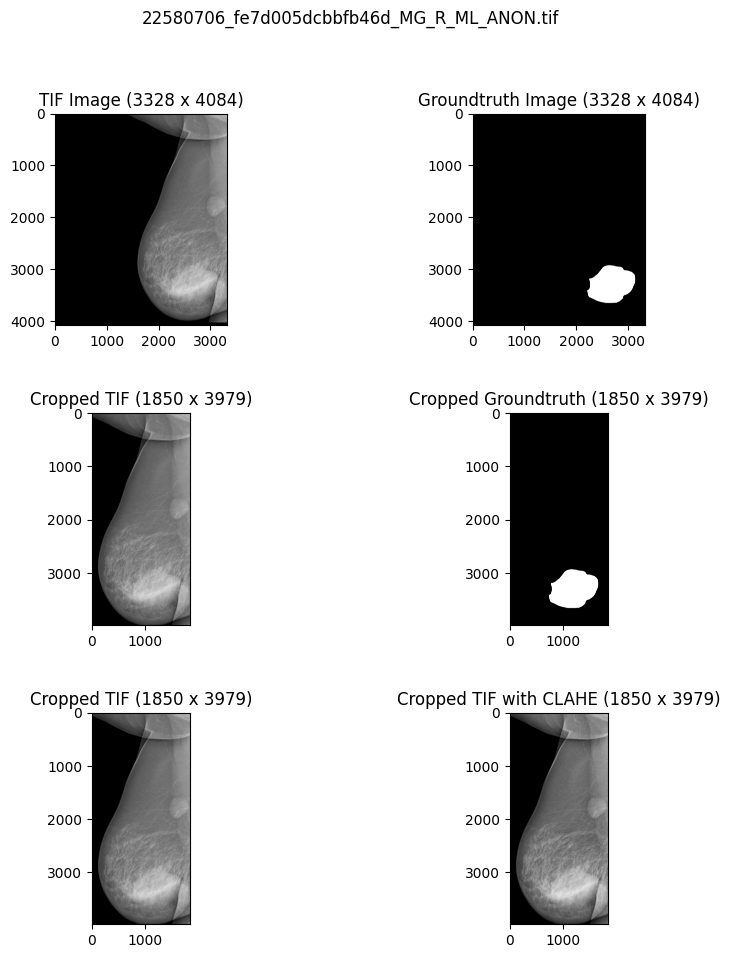

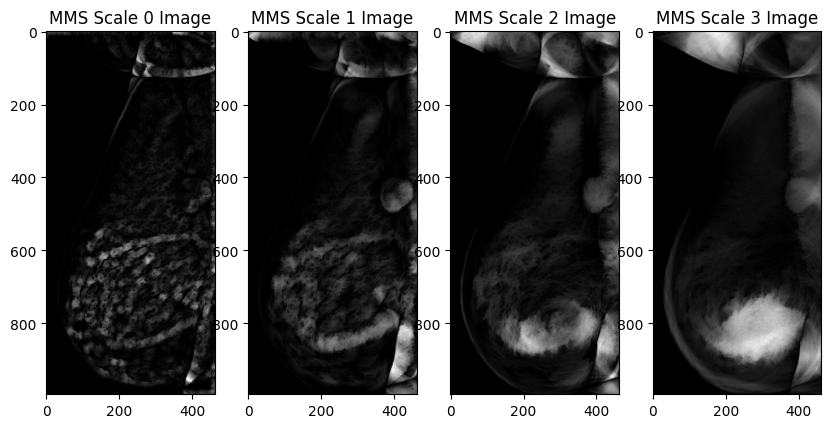

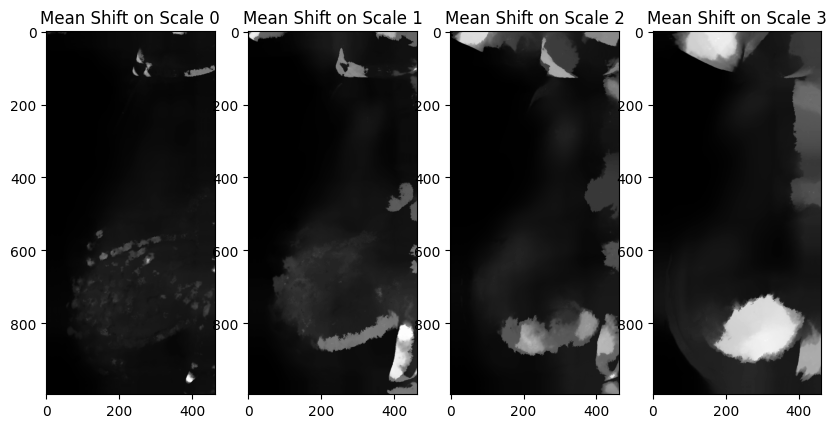

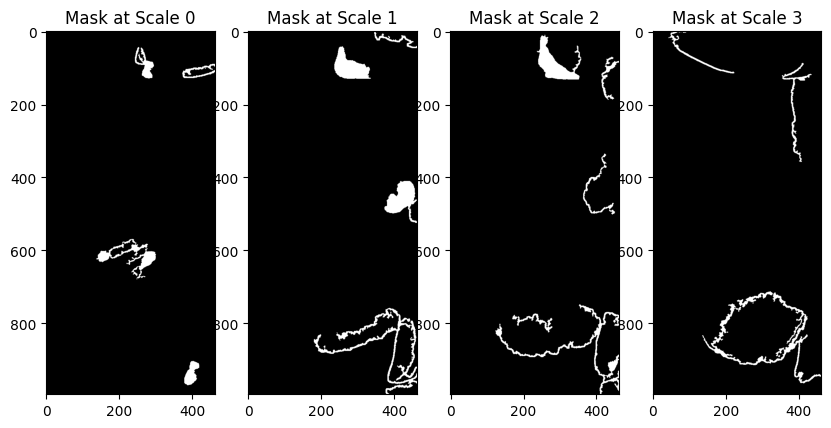

The Dice score on scale 0 0.0
The Dice score on scale 1 0.14053200534434593
The Dice score on scale 2 0.13004001893368905
The Dice score on scale 3 0.13327688001317245
The sensitivity on scale 0 0.0
The sensitivity on scale 1 0.11251215559157213
The sensitivity on scale 2 0.09795786061588331
The sensitivity on scale 3 0.09183144246353322
h: (1018, 344) uint16
h: (1018, 344) uint8
22580732_fe7d005dcbbfb46d_MG_L_ML_ANON.tif
(4, 1018, 344) int32
ms: (1018, 344) uint8
(1018, 344) uint8


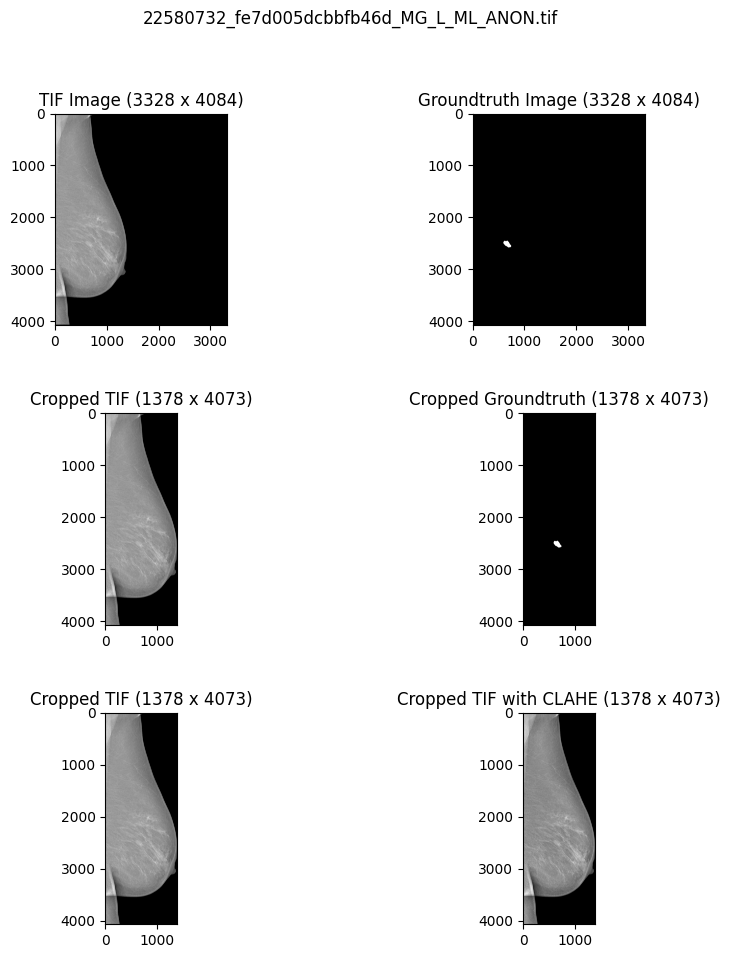

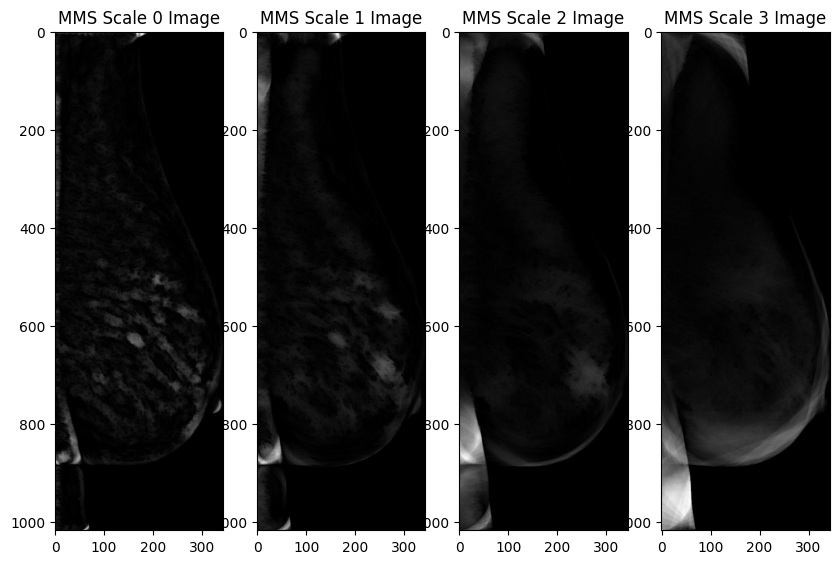

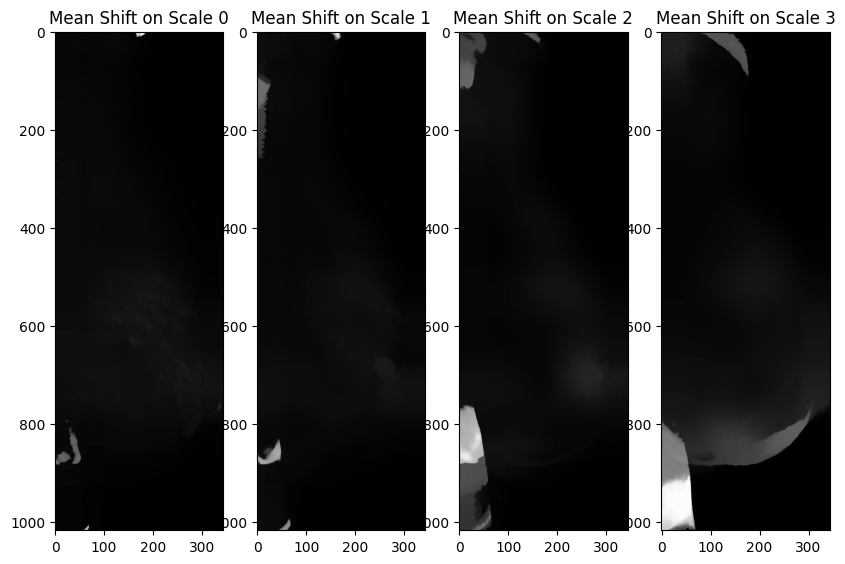

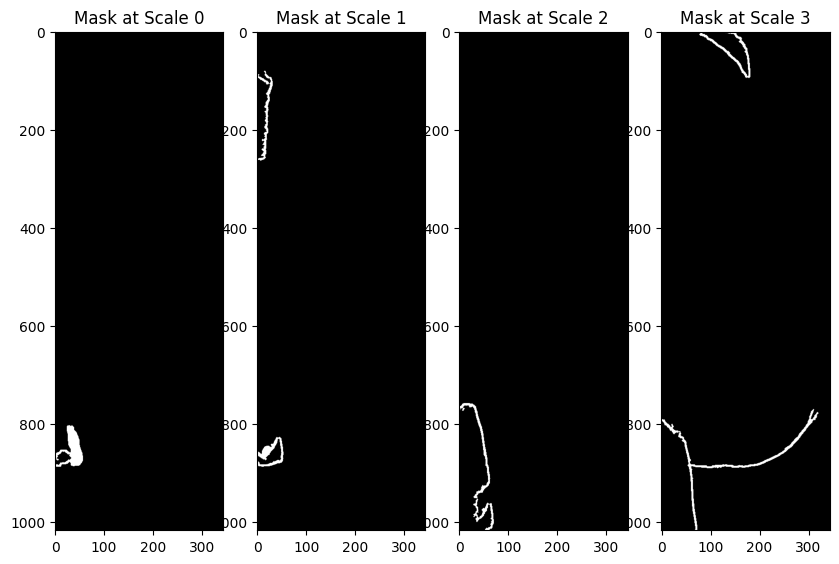

The Dice score on scale 0 0.0
The Dice score on scale 1 0.0
The Dice score on scale 2 0.0
The Dice score on scale 3 0.0
The sensitivity on scale 0 0.0
The sensitivity on scale 1 0.0
The sensitivity on scale 2 0.0
The sensitivity on scale 3 0.0
h: (650, 373) uint16
h: (650, 373) uint8
22613650_dcafa6ba6374ec07_MG_L_CC_ANON.tif
(4, 650, 373) int32
ms: (650, 373) uint8
(650, 373) uint8


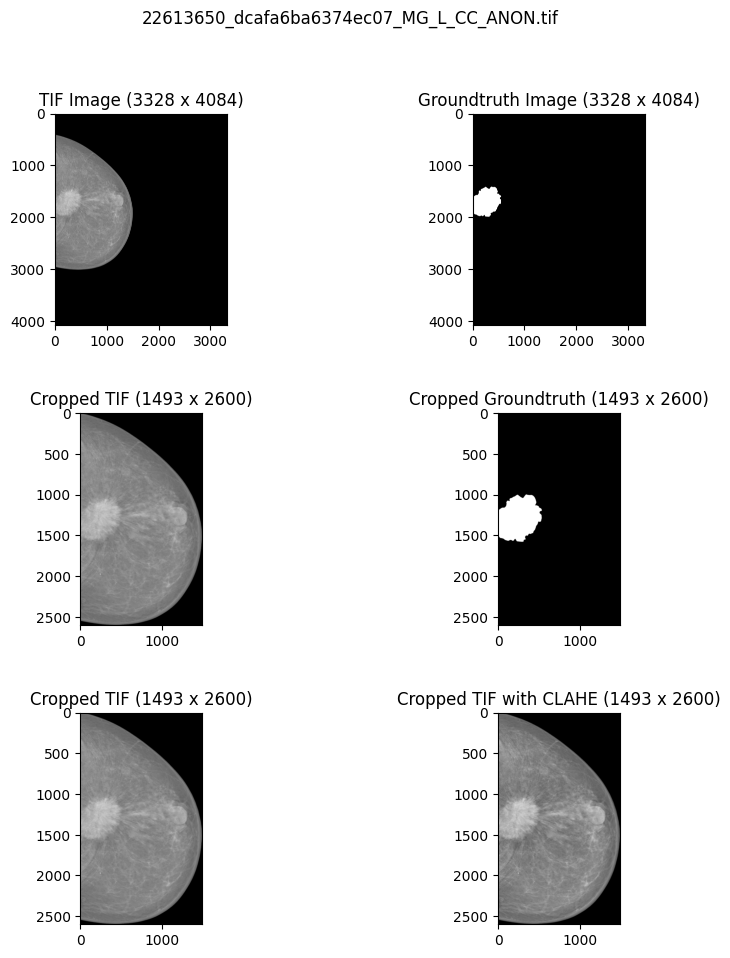

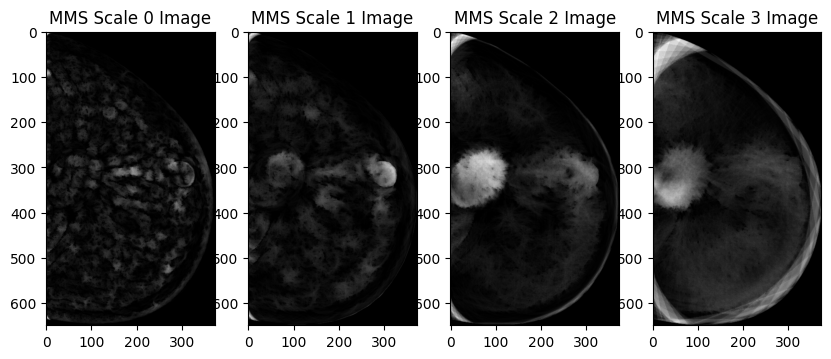

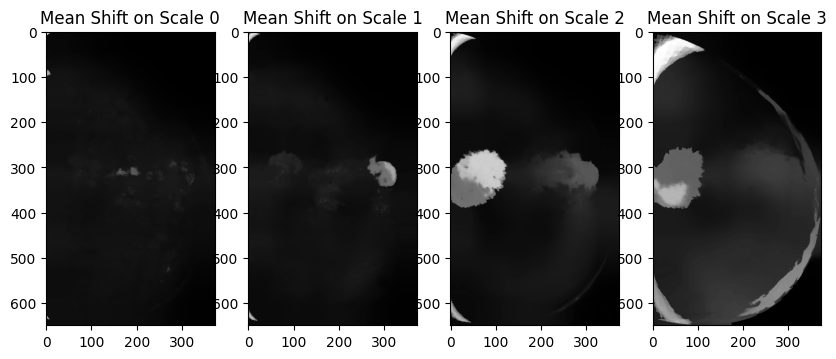

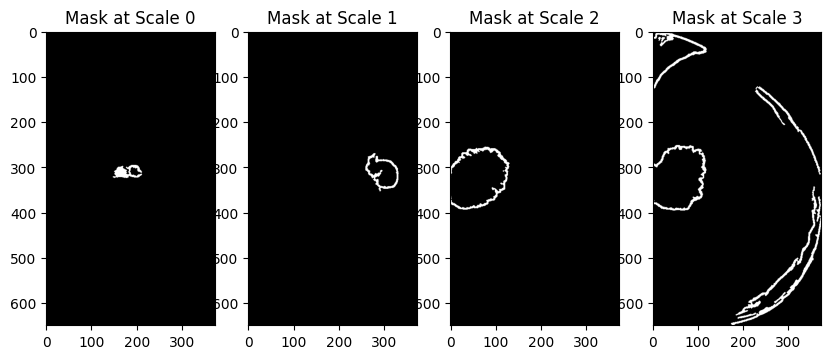

The Dice score on scale 0 0.0
The Dice score on scale 1 0.0
The Dice score on scale 2 0.22549363243369552
The Dice score on scale 3 0.11712856348765187
The sensitivity on scale 0 0.0
The sensitivity on scale 1 0.0
The sensitivity on scale 2 0.1310874142498132
The sensitivity on scale 3 0.10018338653806969
h: (839, 389) uint16
h: (839, 389) uint8
22613702_dcafa6ba6374ec07_MG_L_ML_ANON.tif
(4, 839, 389) int32
ms: (839, 389) uint8
(839, 389) uint8


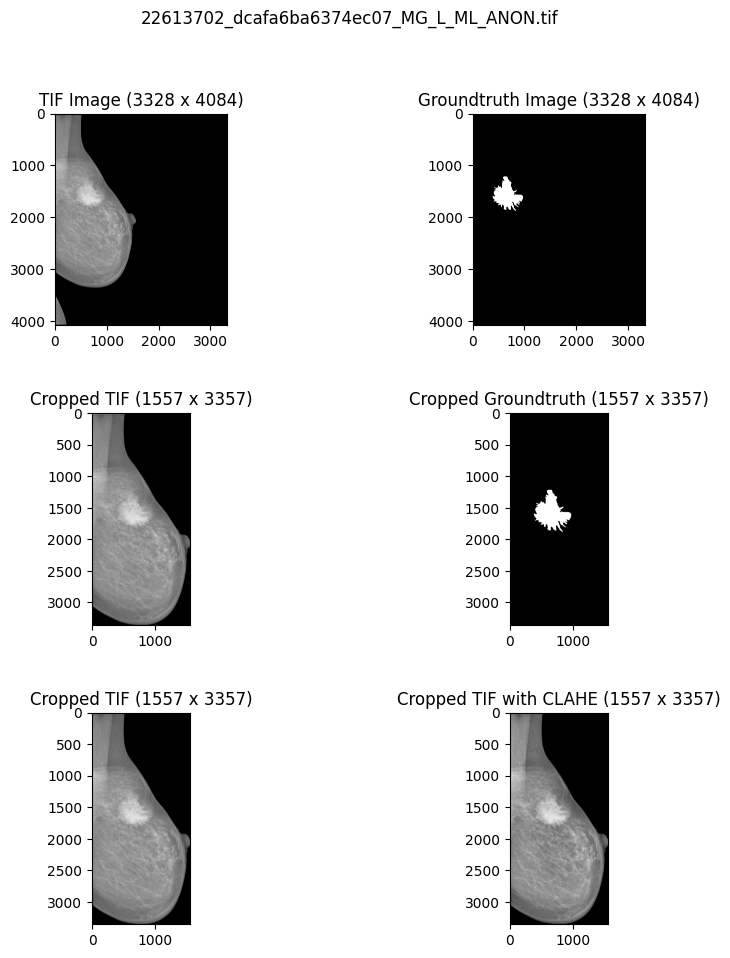

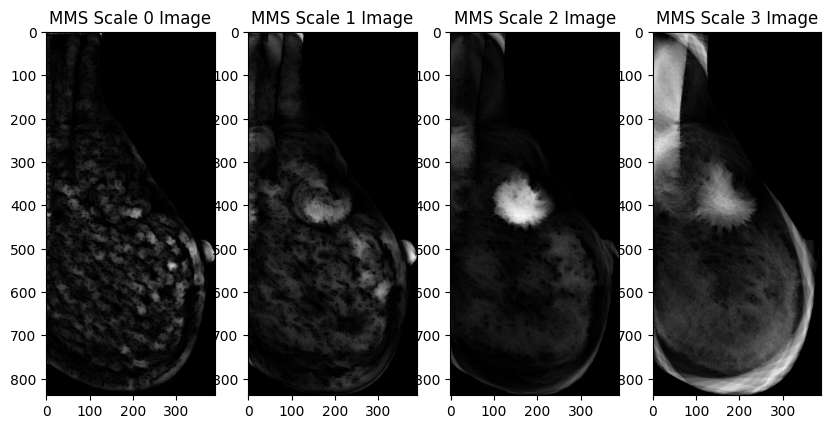

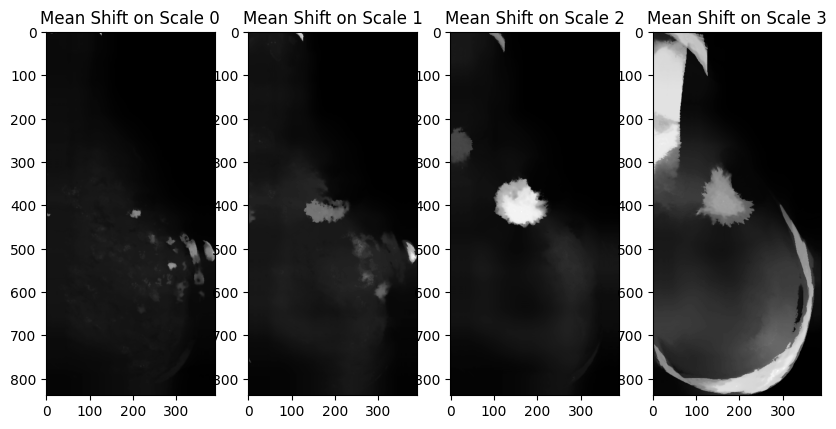

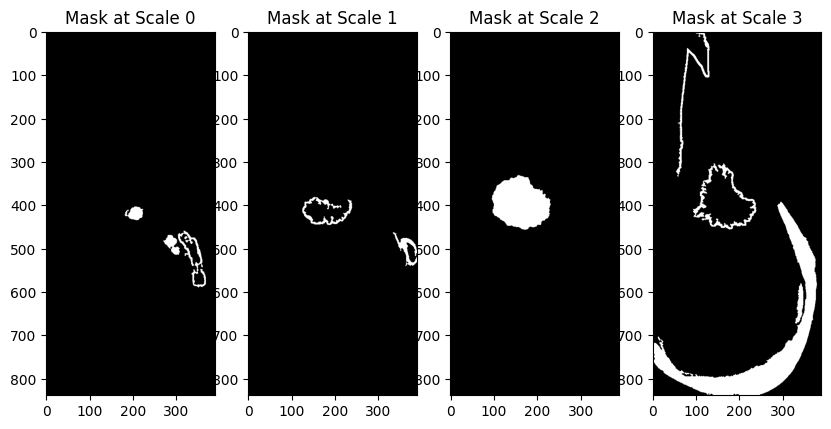

The Dice score on scale 0 0.10783699059561129
The Dice score on scale 1 0.2033395654696667
The Dice score on scale 2 0.8655973225582629
The Dice score on scale 3 0.09186477644492912
The sensitivity on scale 0 0.06891577850789327
The sensitivity on scale 1 0.12637230547319497
The sensitivity on scale 2 0.8497475759275583
The sensitivity on scale 3 0.16876352271816653
h: (698, 382) uint16
h: (698, 382) uint8
22613770_45c7f44839fd9e68_MG_R_CC_ANON.tif
(4, 698, 382) int32
ms: (698, 382) uint8
(698, 382) uint8


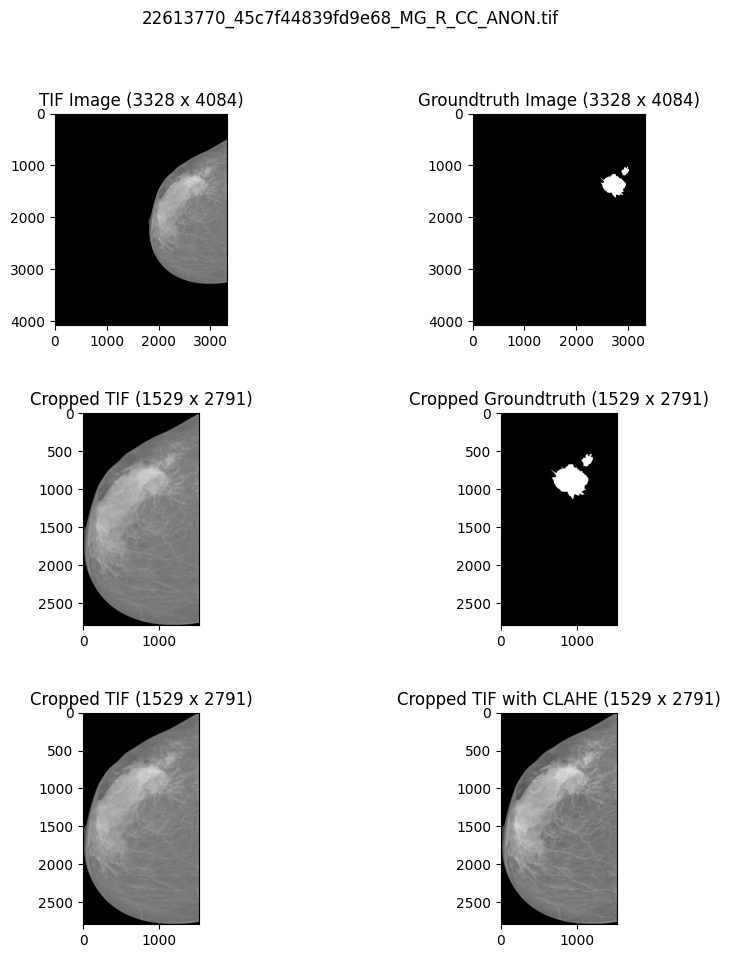

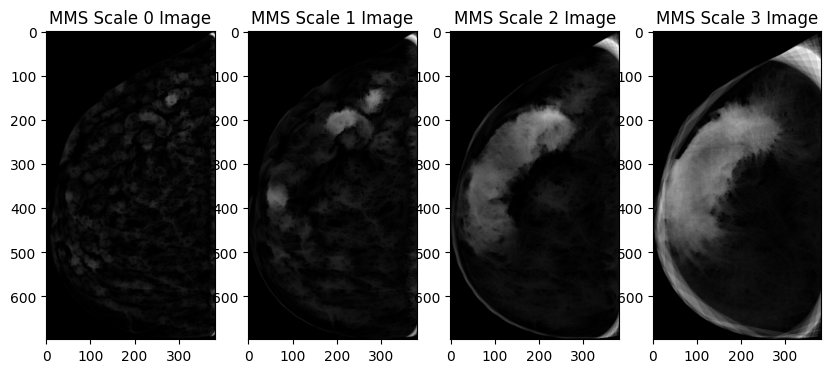

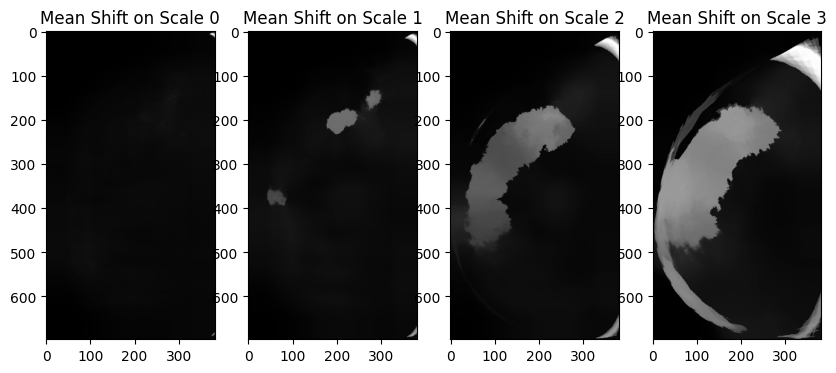

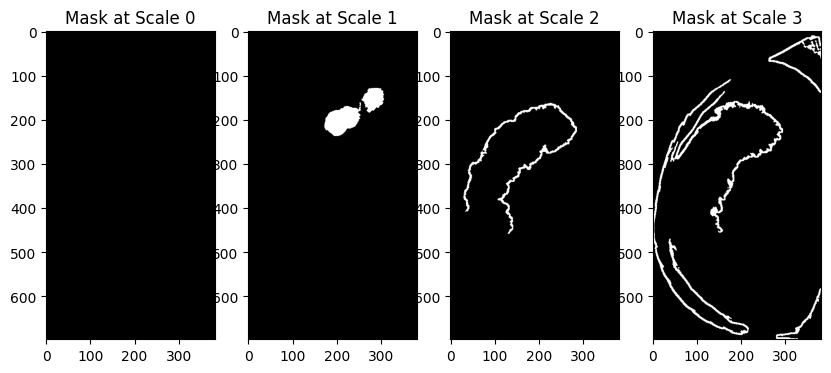

The Dice score on scale 0 0.0
The Dice score on scale 1 0.5936584066080469
The Dice score on scale 2 0.08132421734436848
The Dice score on scale 3 0.028481675392670158
The sensitivity on scale 0 0.0
The sensitivity on scale 1 0.48069039913700107
The sensitivity on scale 2 0.06094929881337648
The sensitivity on scale 3 0.036677454153182305
h: (778, 386) uint16
h: (778, 386) uint8
22613822_45c7f44839fd9e68_MG_R_ML_ANON.tif
(4, 778, 386) int32
ms: (778, 386) uint8
(778, 386) uint8


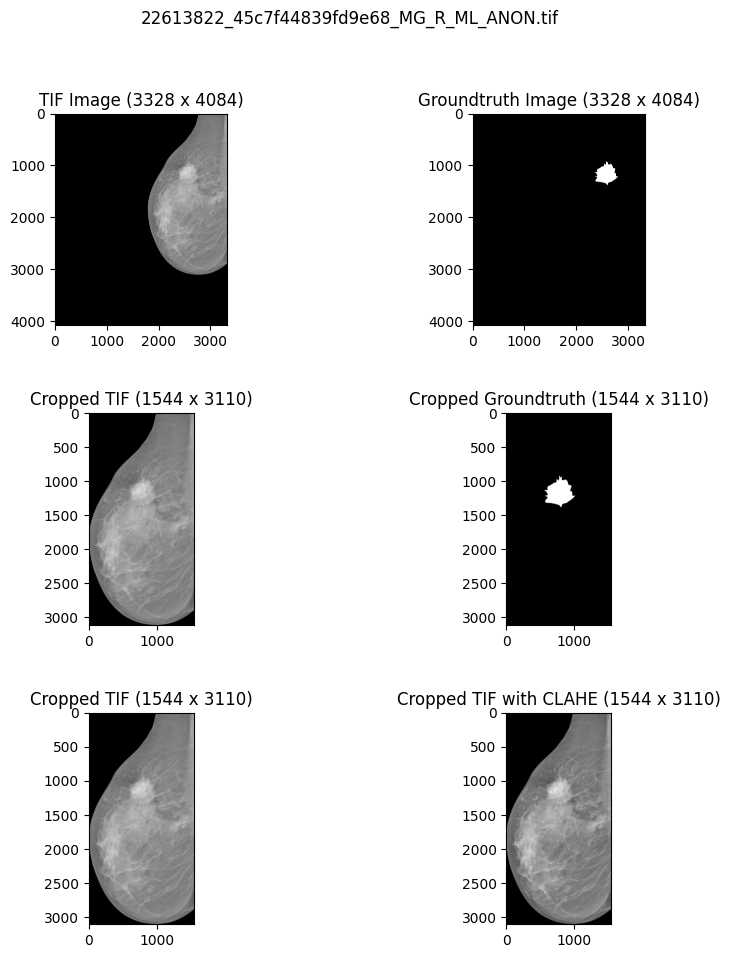

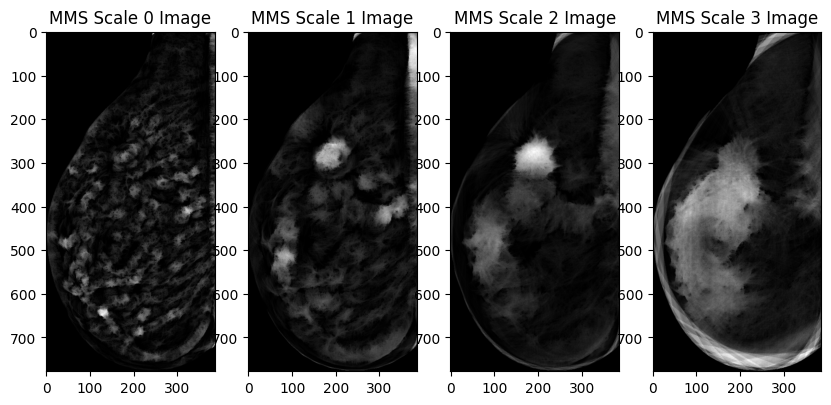

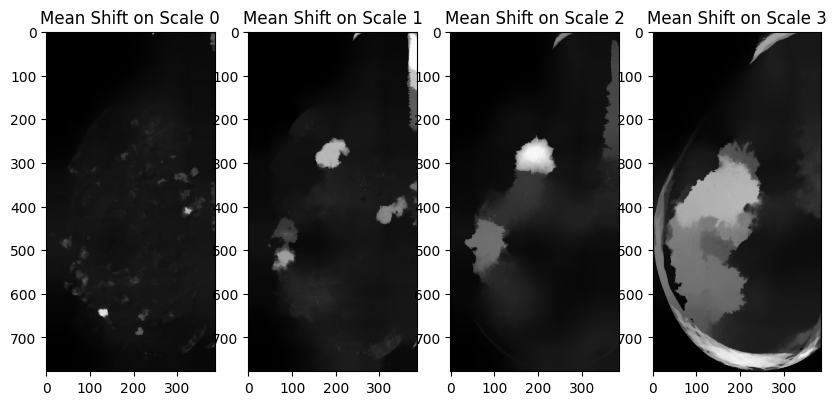

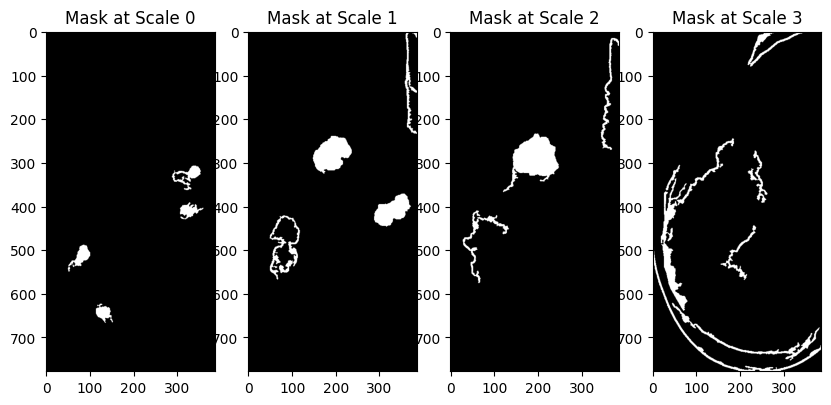

The Dice score on scale 0 0.0
The Dice score on scale 1 0.4744822118719651
The Dice score on scale 2 0.7200554873819559
The Dice score on scale 3 0.0405462719484265
The sensitivity on scale 0 0.0
The sensitivity on scale 1 0.6577826624536337
The sensitivity on scale 2 0.9270504190136007
The sensitivity on scale 3 0.0656683610386042
h: (1018, 618) uint16
h: (1018, 618) uint8
22614074_6bd24a0a42c19ce1_MG_R_CC_ANON.tif
(4, 1018, 618) int32
ms: (1018, 618) uint8
(1018, 618) uint8


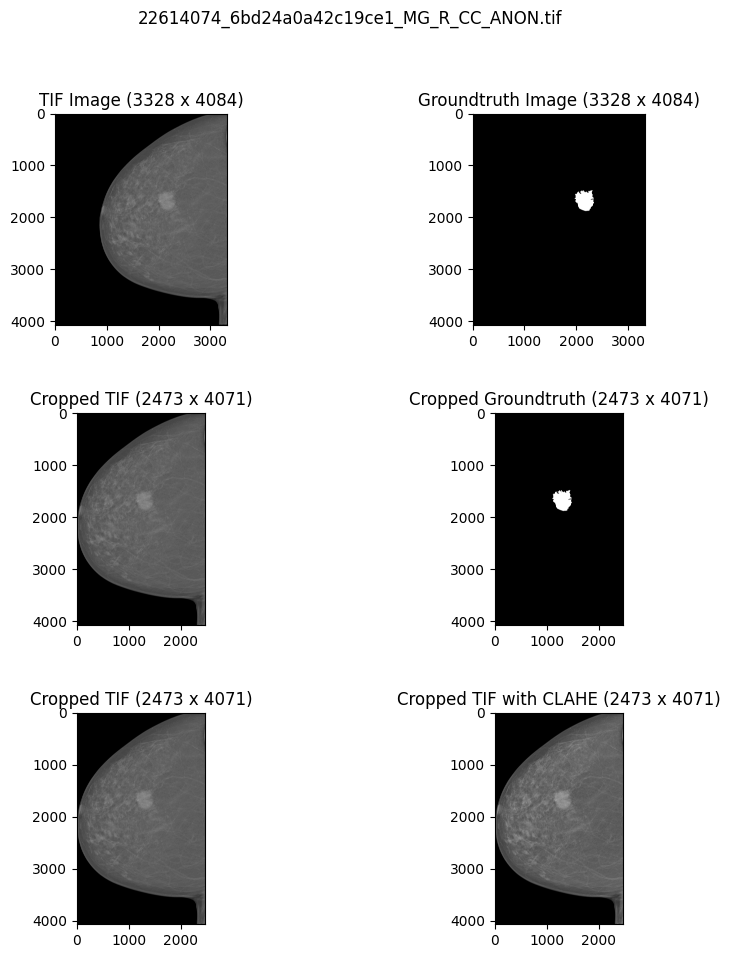

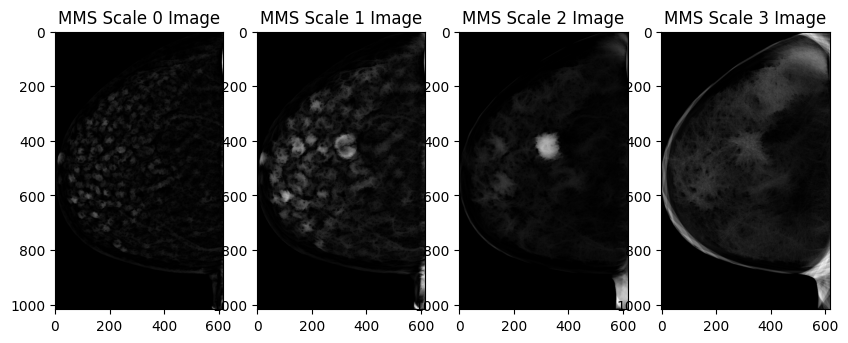

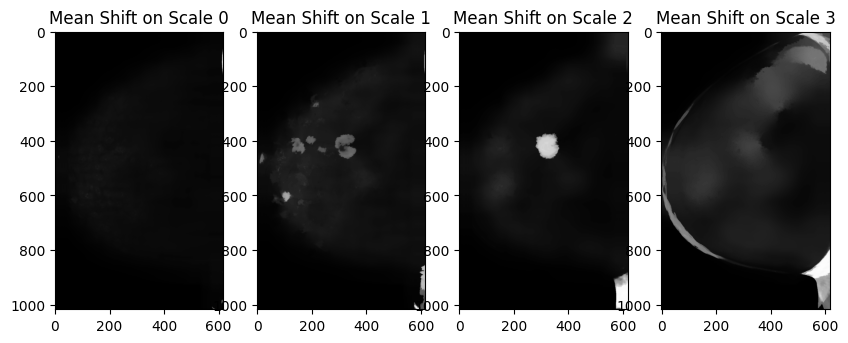

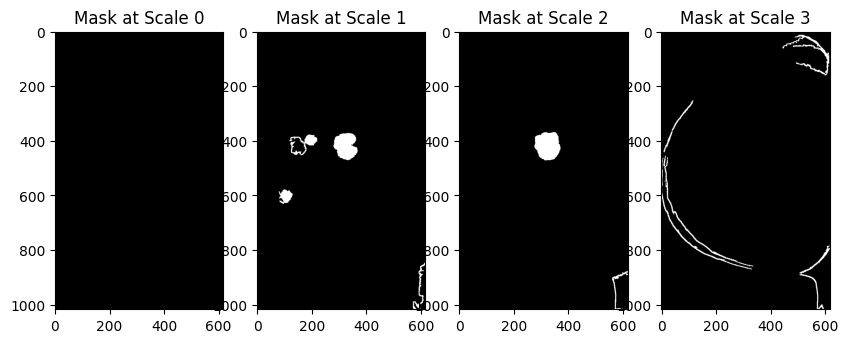

The Dice score on scale 0 0.0
The Dice score on scale 1 0.6426277833342107
The Dice score on scale 2 0.8576735844222393
The Dice score on scale 3 0.0
The sensitivity on scale 0 0.0
The sensitivity on scale 1 0.8983075791022811
The sensitivity on scale 2 0.9852832965415746
The sensitivity on scale 3 0.0
h: (907, 591) uint16
h: (907, 591) uint8
22614127_6bd24a0a42c19ce1_MG_R_ML_ANON.tif
(4, 907, 591) int32
ms: (907, 591) uint8
(907, 591) uint8


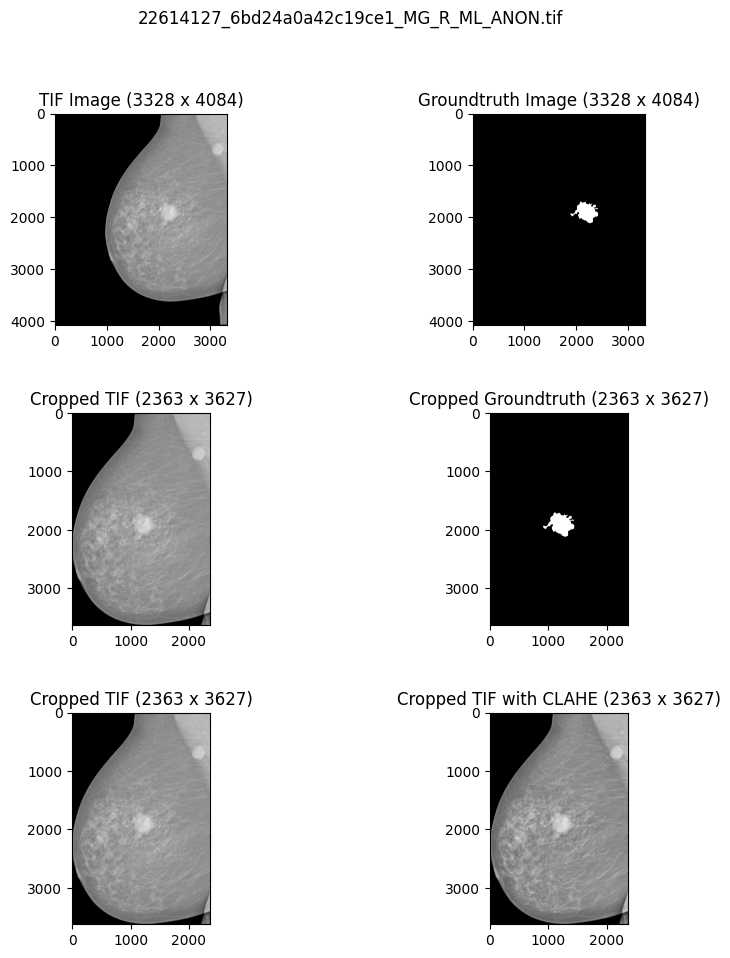

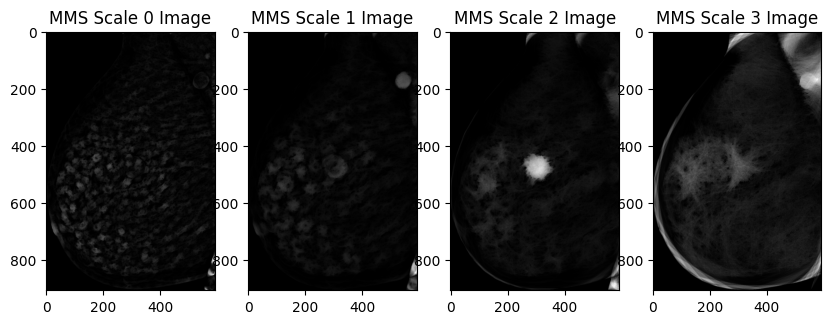

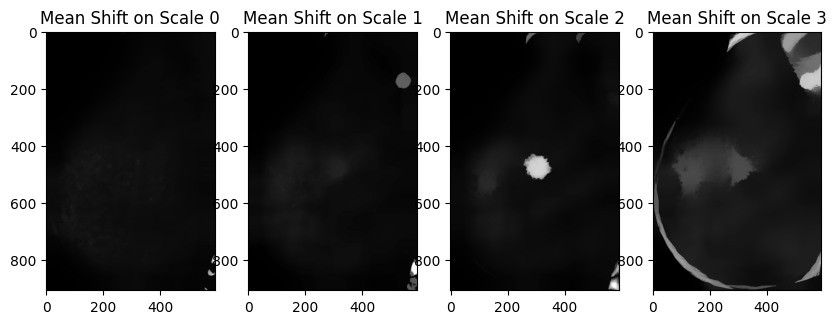

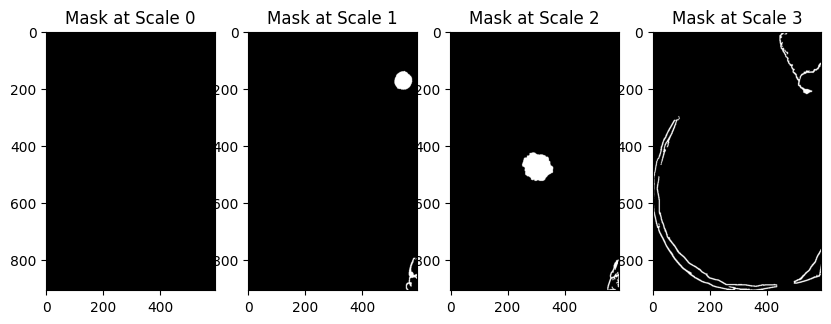

The Dice score on scale 0 0.0
The Dice score on scale 1 0.0
The Dice score on scale 2 0.8315998316599531
The Dice score on scale 3 0.0
The sensitivity on scale 0 0.0
The sensitivity on scale 1 0.0
The sensitivity on scale 2 0.917728237791932
The sensitivity on scale 3 0.0
h: (668, 315) uint16
h: (668, 315) uint8
22614236_1e5c3af078f74b05_MG_L_CC_ANON.tif
(4, 668, 315) int32
ms: (668, 315) uint8
(668, 315) uint8


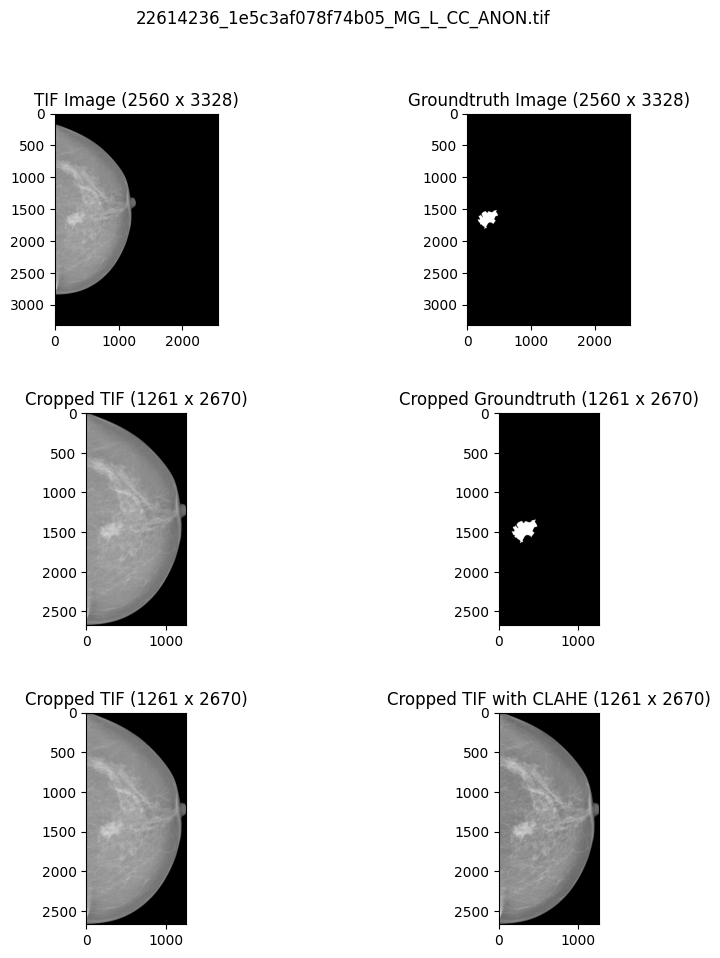

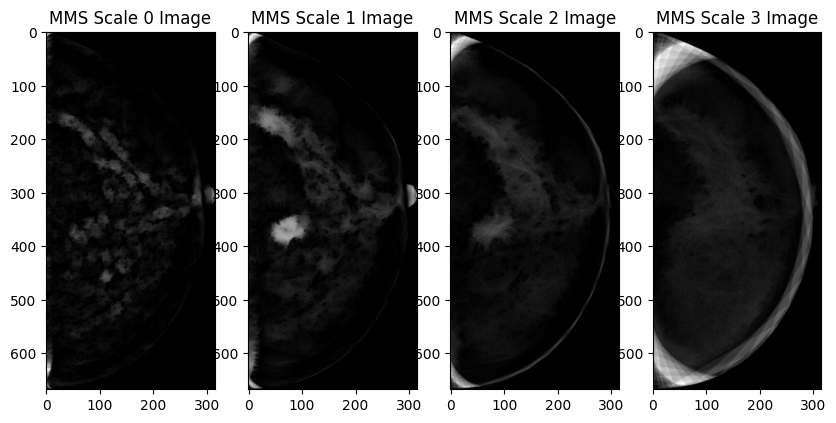

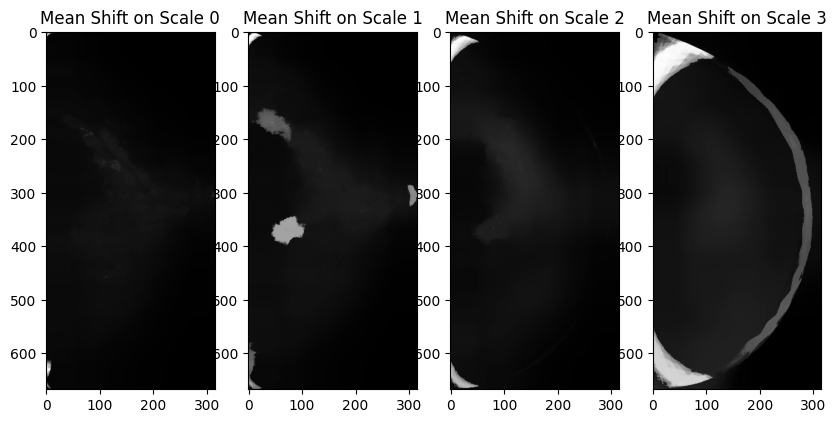

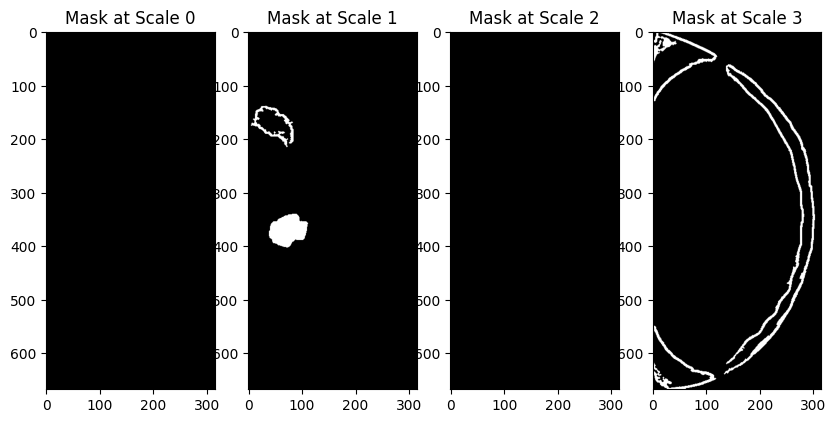

The Dice score on scale 0 0.0
The Dice score on scale 1 0.7111111111111111
The Dice score on scale 2 0.0
The Dice score on scale 3 0.0
The sensitivity on scale 0 0.0
The sensitivity on scale 1 0.8488985417313062
The sensitivity on scale 2 0.0
The sensitivity on scale 3 0.0
h: (731, 334) uint16
h: (731, 334) uint8
22614266_1e5c3af078f74b05_MG_L_ML_ANON.tif
(4, 731, 334) int32
ms: (731, 334) uint8
(731, 334) uint8


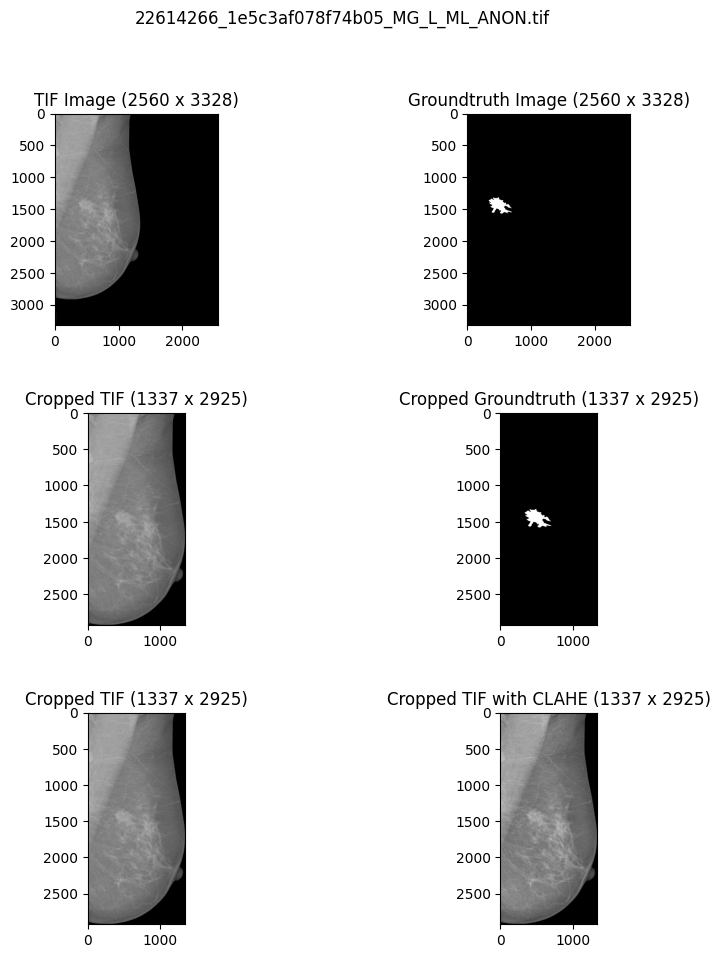

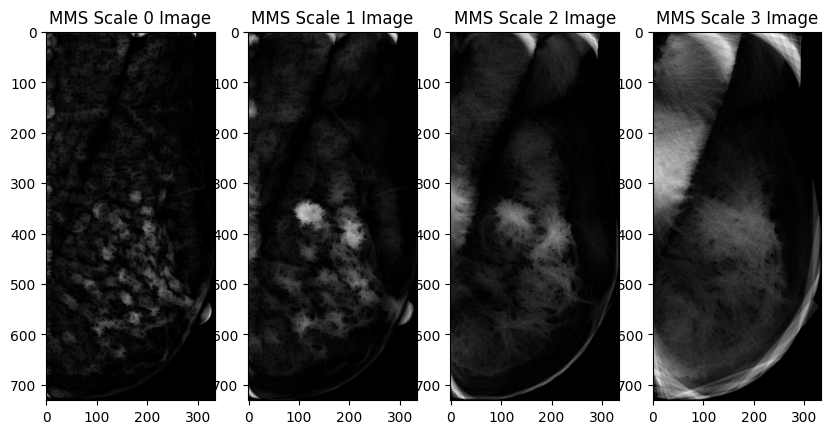

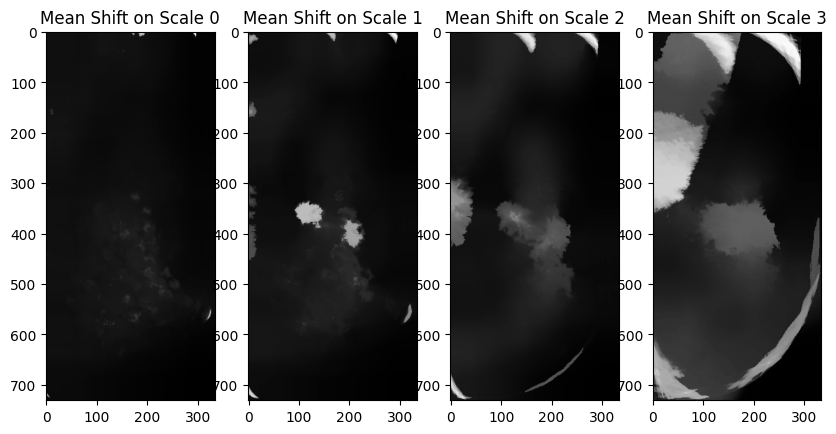

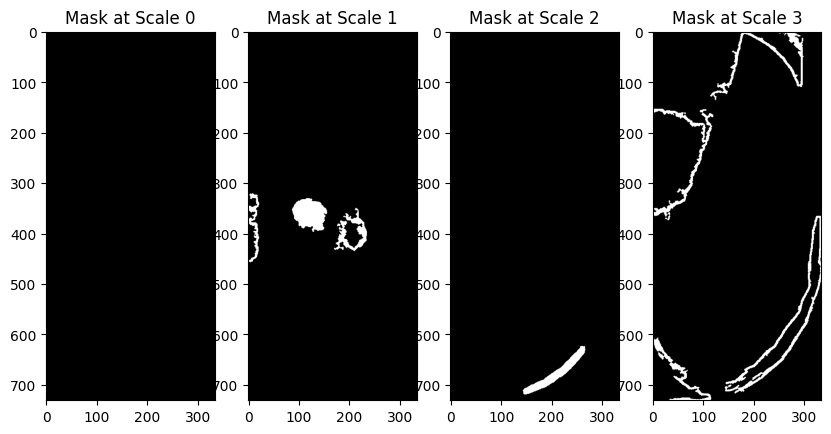

The Dice score on scale 0 0.0
The Dice score on scale 1 0.5560121107266436
The Dice score on scale 2 0.0
The Dice score on scale 3 0.0
The sensitivity on scale 0 0.0
The sensitivity on scale 1 0.8317696538337108
The sensitivity on scale 2 0.0
The sensitivity on scale 3 0.0
h: (779, 355) uint16
h: (779, 355) uint8
22614379_d065adcb9905b973_MG_L_CC_ANON.tif
(4, 779, 355) int32
ms: (779, 355) uint8
(779, 355) uint8


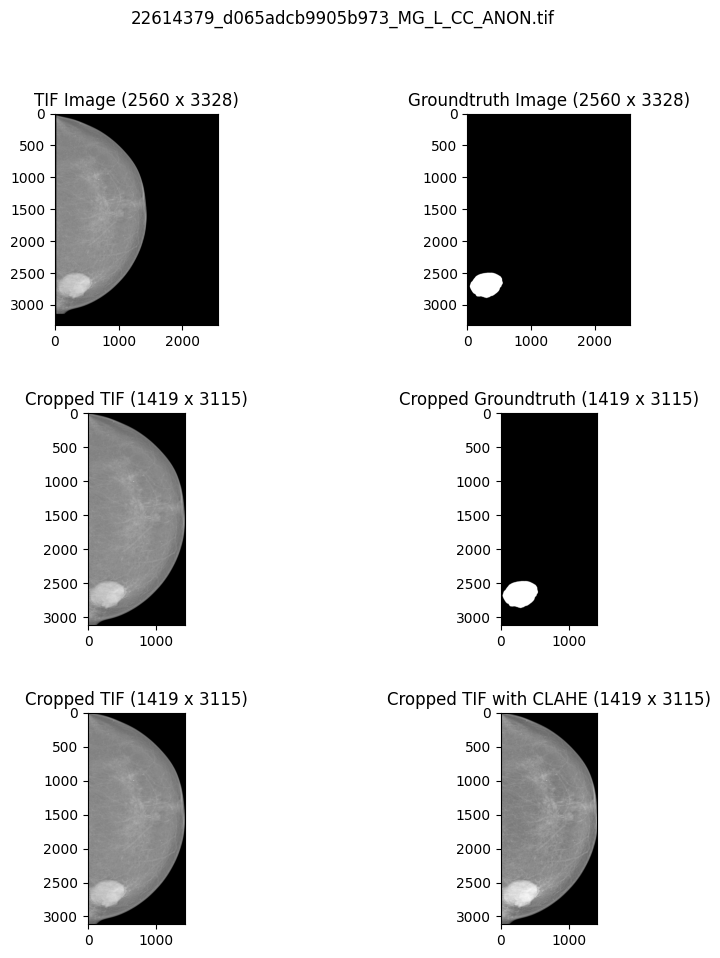

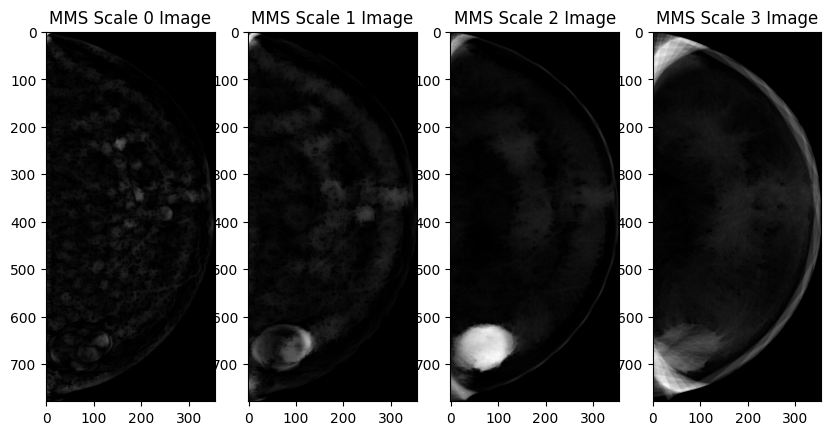

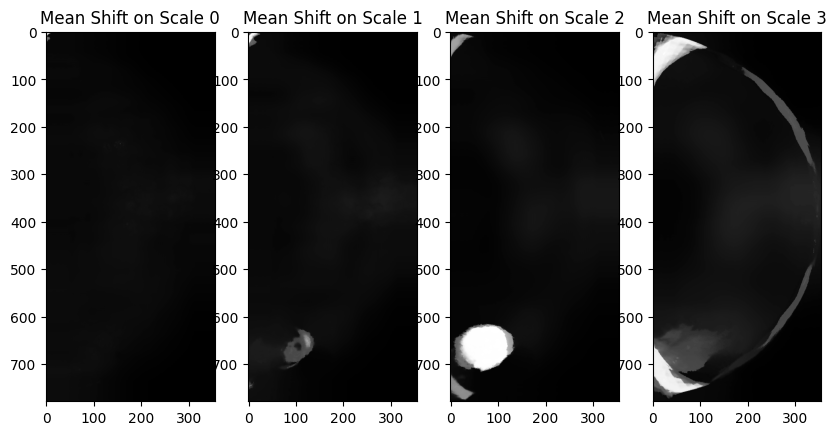

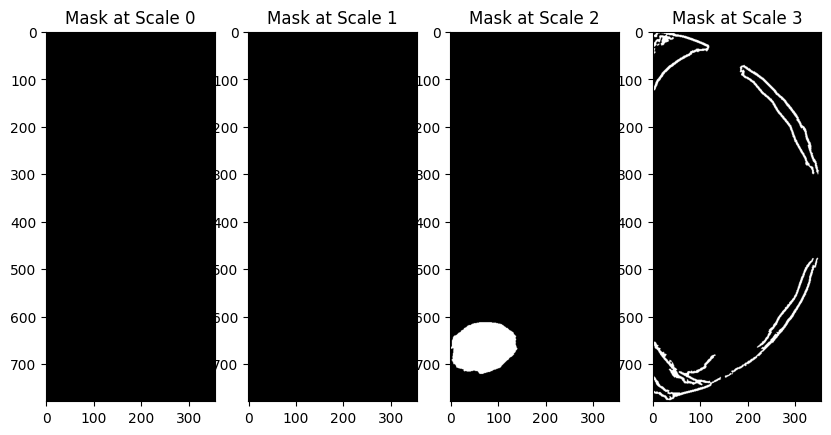

The Dice score on scale 0 0.0
The Dice score on scale 1 0.0
The Dice score on scale 2 0.9083717864205669
The Dice score on scale 3 0.043424132264329465
The sensitivity on scale 0 0.0
The sensitivity on scale 1 0.0
The sensitivity on scale 2 0.999171327946965
The sensitivity on scale 3 0.04516262689040812
h: (746, 417) uint16
h: (746, 417) uint8
22614431_d065adcb9905b973_MG_L_ML_ANON.tif
(4, 746, 417) int32
ms: (746, 417) uint8
(746, 417) uint8


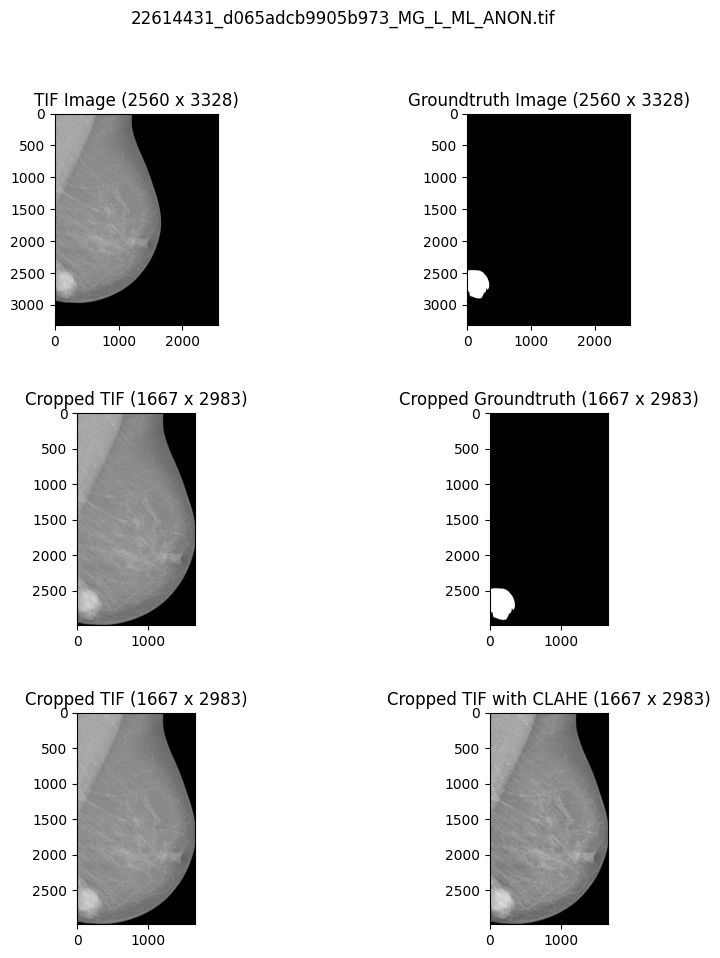

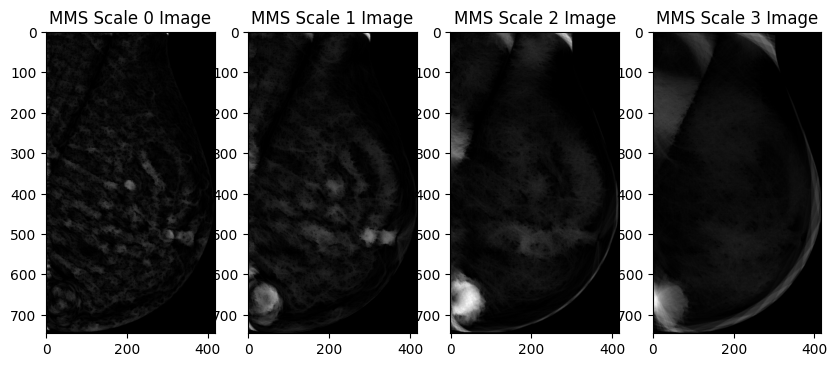

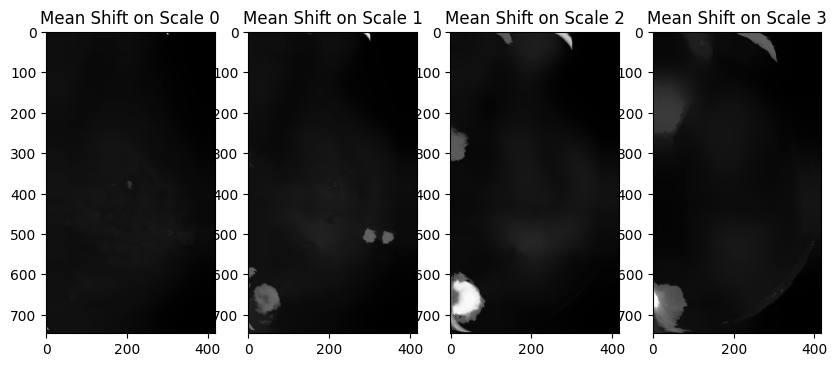

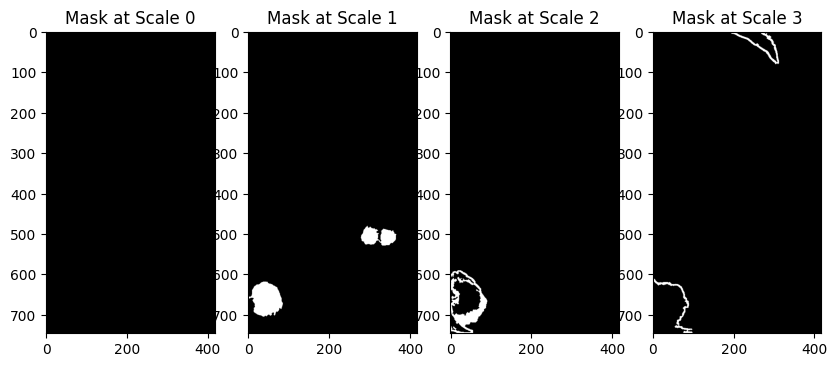

The Dice score on scale 0 0.0
The Dice score on scale 1 0.6435095844590248
The Dice score on scale 2 0.5204796008690754
The Dice score on scale 3 0.14322841466936181
The sensitivity on scale 0 0.0
The sensitivity on scale 1 0.6394783942725646
The sensitivity on scale 2 0.41344924571720787
The sensitivity on scale 3 0.09511633853234466
h: (784, 358) uint16
h: (784, 358) uint8
22614522_2dec4948fbe6336d_MG_L_CC_ANON.tif
(4, 784, 358) int32
ms: (784, 358) uint8
(784, 358) uint8


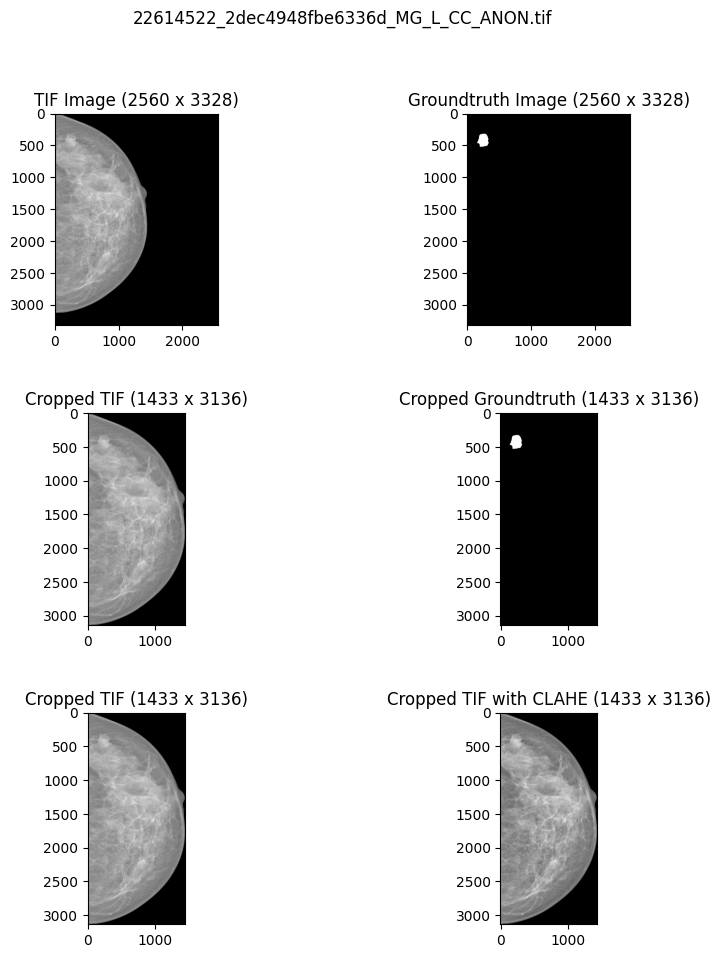

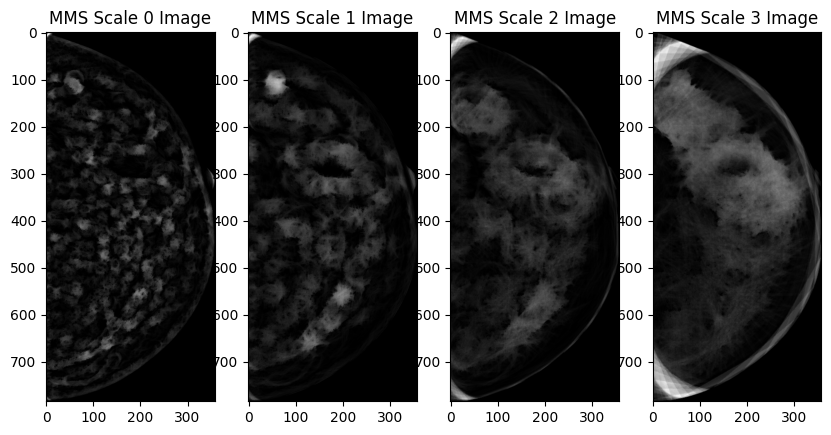

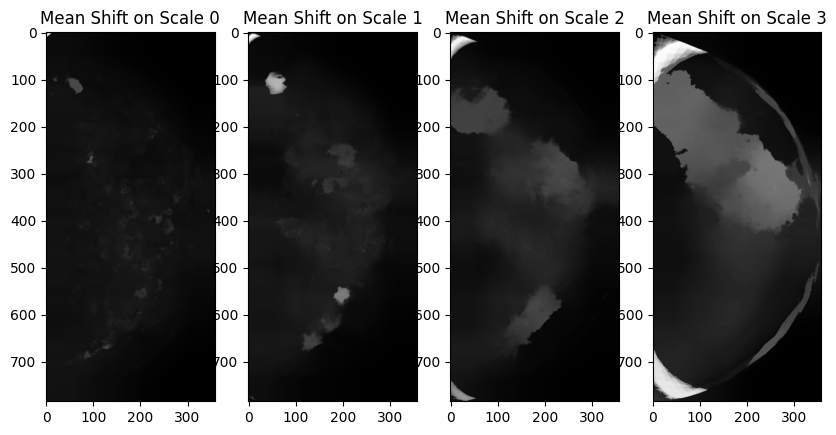

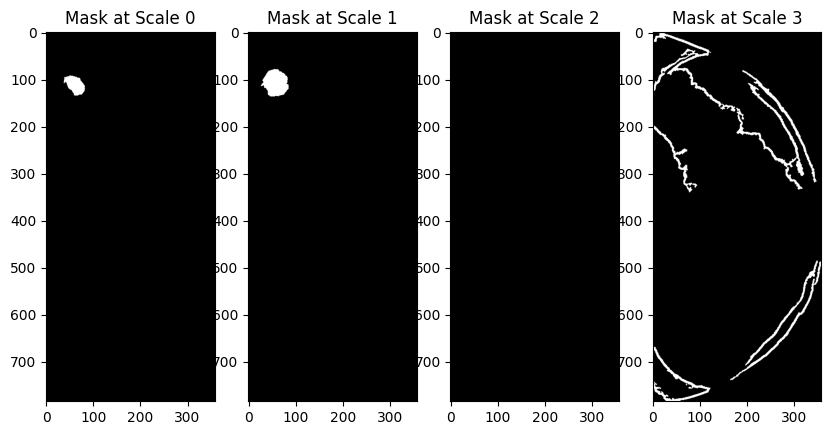

The Dice score on scale 0 0.7243675099866844
The Dice score on scale 1 0.835799522673031
The Dice score on scale 2 0.0
The Dice score on scale 3 0.004211357504770678
The sensitivity on scale 0 0.6153846153846154
The sensitivity on scale 1 0.9903846153846154
The sensitivity on scale 2 0.0
The sensitivity on scale 3 0.01809954751131222
h: (824, 386) uint16
h: (824, 386) uint8
22614568_2dec4948fbe6336d_MG_L_ML_ANON.tif
(4, 824, 386) int32
ms: (824, 386) uint8
(824, 386) uint8


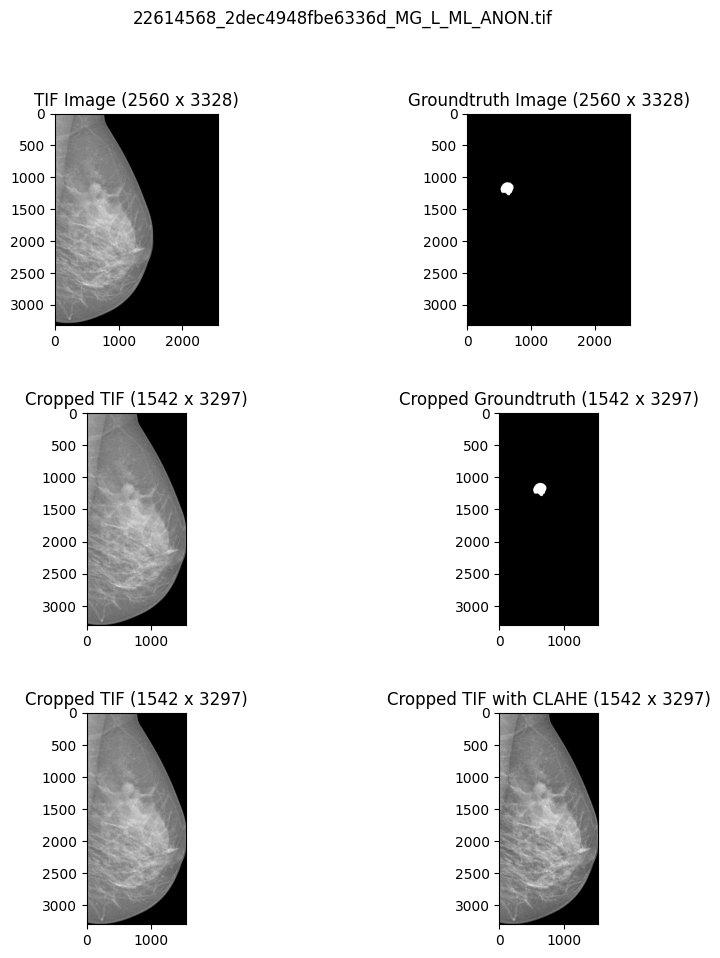

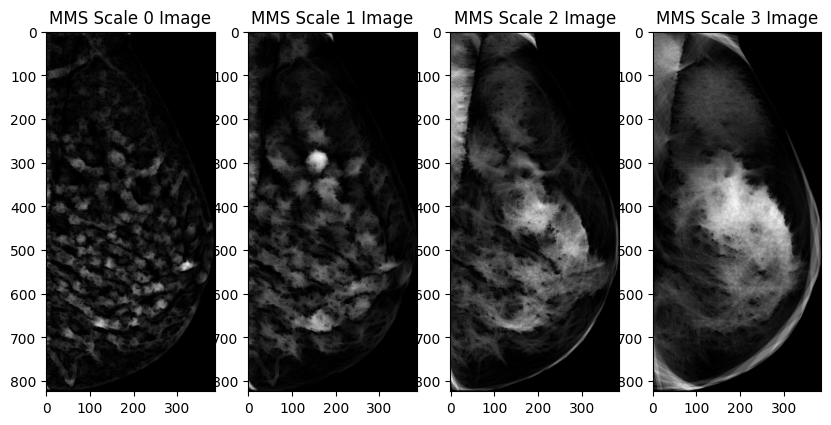

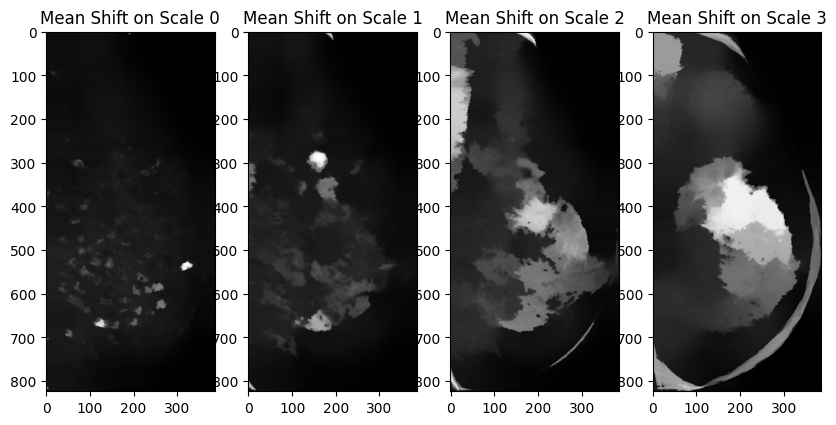

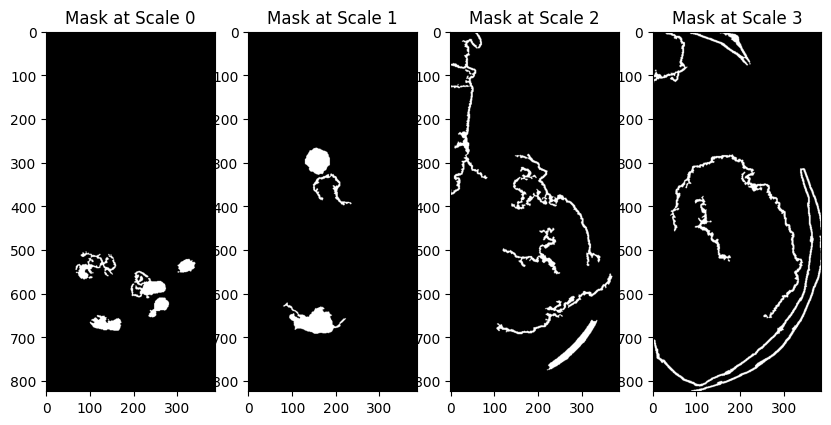

The Dice score on scale 0 0.0
The Dice score on scale 1 0.38566483404601914
The Dice score on scale 2 0.029492537313432834
The Dice score on scale 3 0.03675652772628568
The sensitivity on scale 0 0.0
The sensitivity on scale 1 0.9895506792058516
The sensitivity on scale 2 0.1290491118077325
The sensitivity on scale 3 0.1812957157784744
h: (740, 454) uint16
h: (740, 454) uint8
22670094_e1f51192f7bf3f5f_MG_R_CC_ANON.tif
(4, 740, 454) int32
ms: (740, 454) uint8
(740, 454) uint8


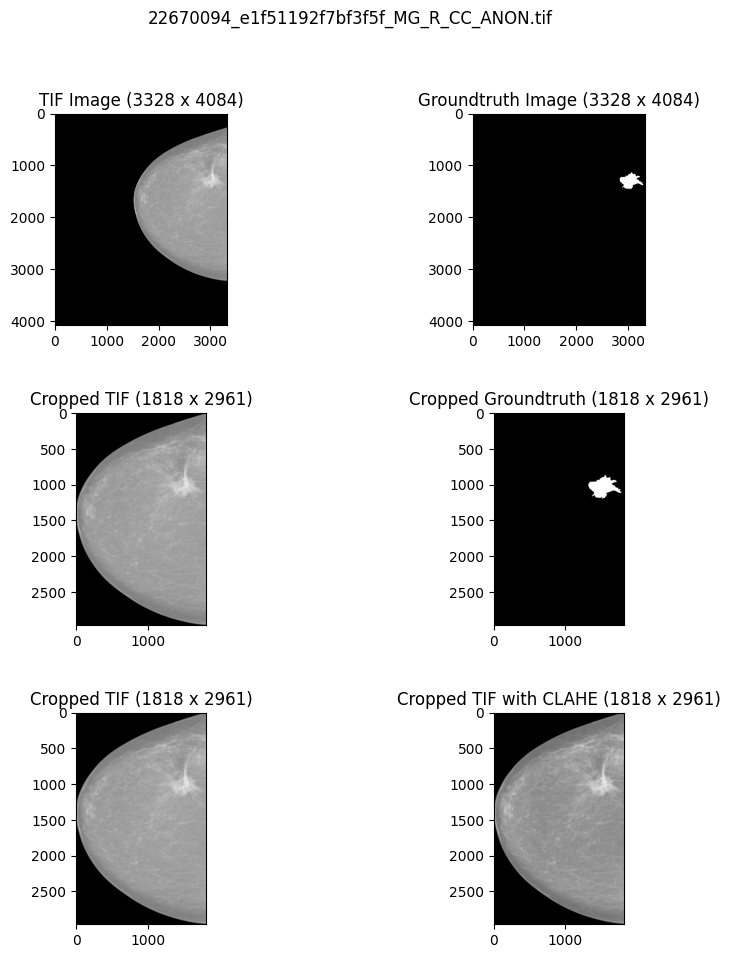

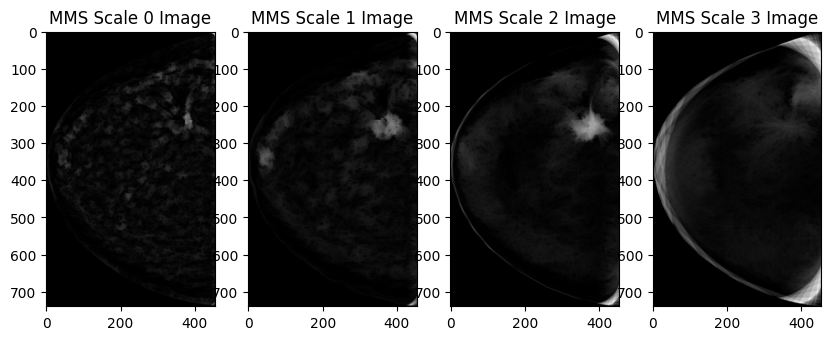

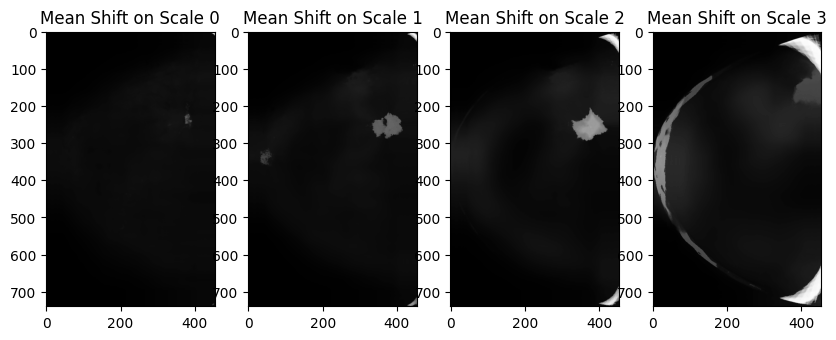

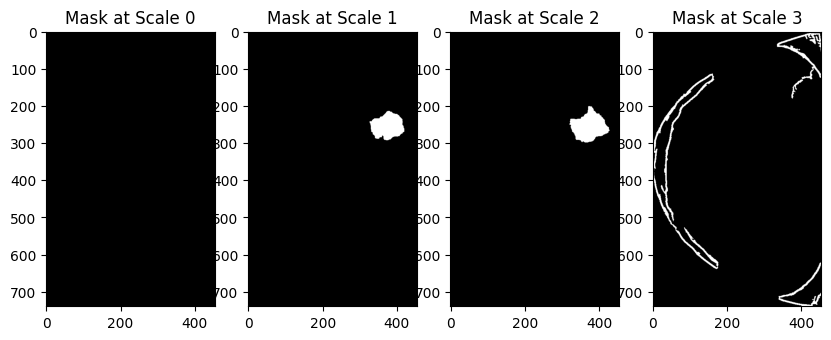

The Dice score on scale 0 0.0
The Dice score on scale 1 0.8604674291397315
The Dice score on scale 2 0.850390870698176
The Dice score on scale 3 0.0
The sensitivity on scale 0 0.0
The sensitivity on scale 1 0.8636454382112198
The sensitivity on scale 2 0.9446995408265123
The sensitivity on scale 3 0.0
h: (844, 456) uint16
h: (844, 456) uint8
22670147_e1f51192f7bf3f5f_MG_R_ML_ANON.tif
(4, 844, 456) int32
ms: (844, 456) uint8
(844, 456) uint8


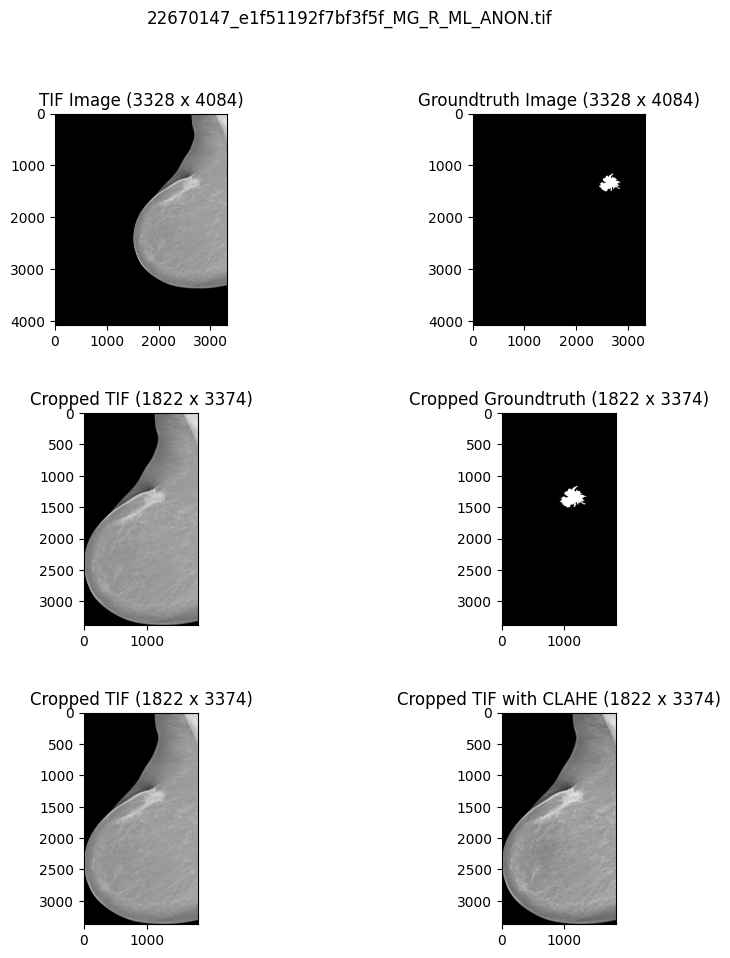

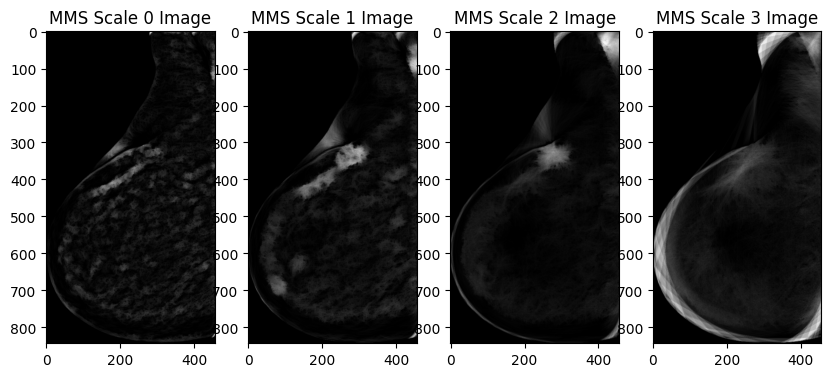

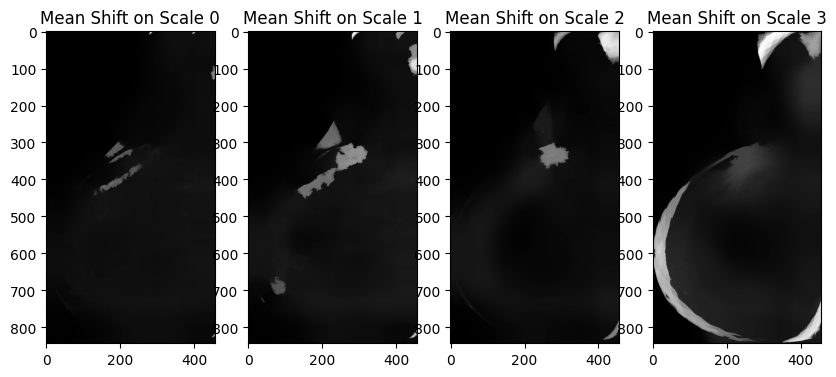

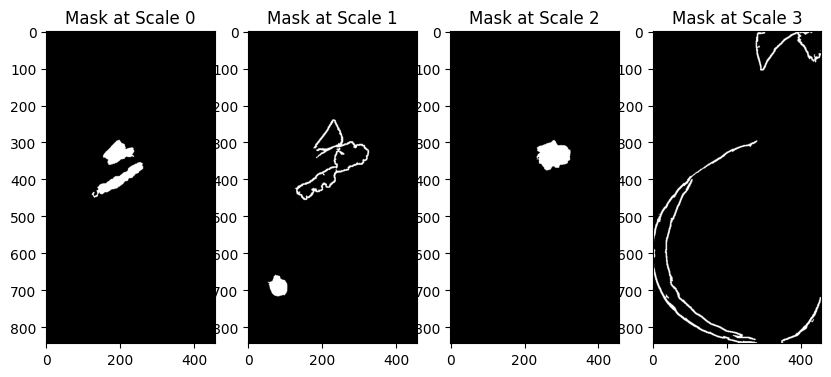

The Dice score on scale 0 0.055228212118547185
The Dice score on scale 1 0.10084325828044857
The Dice score on scale 2 0.8656351791530945
The Dice score on scale 3 0.011525552529922108
The sensitivity on scale 0 0.06604964240639462
The sensitivity on scale 1 0.12200252419015566
The sensitivity on scale 2 0.8944047118216238
The sensitivity on scale 3 0.019141775347076145
h: (769, 311) uint16
h: (769, 311) uint8
22670278_98429c0bdf78c0c7_MG_R_CC_ANON.tif
(4, 769, 311) int32
ms: (769, 311) uint8
(769, 311) uint8


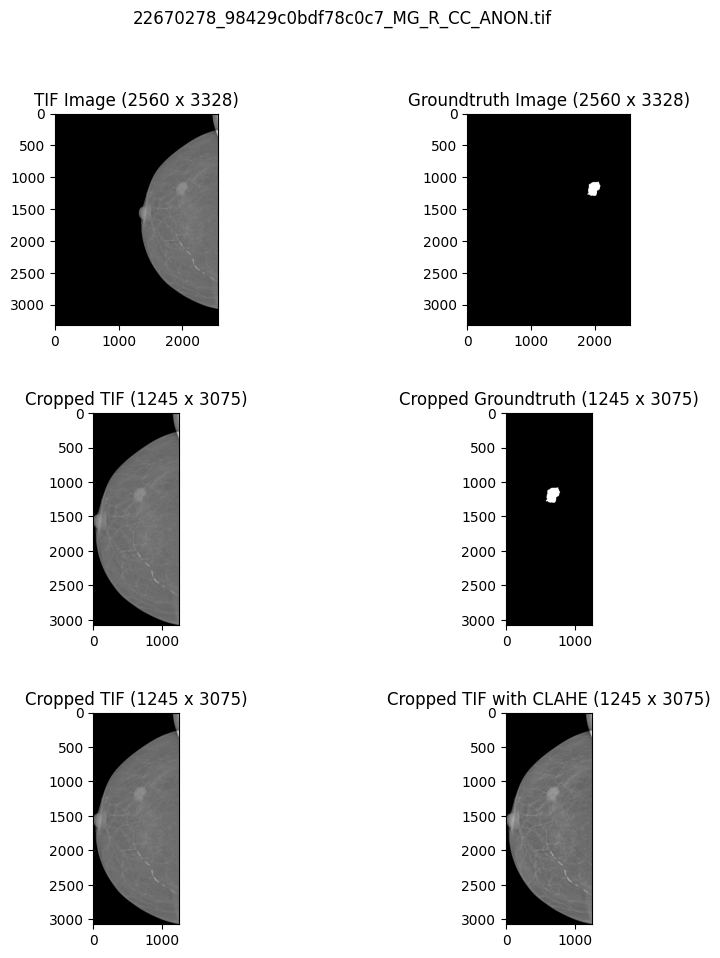

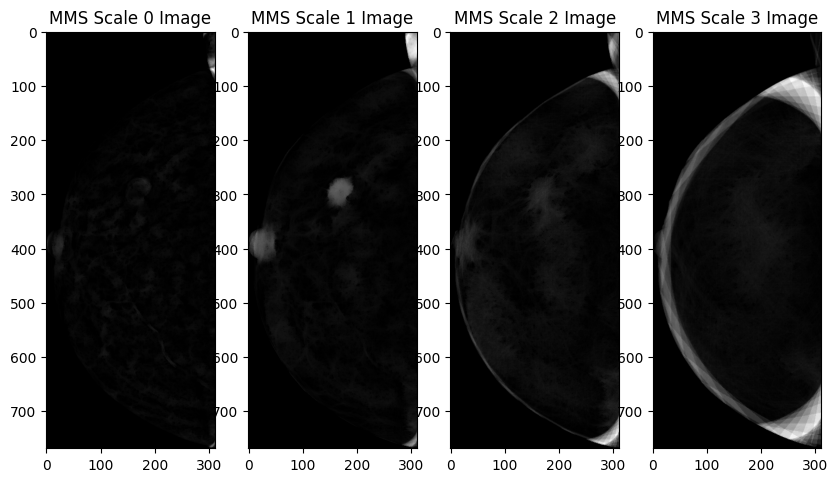

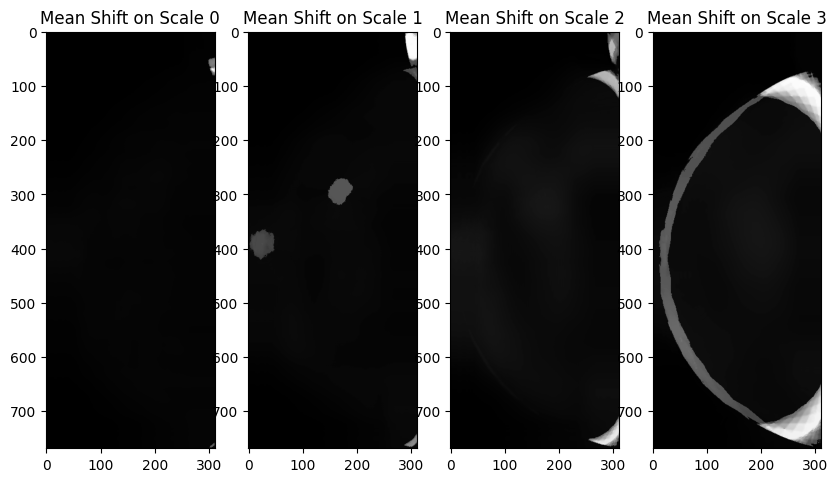

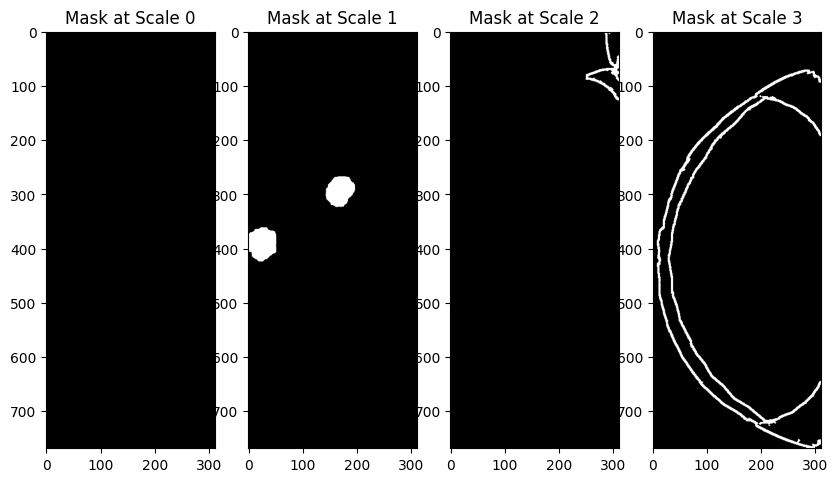

The Dice score on scale 0 0.0
The Dice score on scale 1 0.5636311404768745
The Dice score on scale 2 0.0
The Dice score on scale 3 0.0
The sensitivity on scale 0 0.0
The sensitivity on scale 1 0.9528897523069452
The sensitivity on scale 2 0.0
The sensitivity on scale 3 0.0
h: (722, 308) uint16
h: (722, 308) uint8
22670324_98429c0bdf78c0c7_MG_R_ML_ANON.tif
(4, 722, 308) int32
ms: (722, 308) uint8
(722, 308) uint8


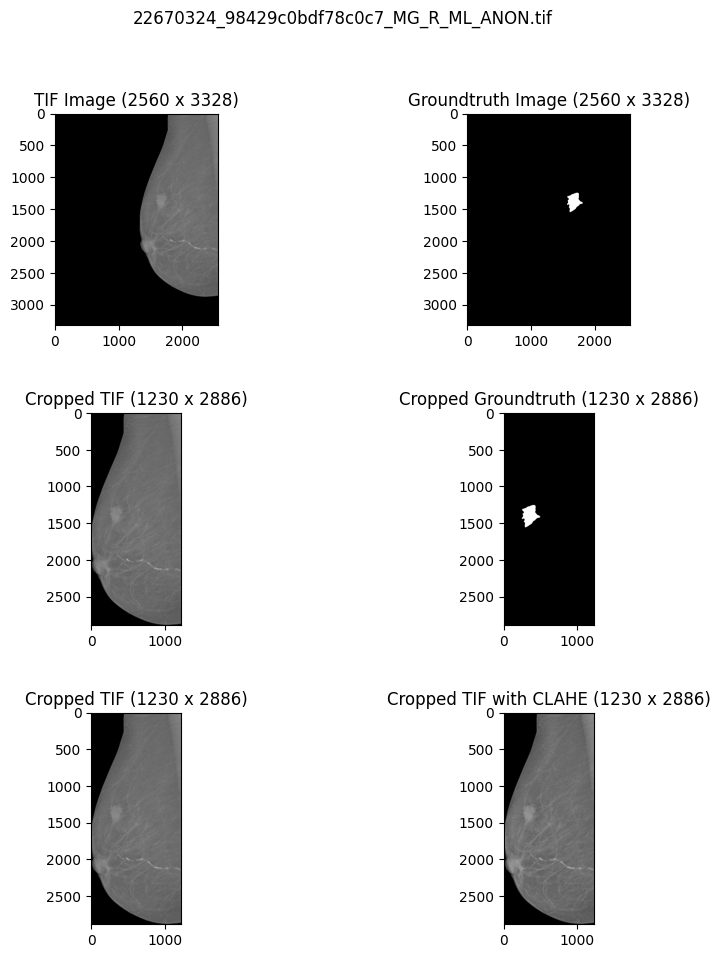

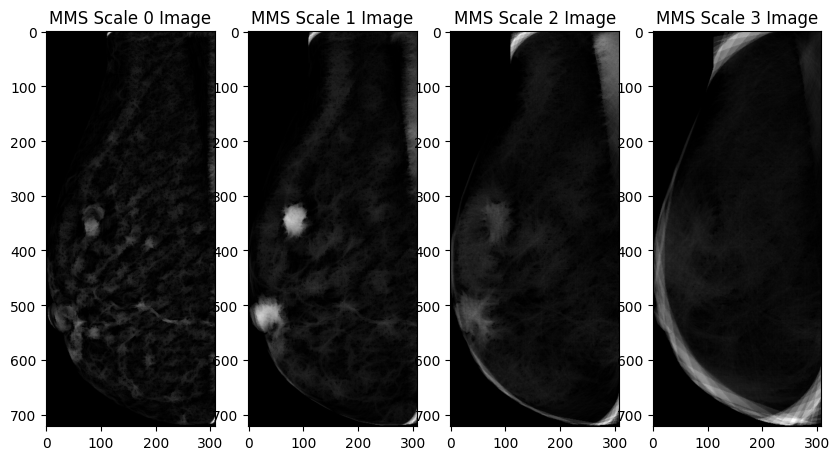

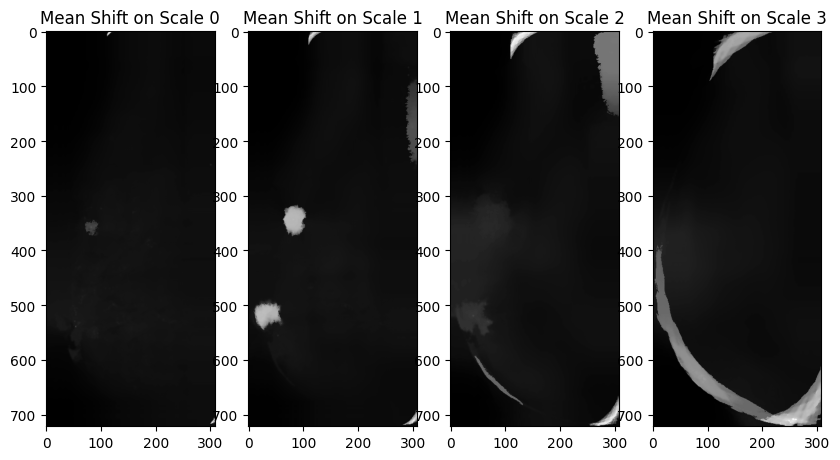

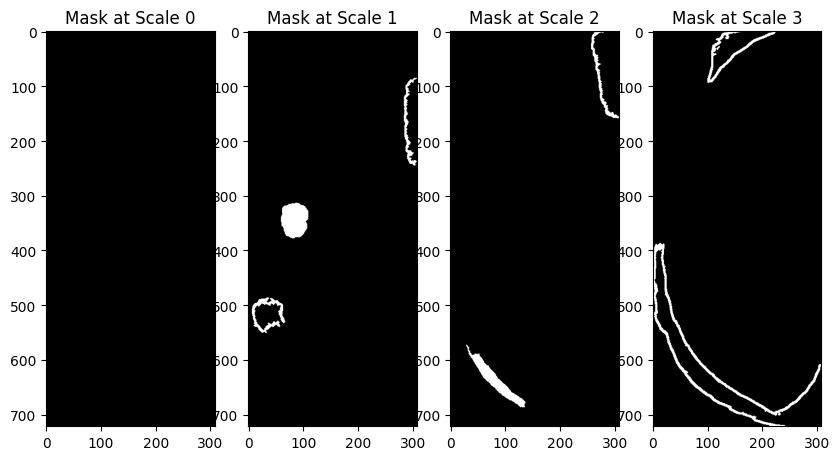

The Dice score on scale 0 0.0
The Dice score on scale 1 0.6136606189967982
The Dice score on scale 2 0.0
The Dice score on scale 3 0.0
The sensitivity on scale 0 0.0
The sensitivity on scale 1 0.8443465491923642
The sensitivity on scale 2 0.0
The sensitivity on scale 3 0.0
h: (746, 292) uint16
h: (746, 292) uint8
22670465_7e677f3d530e41ed_MG_L_CC_ANON.tif
(4, 746, 292) int32
ms: (746, 292) uint8
(746, 292) uint8


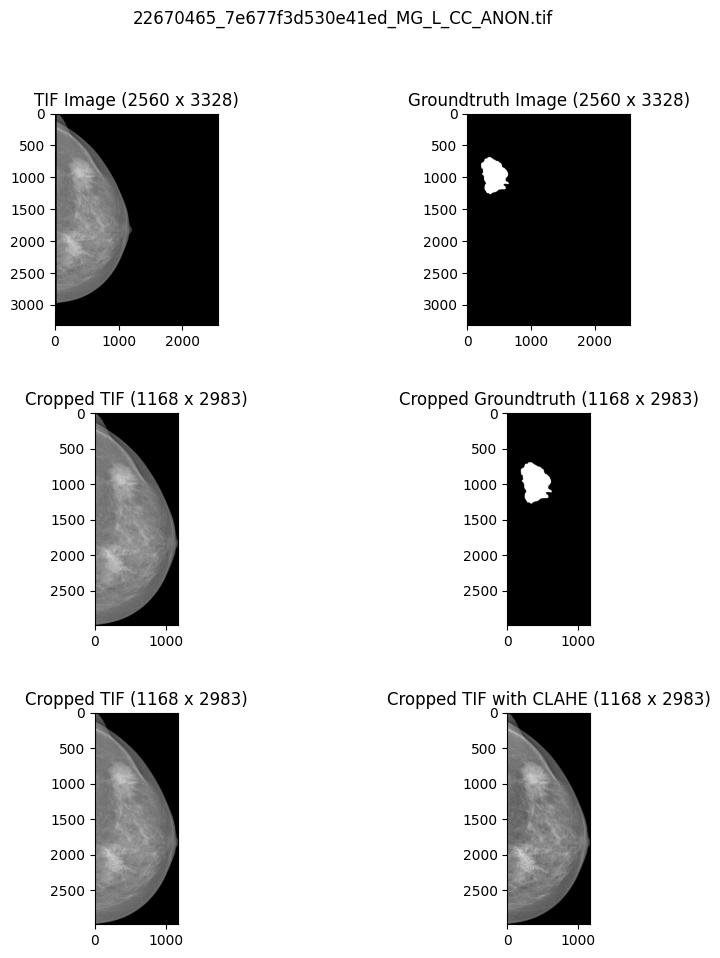

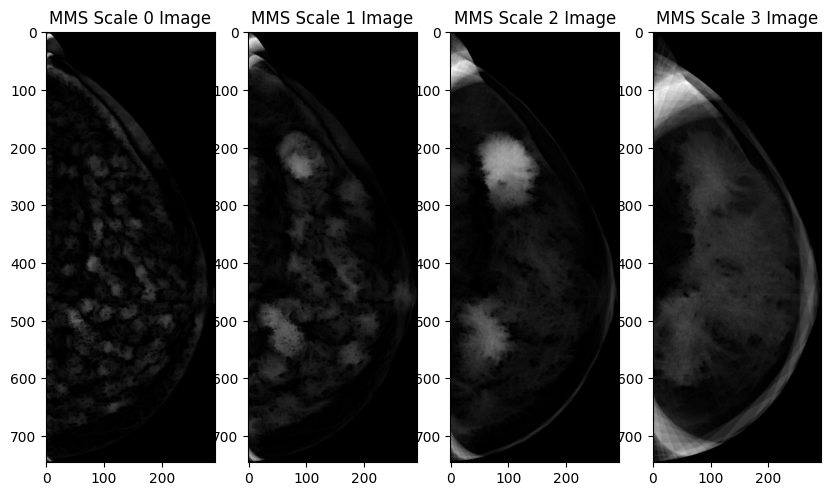

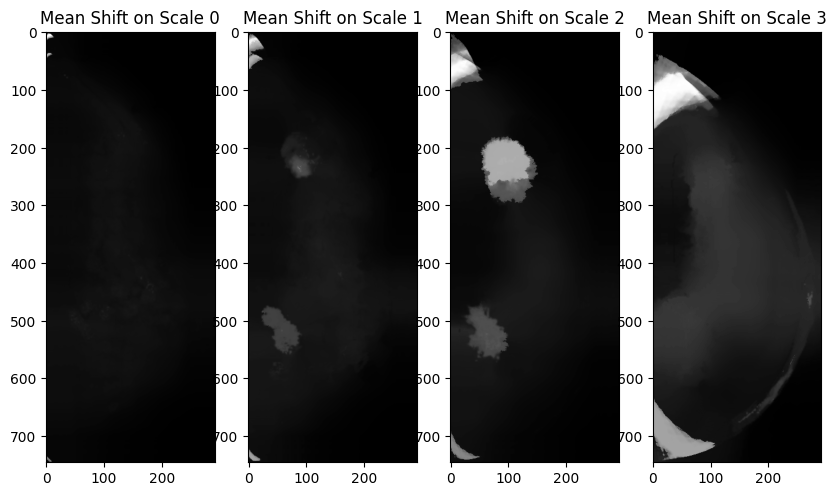

KeyboardInterrupt: 

In [10]:
# Iterate over each TIF image and crop it along with its corresponding groundtruth image using the Otsu thresholding method
for tif_image in tif_images:
    # Load the TIF image
    tif_image_path = os.path.join(positive_images_path, tif_image)
    tif_image_pil = Image.open(tif_image_path)
    tif_image_np = np.array(tif_image_pil)
    
    # Get the corresponding groundtruth image path
    groundtruth_image_path = os.path.join(groundtruth_path, tif_image)
    groundtruth_image_pil = Image.open(groundtruth_image_path)
    groundtruth_image_np = np.array(groundtruth_image_pil)
        
    # Apply Otsu thresholding to the TIF image
    x, y, w, h = Otsu_thresholding(tif_image_np)
    tif_image_cropped = tif_image_np[y:y+h, x:x+w]
    groundtruth_image_cropped = groundtruth_image_np[y:y+h, x:x+w]
    
    # Apply CLAHE to the cropped TIF image
    tif_image_cropped_clahe = clahe(tif_image_cropped, clip=8, tile=4)
    
#     print(tif_image_cropped_clahe.shape, tif_image_cropped_clahe.dtype)
    
    # Apply multiscale morphological shifting to the cropped TIF image
    M = 4
    N = 18
    Areamin = 15
    Areamax = 3689
    PixelSize = 70/1000 # micrometers
    down_img = cv2.resize(tif_image_cropped_clahe, None, fx = 1/4, fy = 1/4, interpolation = cv2.INTER_CUBIC)
    down_groundtruth = cv2.resize(groundtruth_image_cropped, None, fx = 1/4, fy = 1/4, interpolation = cv2.INTER_CUBIC)
    
    print("h:", down_img.shape, down_img.dtype)
    print("h:", down_groundtruth.shape, down_groundtruth.dtype)

    sum_all_images = multi_scale_morphological_sifters(down_img, M, N, Areamin, Areamax, PixelSize)
    
    print(tif_image)
    print(sum_all_images.shape, sum_all_images.dtype)
    
    # Apply the mean shift filtering to the different scales of sifted images
    mean_shifted_image_0 = mean_shift_filter(sum_all_images[0])
    mean_shifted_image_1 = mean_shift_filter(sum_all_images[1])
    mean_shifted_image_2 = mean_shift_filter(sum_all_images[2])
    mean_shifted_image_3 = mean_shift_filter(sum_all_images[3])
    
    print("ms:", mean_shifted_image_0.shape, mean_shifted_image_0.dtype)
    
    # Apply elimination of small objects outside the desired area range 
    eliminate_0 = eliminate(mean_shifted_image_0)
    eliminate_1 = eliminate(mean_shifted_image_1)
    eliminate_2 = eliminate(mean_shifted_image_2)
    eliminate_3 = eliminate(mean_shifted_image_3)
    
    print(eliminate_0.shape, eliminate_0.dtype)\
    
    
    # Calculating the dice scores
    dice_score_0 = calculate_dice_score(down_groundtruth, eliminate_0)
    dice_score_1 = calculate_dice_score(down_groundtruth, eliminate_1)
    dice_score_2 = calculate_dice_score(down_groundtruth, eliminate_2)
    dice_score_3 = calculate_dice_score(down_groundtruth, eliminate_3)
    
    # Calculating the sensitivity scores
    sensitivity_score_0 = calculate_sensitivity(down_groundtruth, eliminate_0)
    sensitivity_score_1 = calculate_sensitivity(down_groundtruth, eliminate_1)
    sensitivity_score_2 = calculate_sensitivity(down_groundtruth, eliminate_2)
    sensitivity_score_3 = calculate_sensitivity(down_groundtruth, eliminate_3)
    
    
    # Display the original and cropped TIF and groundtruth images along with their size
    fig, ax = plt.subplots(3, 2, figsize=(10, 10))
    fig.suptitle(tif_image)
    ax[0, 0].imshow(tif_image_np, cmap='gray')
    ax[0, 0].set_title('TIF Image ({} x {})'.format(tif_image_np.shape[1], tif_image_np.shape[0]))
    ax[0, 1].imshow(groundtruth_image_np, cmap='gray')
    ax[0, 1].set_title('Groundtruth Image ({} x {})'.format(groundtruth_image_np.shape[1], groundtruth_image_np.shape[0]))
    ax[1, 0].imshow(tif_image_cropped, cmap='gray')
    ax[1, 0].set_title('Cropped TIF ({} x {})'.format(tif_image_cropped.shape[1], tif_image_cropped.shape[0]))
    ax[1, 1].imshow(groundtruth_image_cropped, cmap='gray')
    ax[1, 1].set_title('Cropped Groundtruth ({} x {})'.format(groundtruth_image_cropped.shape[1], groundtruth_image_cropped.shape[0]))
    ax[2, 0].imshow(tif_image_cropped, cmap='gray')
    ax[2, 0].set_title('Cropped TIF ({} x {})'.format(tif_image_cropped.shape[1], tif_image_cropped.shape[0]))          
    ax[2, 1].imshow(tif_image_cropped_clahe, cmap='gray')
    ax[2, 1].set_title('Cropped TIF with CLAHE ({} x {})'.format(tif_image_cropped_clahe.shape[1], tif_image_cropped_clahe.shape[0]))
    fig.tight_layout(pad=3.0)
    plt.show()
    
    
    # Display the MMS shifting images at different scales
    a, ax = plt.subplots(1, 4, figsize=(10, 10))
    ax[0].imshow(sum_all_images[0], cmap='gray')
    ax[0]. set_title('MMS Scale 0 Image')
    ax[1].imshow(sum_all_images[1], cmap='gray')
    ax[1]. set_title('MMS Scale 1 Image')
    ax[2].imshow(sum_all_images[2], cmap='gray')
    ax[2]. set_title('MMS Scale 2 Image')
    ax[3].imshow(sum_all_images[3], cmap='gray')
    ax[3]. set_title('MMS Scale 3 Image')
    plt.show()
    
    # Display the mean shift segmented results at different scales of MMS shifting images
    a, ax = plt.subplots(1, 4, figsize=(10, 10))
    ax[0].imshow(mean_shifted_image_0, cmap='gray')
    ax[0].set_title('Mean Shift on Scale 0')
    ax[1].imshow(mean_shifted_image_1, cmap='gray')
    ax[1].set_title('Mean Shift on Scale 1')
    ax[2].imshow(mean_shifted_image_2, cmap='gray')
    ax[2].set_title('Mean Shift on Scale 2')
    ax[3].imshow(mean_shifted_image_3, cmap='gray')
    ax[3].set_title('Mean Shift on Scale 3')
    plt.show()
    
    # Display the generated masks after removing the small objects outside the area range
    a, ax = plt.subplots(1, 4, figsize=(10, 10))
    ax[0].imshow(eliminate_0, cmap='gray')
    ax[0].set_title('Mask at Scale 0')
    ax[1].imshow(eliminate_1, cmap='gray')
    ax[1].set_title('Mask at Scale 1')
    ax[2].imshow(eliminate_2, cmap='gray')
    ax[2].set_title('Mask at Scale 2')
    ax[3].imshow(eliminate_3, cmap='gray')
    ax[3].set_title('Mask at Scale 3')
    plt.show()
    
    # Display the dice scores
    print(f"The Dice score on scale 0 {dice_score_0}")
    print(f"The Dice score on scale 1 {dice_score_1}")
    print(f"The Dice score on scale 2 {dice_score_2}")
    print(f"The Dice score on scale 3 {dice_score_3}")
    
    #Display the sensitivity scores
    print(f"The sensitivity on scale 0 {sensitivity_score_0}")
    print(f"The sensitivity on scale 1 {sensitivity_score_1}")
    print(f"The sensitivity on scale 2 {sensitivity_score_2}")
    print(f"The sensitivity on scale 3 {sensitivity_score_3}")
    